### SMI OLOG

SMI Olog (https://logbook.nsls2.bnl.gov/12-ID/)

For phi_spcaing = 6:
    overlap_width= 29, badpixel_width = 10
    
For phi_spcaing = 5:
    overlap_width= 58, badpixel_width = 10

In [2]:
%matplotlib notebook
from pySMI.smi_libs import *
from pySMI.smi_package import *
plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams.update({ 'image.origin': 'lower'   })
plt.rcParams.update({ 'image.interpolation': 'none'   })

from databroker import Broker
db = Broker.named('smi')

In [3]:
%run ~/pySMI/pySMI/Stitching.py
%run ~/pySMI/pySMI/smi_generic_functions.py

# Setup all the parameters here

In [7]:
beam_x = 98.0 #97.0 for 2.4 keV; 98 for 16 keV
beam_y = 1316.0   #1475 - 159
energy = 16.1 #2.484 #keV
start_angle = 10.0 #in degree, we will change according to data 
phi_spacing= 6.0  #previously 4 deg



In [8]:
wavelength_A =12.39842/energy
sam_det = 0.275 #in meters
dq = 4*np.pi/wavelength_A  * (172/1e6/sam_det)
print( wavelength_A )
calibration = CalibrationGonio(wavelength_A= wavelength_A) # 20.0 keV
calibration.set_image_size(195, height=1475) # Pilatus300kW vertical
#calibration.set_image_size(1475, height=195) # Pilatus300kW horizontal
calibration.set_pixel_size(pixel_size_um=172.0)
calibration.set_beam_position(beam_x,  beam_y )
calibration.set_distance( sam_det )
calibration.set_angles(det_phi_g=0., det_theta_g=0., )
print('ratio Dw = {:.3f}'.format(calibration.get_ratioDw()))
mask_dir = '/GPFS/xf12id1/analysis/commissioning/masks/'
mask = Mask(mask_dir+'Pilatus300kWh_main_gaps-mask.png')
#mask.load('./Pilatus300kWh_current-mask.png')
mask.load(mask_dir+'Pilatus300kWh_current-mask.png')

0.7700881987577639
ratio Dw = 8.199


# Define Cycle &proposal_id here

In [14]:
CYCLE='2018_1'
proposal_id =  '302771a'
username = 'Steven'

In [10]:
inDir = '/GPFS/xf12id1/data/300KW/images/users/%s/'%proposal_id
print(  inDir )

/GPFS/xf12id1/data/300KW/images/users/302771a/


In [11]:
#fp = get_base_all_filenames(inDir,base_filename_cut_length=-12-3 )
fp = get_base_all_filenames(inDir,base_filename_cut_length=-12-3 )
print('We found %s samples in %s folder.' %(len( list( fp.keys() ) ), inDir ) )

We found 2 samples in /GPFS/xf12id1/data/300KW/images/users/302771a/ folder.


# Data acquisition pattern

### class one

* three X-line (x1,x2,x3, xN)
* each X-line, have 250 y points  --> totally N*250 points
* for each point, do a arc scan from 4 to 28 with step size as 6 



### class two

 
* three X-line (x1,x2,x3, xN)
* each X-line, have 250 y points  --> totally N*250 points
* for each point, do one waxs at a particular angle 
* Repeat the above steps for different waxs angle from 4 to 28 with step as 6

Due to motor problem, this type data either save with one sample name or multi filename with angle

for multifiles, the first N (e.g., 251 ) for one angle, the next N for next bigger angle, and so on

# Create ResDir Here

In [15]:
ResDir0 = os.path.join('/GPFS/xf12id1/analysis/2018_1/', proposal_id, 'Results/%s/'%username)
os.makedirs(ResDir0, exist_ok=True)
print('Results from this analysis will be stashed in the directory %s' % ResDir0)

Results from this analysis will be stashed in the directory /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/


In [16]:
for k in list(fp.keys()):    
    print(k, len(fp[k]))

test_test_ 213
T80t_x5.9_ 435


# Check first N images for one angle

In [25]:
sam = 'T80t_x5.9_'
infiles = sorted( fp[sam] )


In [26]:
vmin = 30
vmax = 10000

In [29]:
Ns = 0#5
Ni = 11

<IPython.core.display.Javascript object>


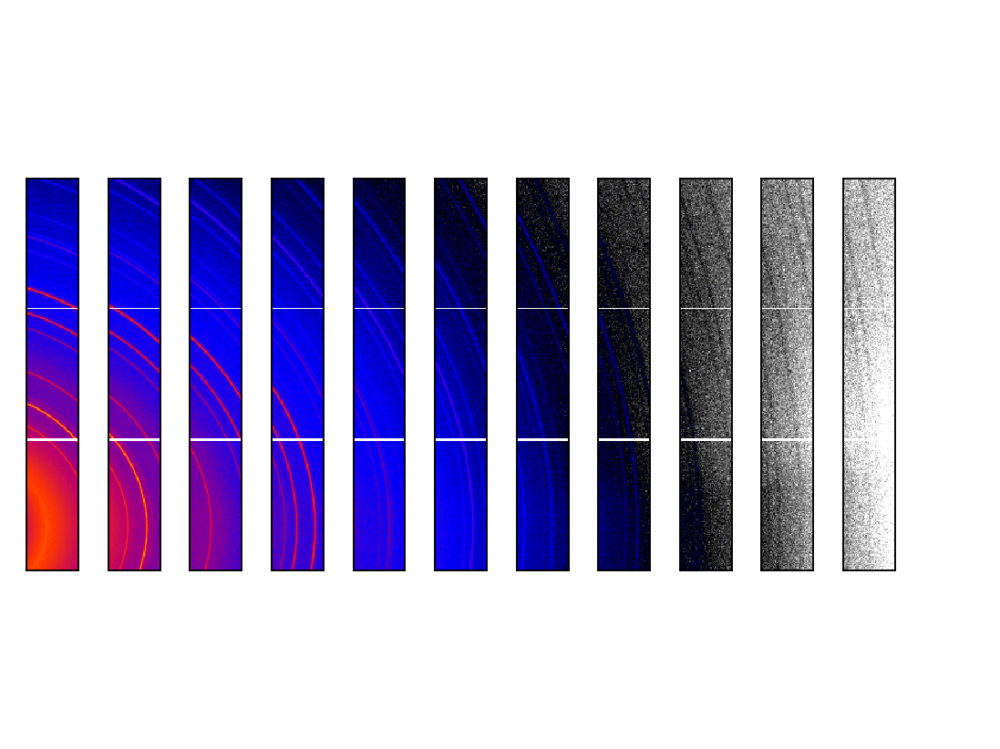

/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000001_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000002_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000003_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000004_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000005_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000006_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000007_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000008_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000009_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000010_WAXS.tif
/GPFS/xf12id1/data/300KW/images/users/302771a/T80t_x5.9_000011_WAXS.tif


In [30]:
fig = plt.figure()# figsize=[2,8]) 
for i in range(Ns, Ns + Ni ):
    #print(i)
    ax = fig.add_subplot(1, Ni+1, i+1 - Ns)
    #d = process.load(  infiles[i]  )    
    d = np.array(  PIL.Image.open(infiles[i]).convert('I') )
    print( infiles[i] )
    #vmin=  max(1, d.mean() - d.std()*sca), vmax= d.mean() + d.std()*sca,
    sca= 1
    show_img( (d).T, logs = True, show_colorbar= False,show_ticks =False,
             ax= [fig, ax], cmap = cmap_vge_hdr, 
             vmin= vmin, vmax= vmax, image_name='',              
            aspect=1, save=False, path=ResDir0)
#fig.savefig(ResDir + k+'raw_image_%s-%s.png'%(Ns, Ns+Ni))

# Stitching Snake Patterns

In [73]:
sam = 'T80t_x5.9_'

Results from this analysis will be stashed in the directory /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/
Stitching Pos: ...2
------> files to be stitched are: 
['T80t_x5.9_000022_WAXS.tif' 'T80t_x5.9_000021_WAXS.tif'
 'T80t_x5.9_000020_WAXS.tif' 'T80t_x5.9_000019_WAXS.tif'
 'T80t_x5.9_000018_WAXS.tif' 'T80t_x5.9_000017_WAXS.tif'
 'T80t_x5.9_000016_WAXS.tif' 'T80t_x5.9_000015_WAXS.tif'
 'T80t_x5.9_000014_WAXS.tif' 'T80t_x5.9_000013_WAXS.tif'
 'T80t_x5.9_000012_WAXS.tif'].


<IPython.core.display.Javascript object>


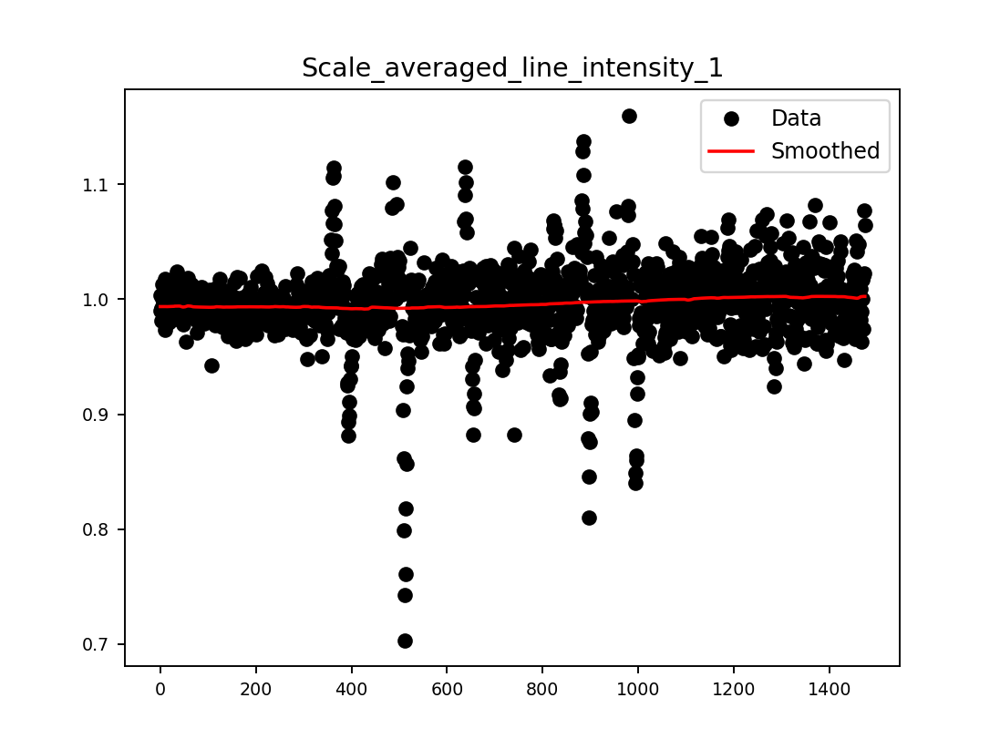

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=2.tif.


/home/yuzhang/pySMI/pySMI/Stitching.py:257: RuntimeWarning: invalid value encountered in true_divide
  Intensity_map = np.nan_to_num( Intensity_map/count_map )


<IPython.core.display.Javascript object>


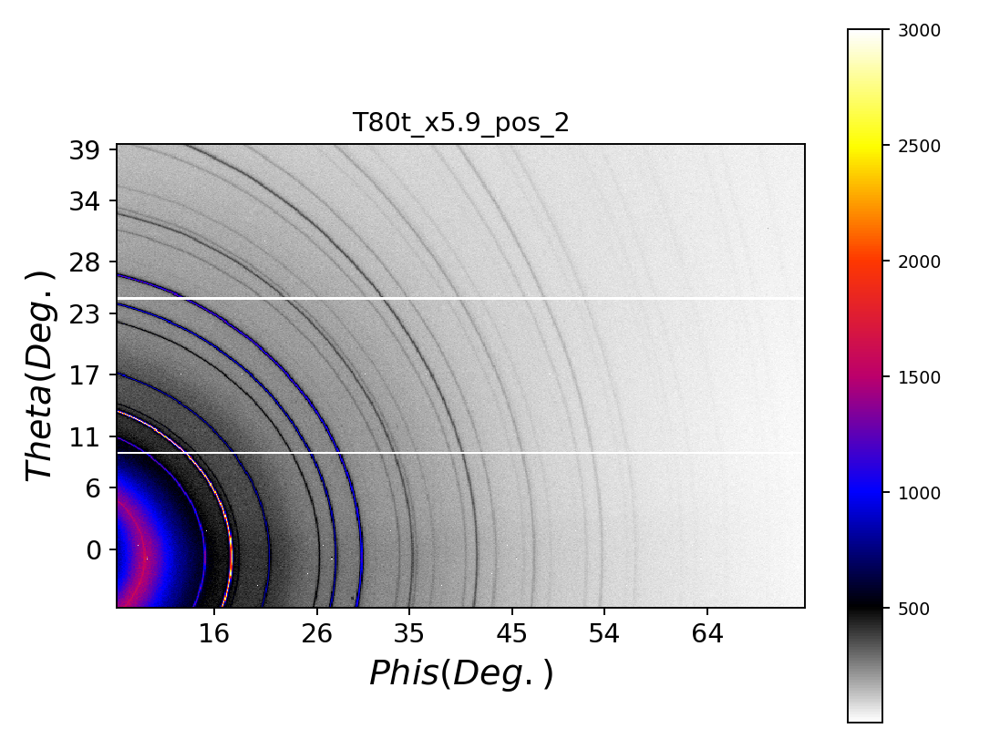

<IPython.core.display.Javascript object>


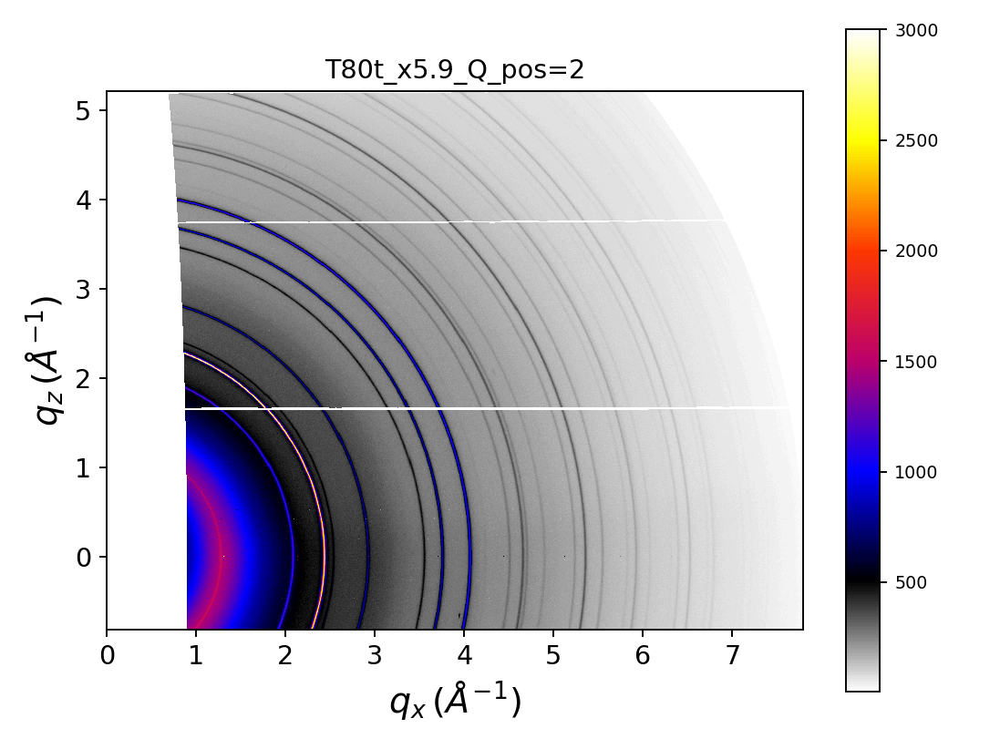

Stitching Pos: ...3
------> files to be stitched are: 
['T80t_x5.9_000023_WAXS.tif' 'T80t_x5.9_000024_WAXS.tif'
 'T80t_x5.9_000025_WAXS.tif' 'T80t_x5.9_000026_WAXS.tif'
 'T80t_x5.9_000027_WAXS.tif' 'T80t_x5.9_000028_WAXS.tif'
 'T80t_x5.9_000029_WAXS.tif' 'T80t_x5.9_000030_WAXS.tif'
 'T80t_x5.9_000031_WAXS.tif' 'T80t_x5.9_000032_WAXS.tif'
 'T80t_x5.9_000033_WAXS.tif'].


<IPython.core.display.Javascript object>


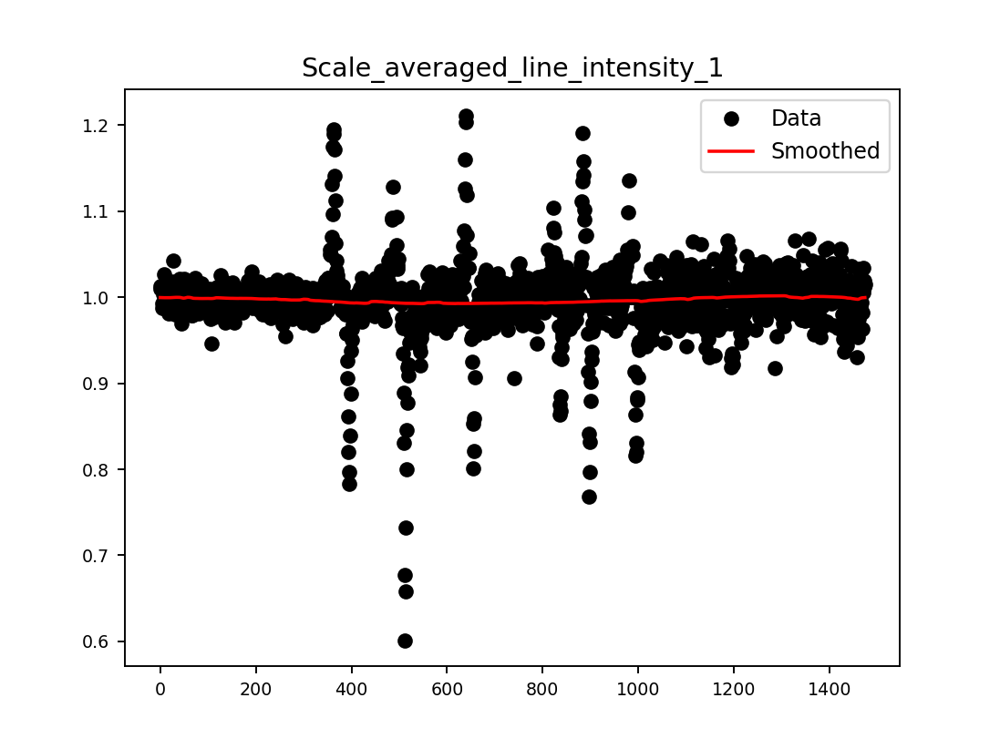

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=3.tif.


<IPython.core.display.Javascript object>


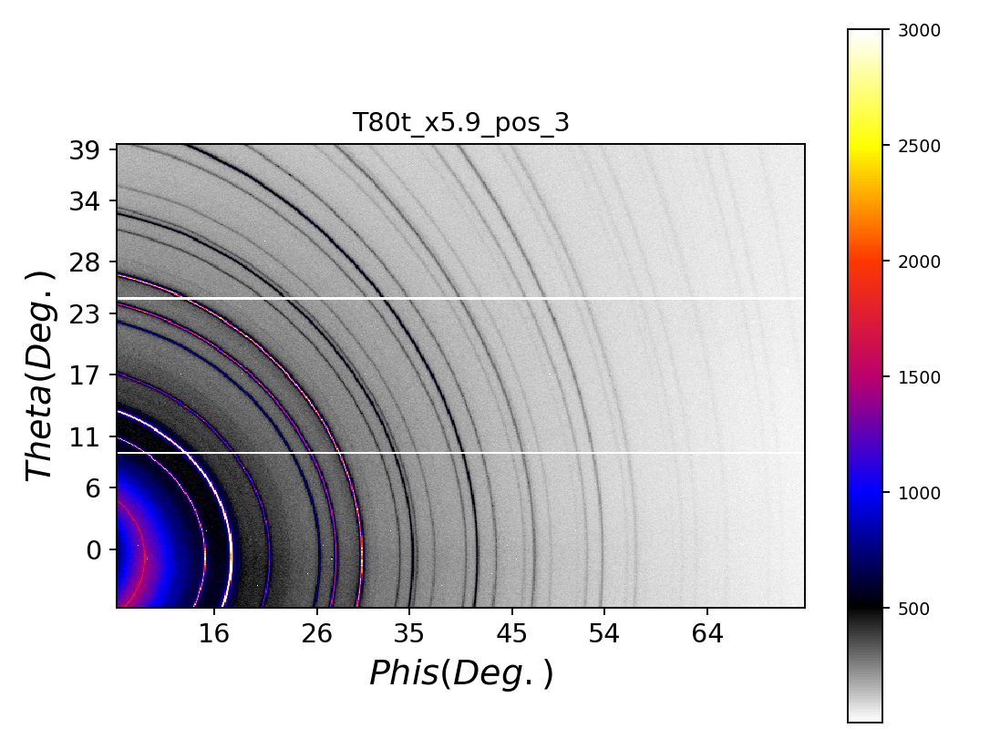

<IPython.core.display.Javascript object>


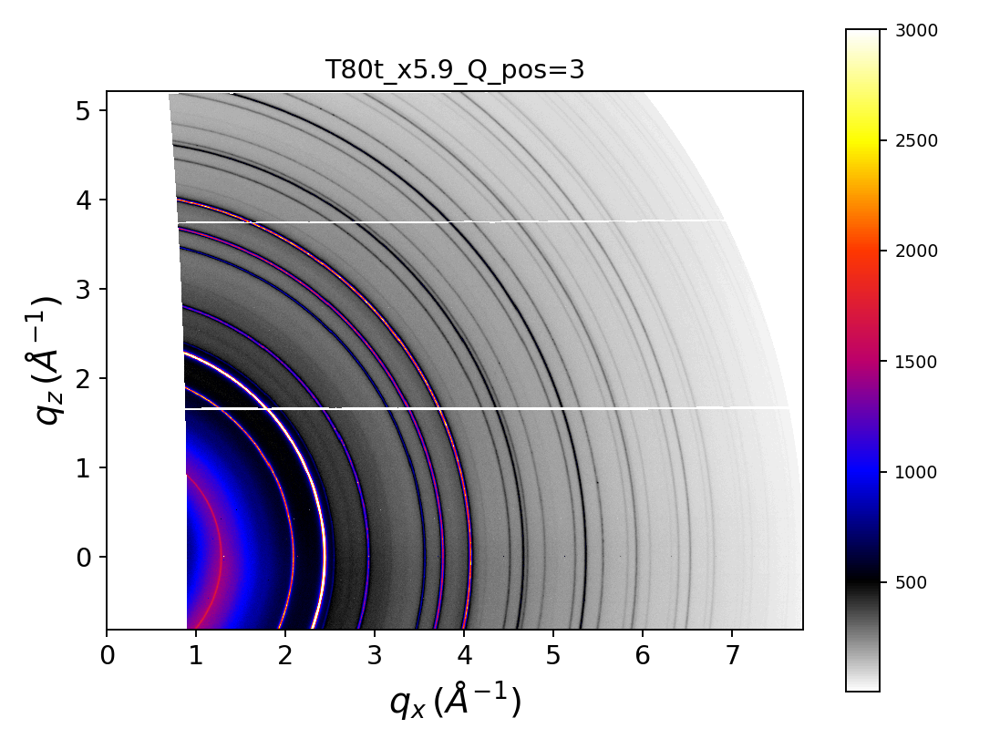

Stitching Pos: ...4
------> files to be stitched are: 
['T80t_x5.9_000044_WAXS.tif' 'T80t_x5.9_000043_WAXS.tif'
 'T80t_x5.9_000042_WAXS.tif' 'T80t_x5.9_000041_WAXS.tif'
 'T80t_x5.9_000040_WAXS.tif' 'T80t_x5.9_000039_WAXS.tif'
 'T80t_x5.9_000038_WAXS.tif' 'T80t_x5.9_000037_WAXS.tif'
 'T80t_x5.9_000036_WAXS.tif' 'T80t_x5.9_000035_WAXS.tif'
 'T80t_x5.9_000034_WAXS.tif'].


<IPython.core.display.Javascript object>


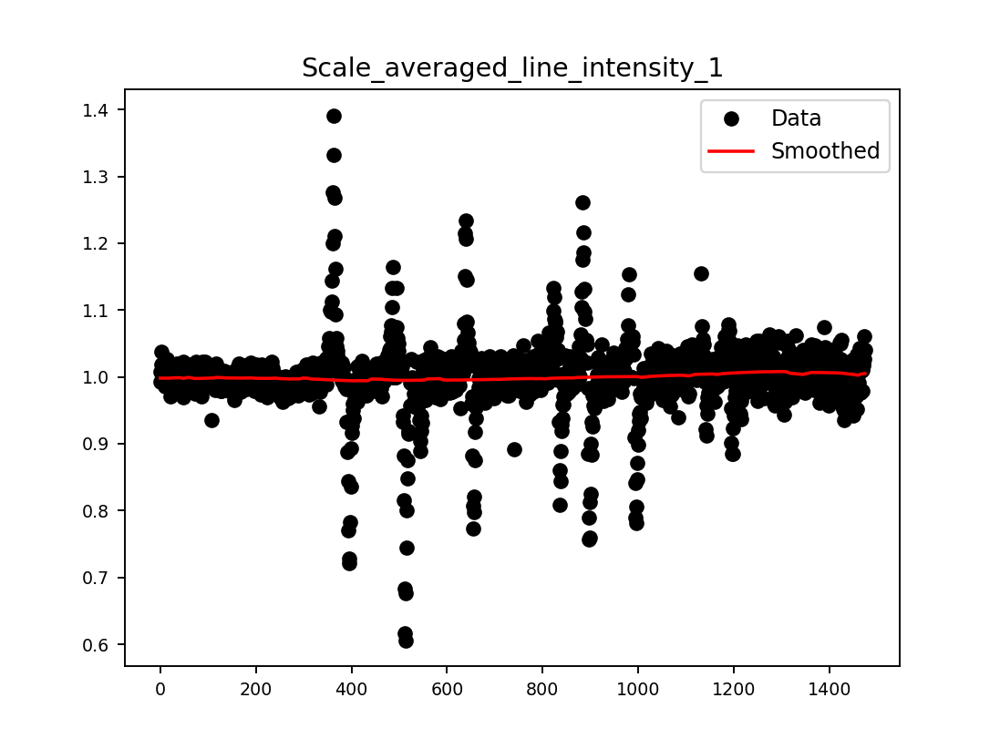

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=4.tif.


<IPython.core.display.Javascript object>


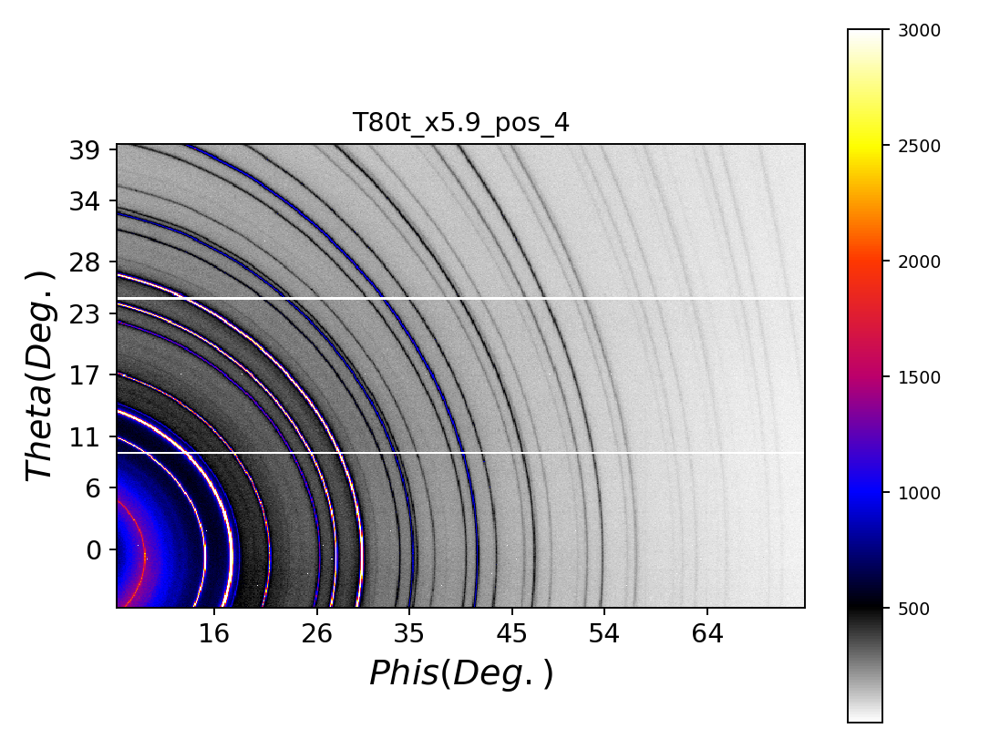

<IPython.core.display.Javascript object>


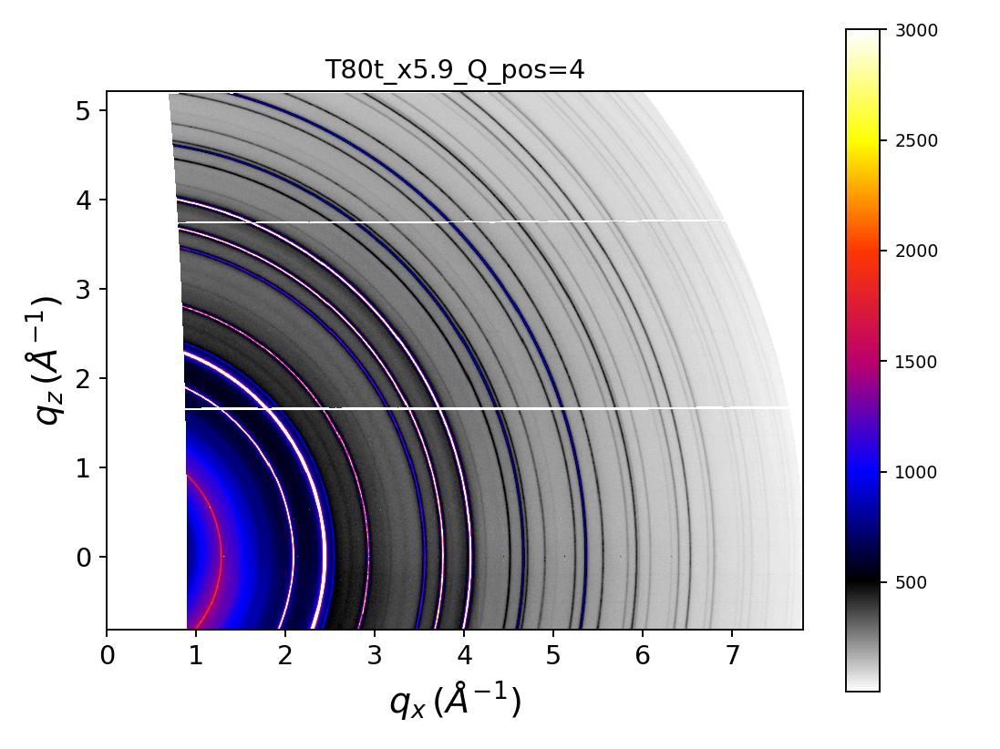

Stitching Pos: ...5
------> files to be stitched are: 
['T80t_x5.9_000045_WAXS.tif' 'T80t_x5.9_000046_WAXS.tif'
 'T80t_x5.9_000047_WAXS.tif' 'T80t_x5.9_000048_WAXS.tif'
 'T80t_x5.9_000049_WAXS.tif' 'T80t_x5.9_000050_WAXS.tif'
 'T80t_x5.9_000051_WAXS.tif' 'T80t_x5.9_000052_WAXS.tif'
 'T80t_x5.9_000053_WAXS.tif' 'T80t_x5.9_000054_WAXS.tif'
 'T80t_x5.9_000055_WAXS.tif'].


<IPython.core.display.Javascript object>


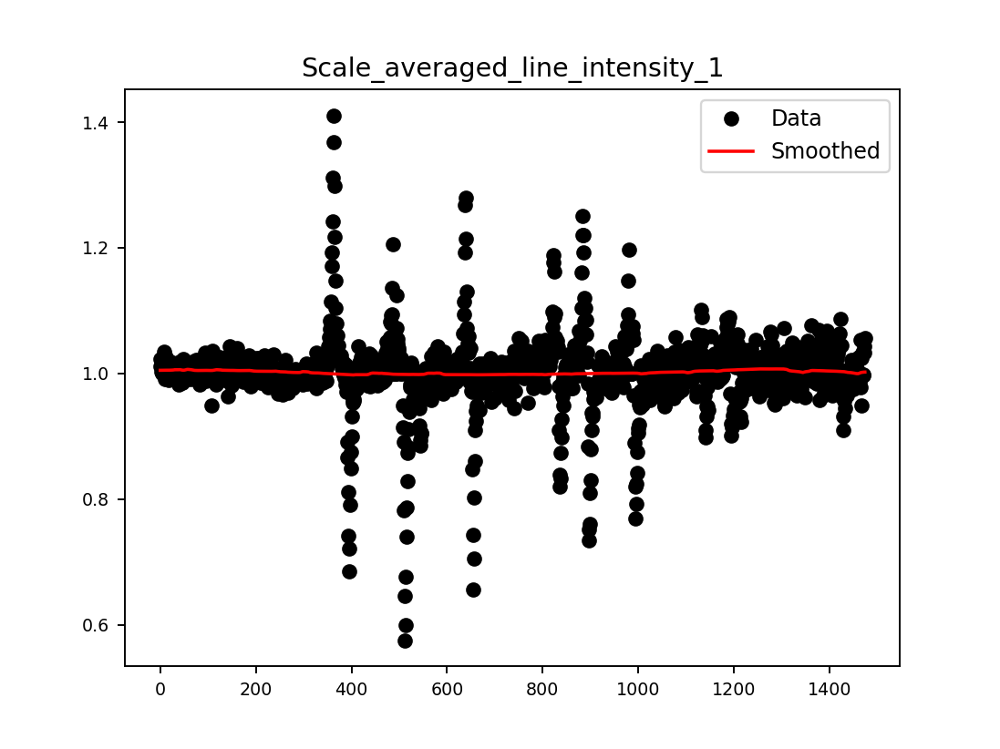

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=5.tif.


<IPython.core.display.Javascript object>


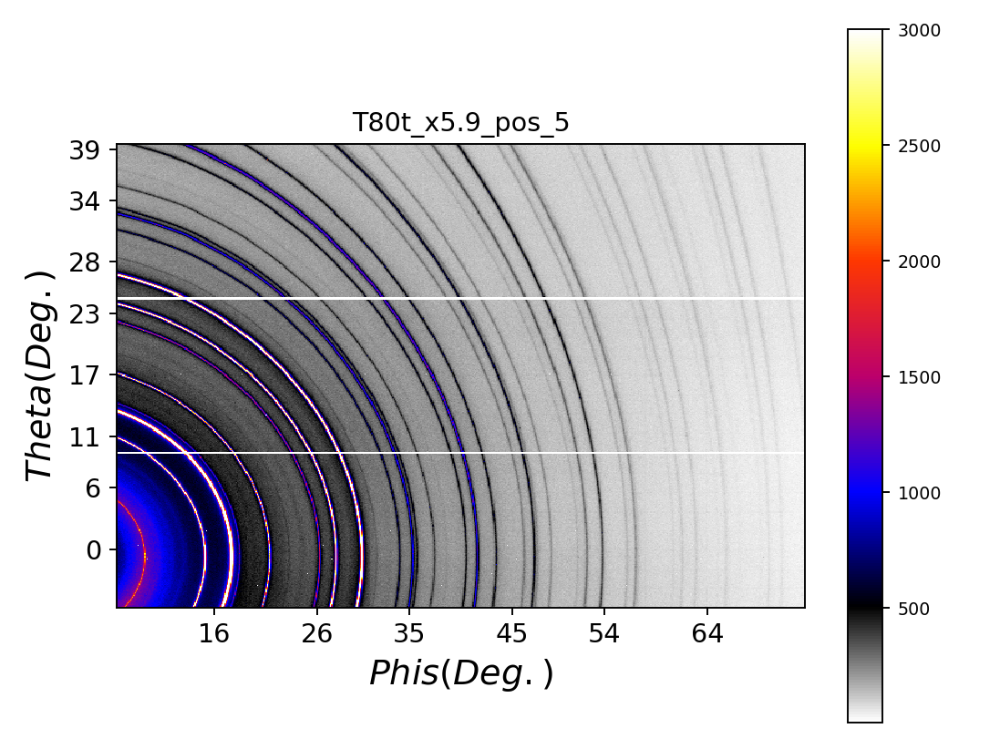

<IPython.core.display.Javascript object>


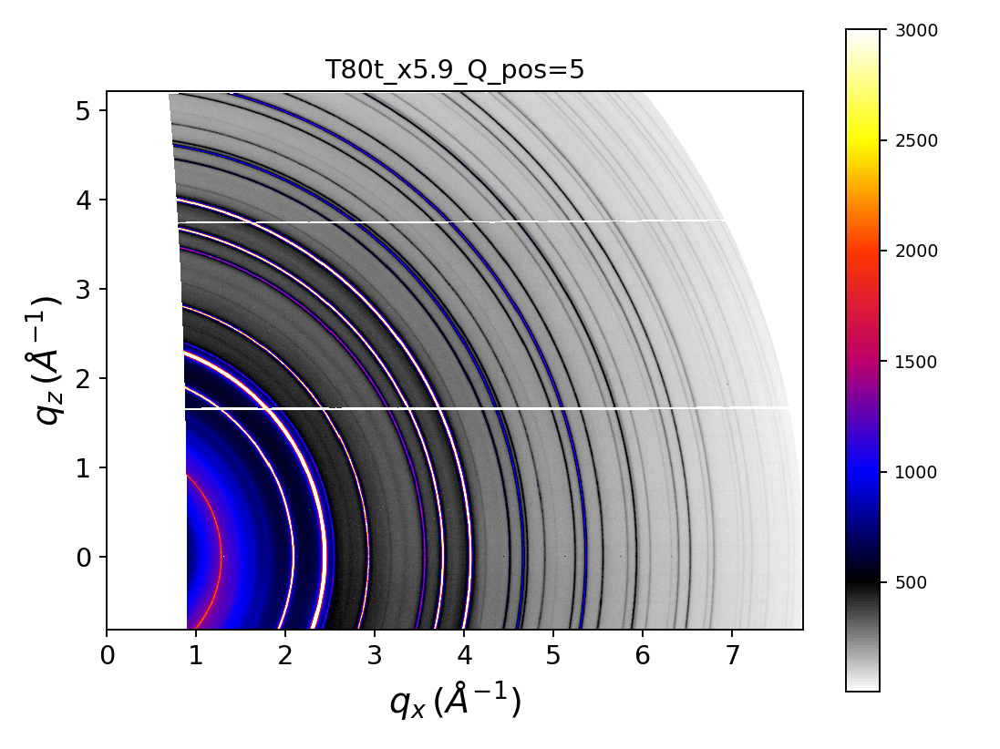

Stitching Pos: ...6
------> files to be stitched are: 
['T80t_x5.9_000066_WAXS.tif' 'T80t_x5.9_000065_WAXS.tif'
 'T80t_x5.9_000064_WAXS.tif' 'T80t_x5.9_000063_WAXS.tif'
 'T80t_x5.9_000062_WAXS.tif' 'T80t_x5.9_000061_WAXS.tif'
 'T80t_x5.9_000060_WAXS.tif' 'T80t_x5.9_000059_WAXS.tif'
 'T80t_x5.9_000058_WAXS.tif' 'T80t_x5.9_000057_WAXS.tif'
 'T80t_x5.9_000056_WAXS.tif'].


<IPython.core.display.Javascript object>


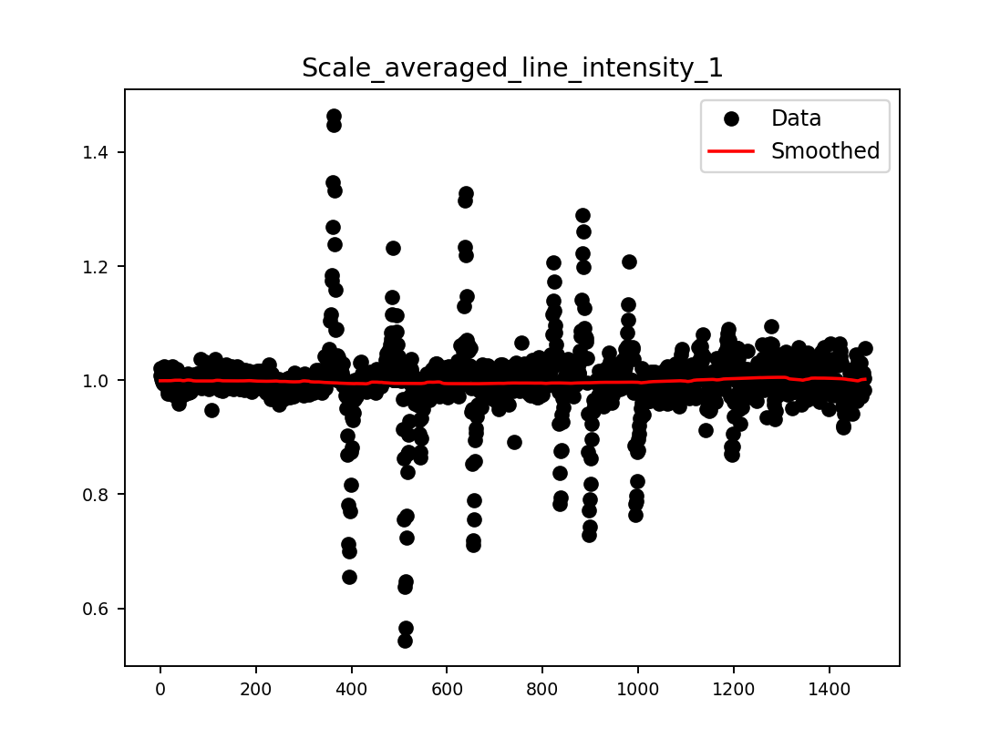

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=6.tif.


<IPython.core.display.Javascript object>


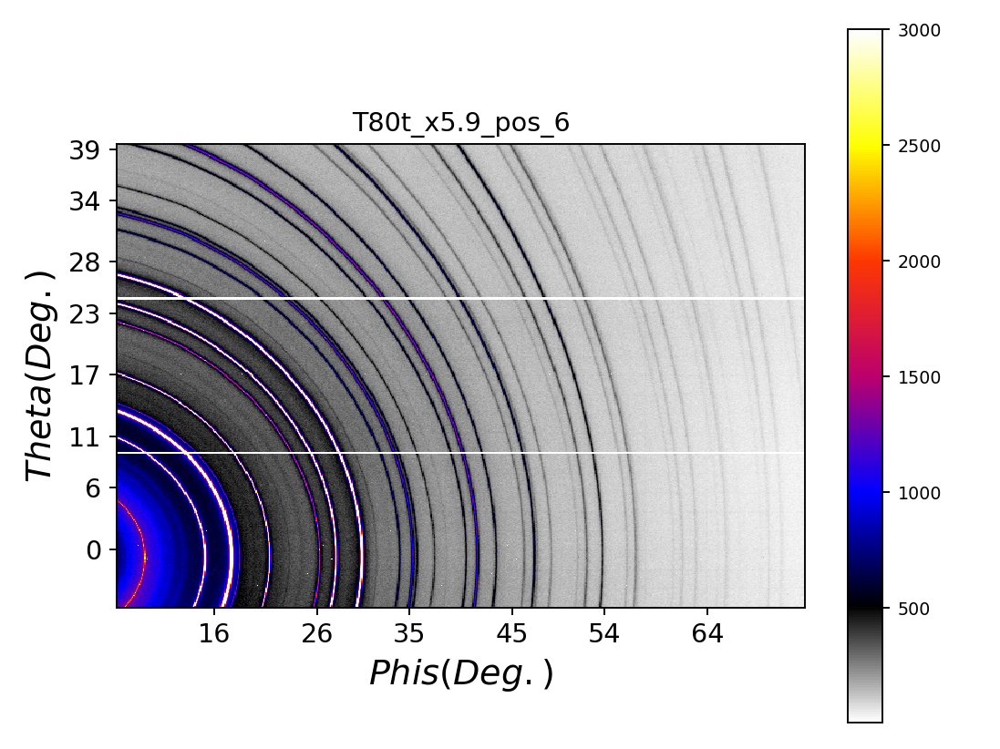

<IPython.core.display.Javascript object>


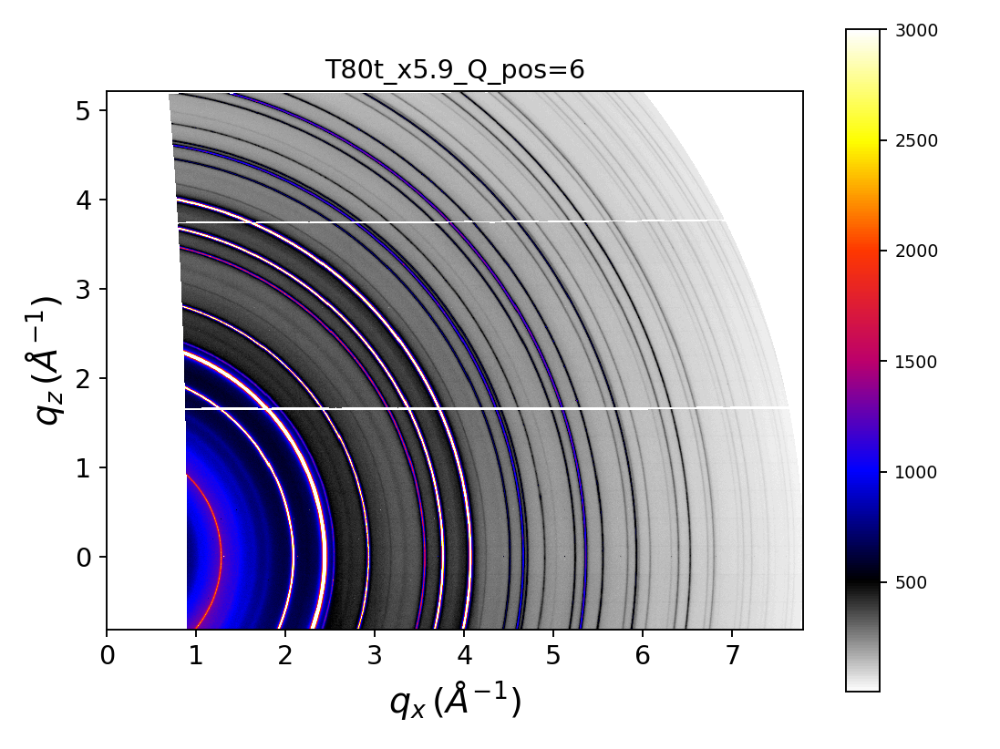

Stitching Pos: ...7
------> files to be stitched are: 
['T80t_x5.9_000067_WAXS.tif' 'T80t_x5.9_000068_WAXS.tif'
 'T80t_x5.9_000069_WAXS.tif' 'T80t_x5.9_000070_WAXS.tif'
 'T80t_x5.9_000071_WAXS.tif' 'T80t_x5.9_000072_WAXS.tif'
 'T80t_x5.9_000073_WAXS.tif' 'T80t_x5.9_000074_WAXS.tif'
 'T80t_x5.9_000075_WAXS.tif' 'T80t_x5.9_000076_WAXS.tif'
 'T80t_x5.9_000077_WAXS.tif'].


<IPython.core.display.Javascript object>


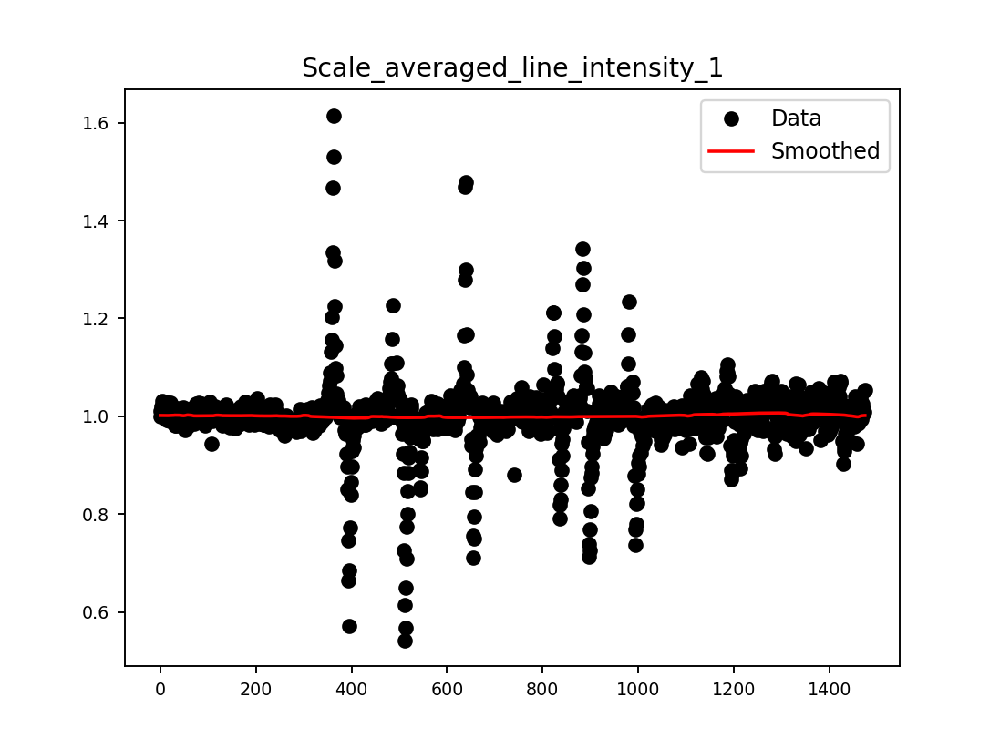

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=7.tif.


<IPython.core.display.Javascript object>


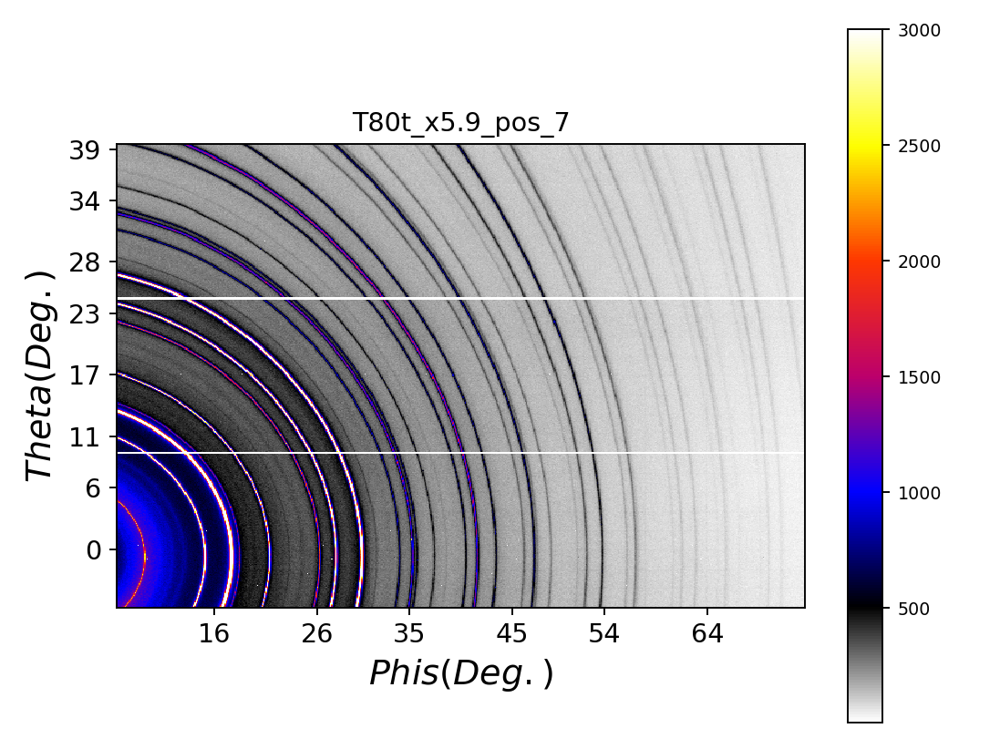

<IPython.core.display.Javascript object>


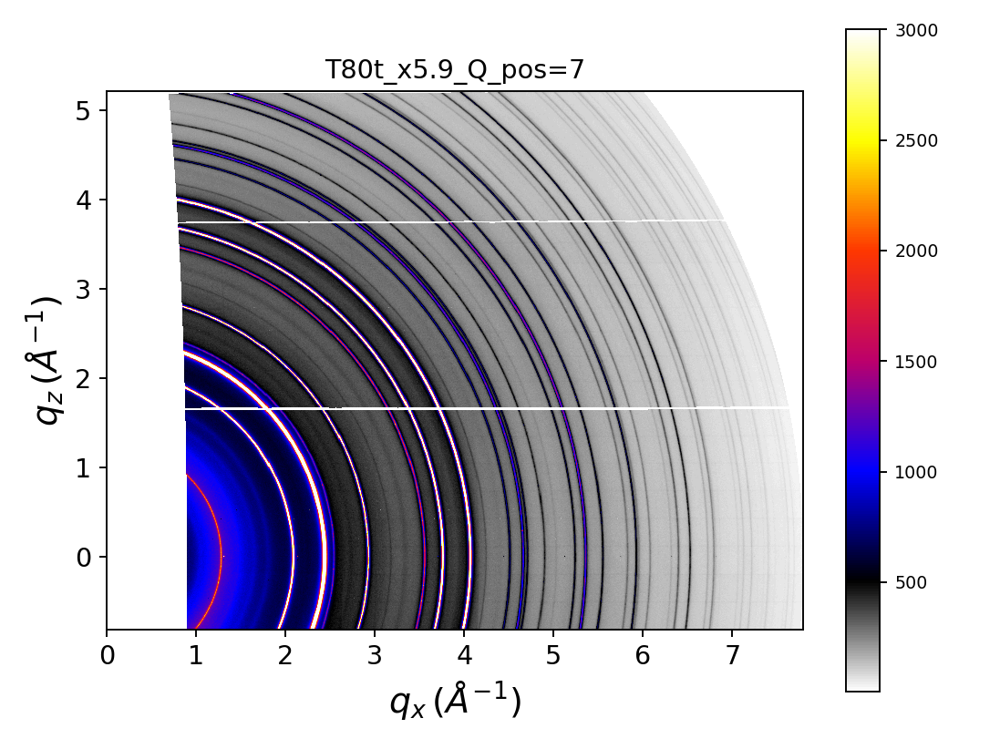

Stitching Pos: ...8
------> files to be stitched are: 
['T80t_x5.9_000088_WAXS.tif' 'T80t_x5.9_000087_WAXS.tif'
 'T80t_x5.9_000086_WAXS.tif' 'T80t_x5.9_000085_WAXS.tif'
 'T80t_x5.9_000084_WAXS.tif' 'T80t_x5.9_000083_WAXS.tif'
 'T80t_x5.9_000082_WAXS.tif' 'T80t_x5.9_000081_WAXS.tif'
 'T80t_x5.9_000080_WAXS.tif' 'T80t_x5.9_000079_WAXS.tif'
 'T80t_x5.9_000078_WAXS.tif'].


<IPython.core.display.Javascript object>


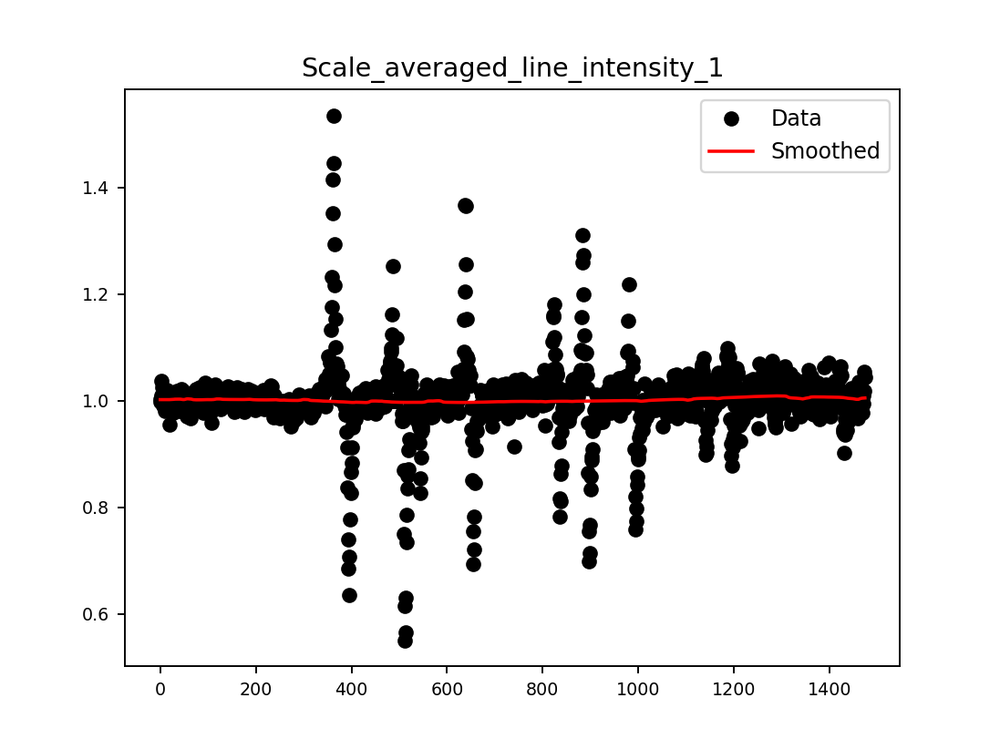

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=8.tif.


<IPython.core.display.Javascript object>


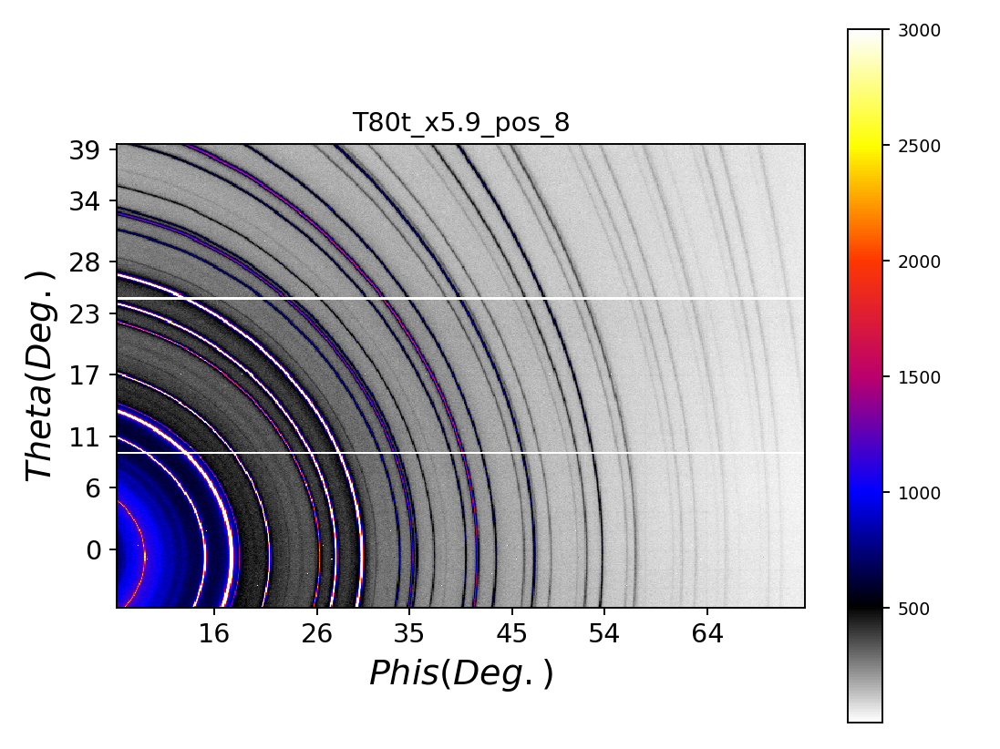

<IPython.core.display.Javascript object>


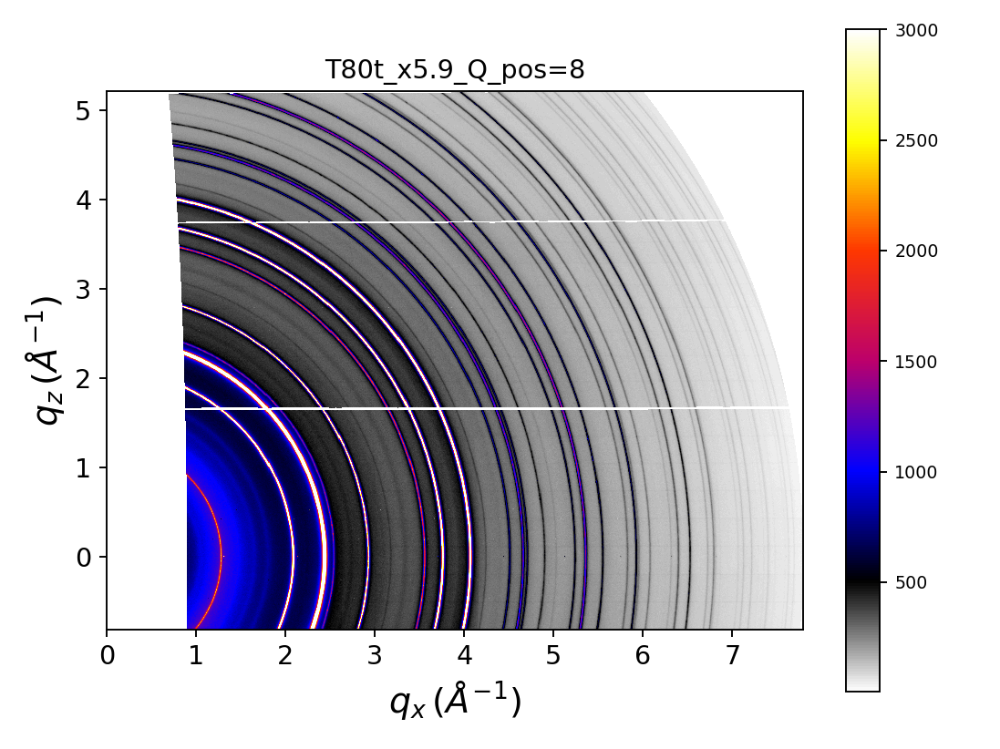

Stitching Pos: ...9
------> files to be stitched are: 
['T80t_x5.9_000089_WAXS.tif' 'T80t_x5.9_000090_WAXS.tif'
 'T80t_x5.9_000091_WAXS.tif' 'T80t_x5.9_000092_WAXS.tif'
 'T80t_x5.9_000093_WAXS.tif' 'T80t_x5.9_000094_WAXS.tif'
 'T80t_x5.9_000095_WAXS.tif' 'T80t_x5.9_000096_WAXS.tif'
 'T80t_x5.9_000097_WAXS.tif' 'T80t_x5.9_000098_WAXS.tif'
 'T80t_x5.9_000099_WAXS.tif'].


<IPython.core.display.Javascript object>


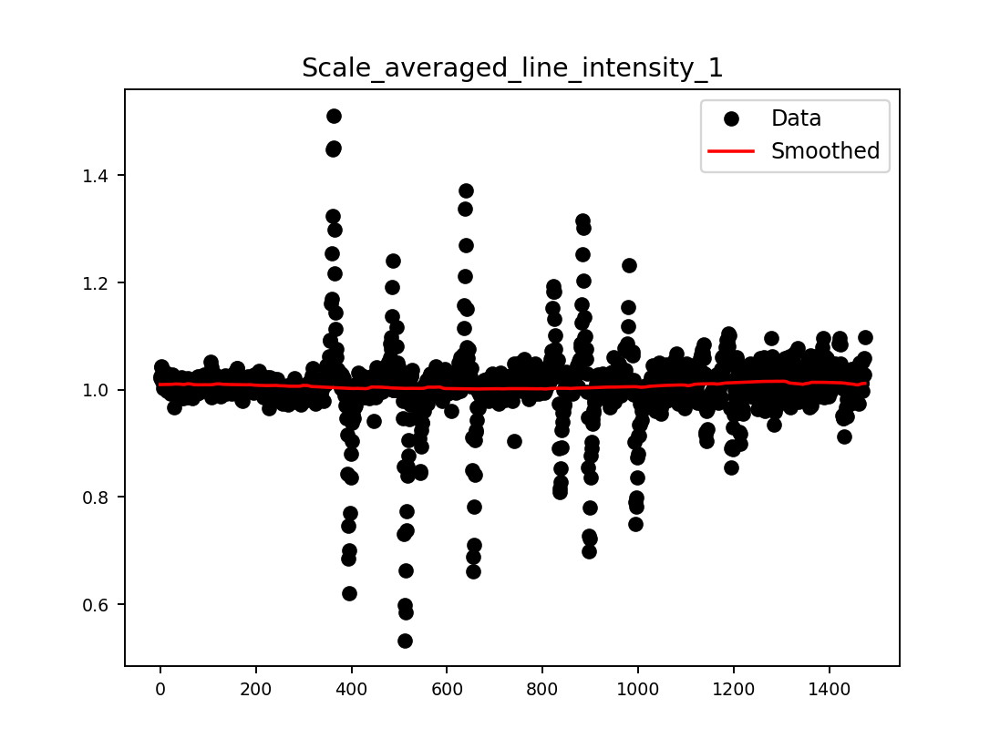

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=9.tif.


<IPython.core.display.Javascript object>


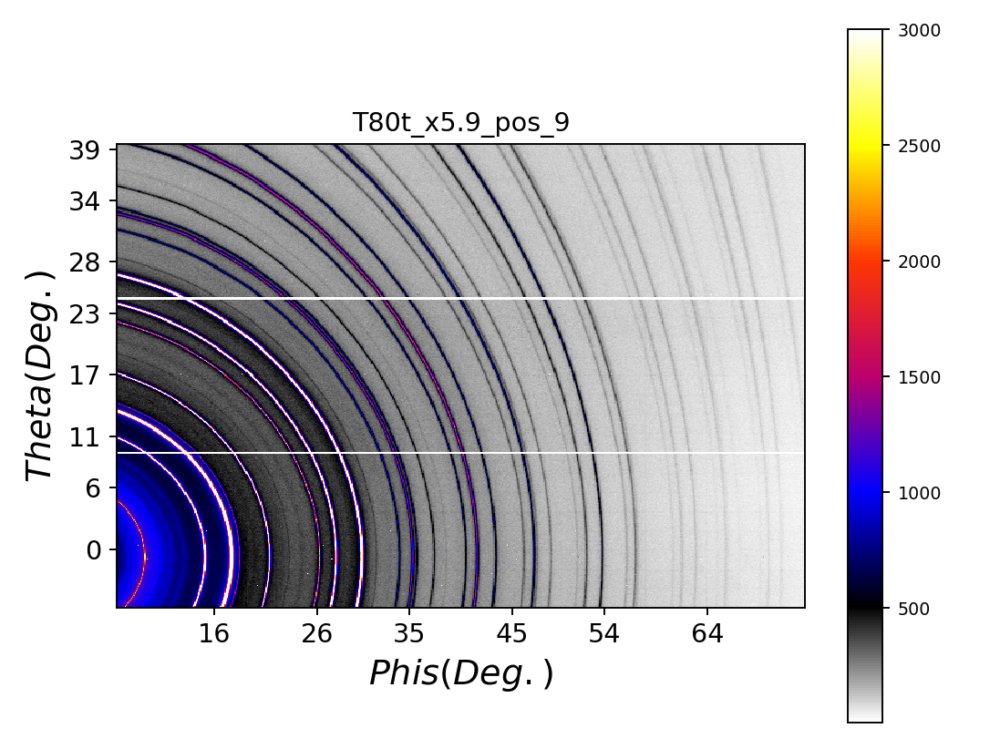

<IPython.core.display.Javascript object>


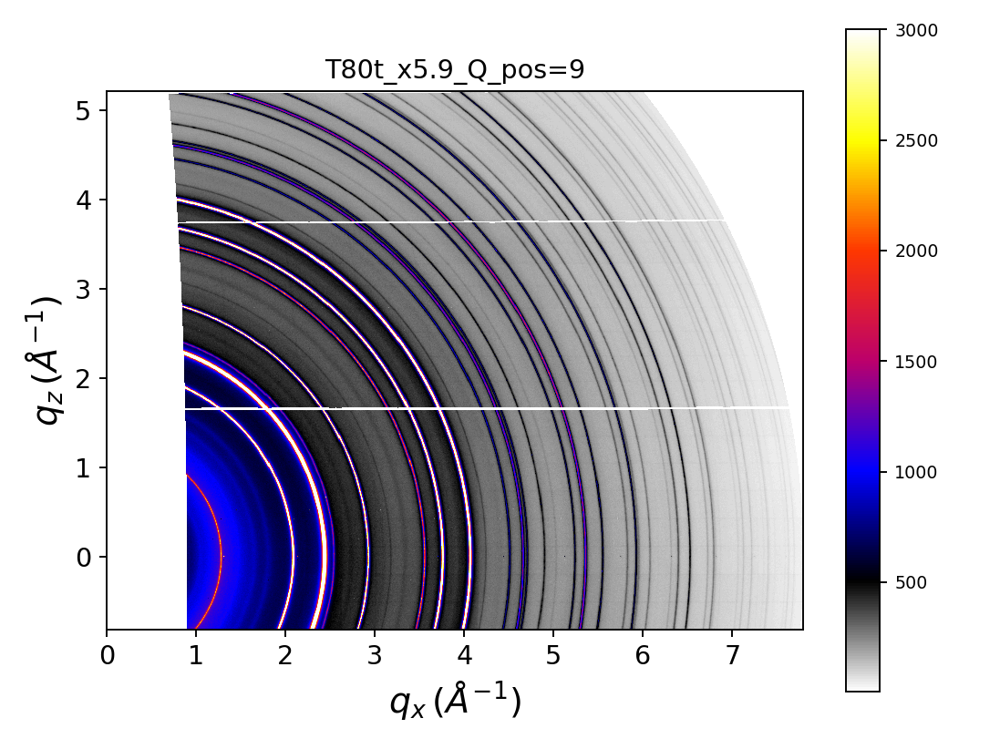

Stitching Pos: ...10
------> files to be stitched are: 
['T80t_x5.9_000110_WAXS.tif' 'T80t_x5.9_000109_WAXS.tif'
 'T80t_x5.9_000108_WAXS.tif' 'T80t_x5.9_000107_WAXS.tif'
 'T80t_x5.9_000106_WAXS.tif' 'T80t_x5.9_000105_WAXS.tif'
 'T80t_x5.9_000104_WAXS.tif' 'T80t_x5.9_000103_WAXS.tif'
 'T80t_x5.9_000102_WAXS.tif' 'T80t_x5.9_000101_WAXS.tif'
 'T80t_x5.9_000100_WAXS.tif'].


<IPython.core.display.Javascript object>


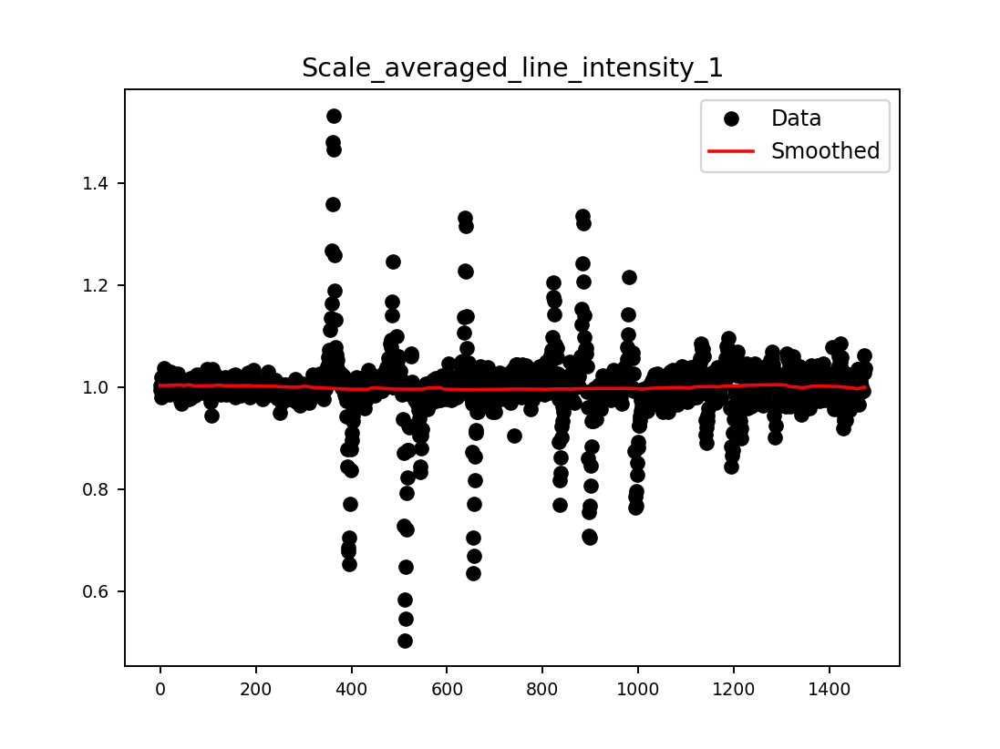

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=10.tif.


<IPython.core.display.Javascript object>


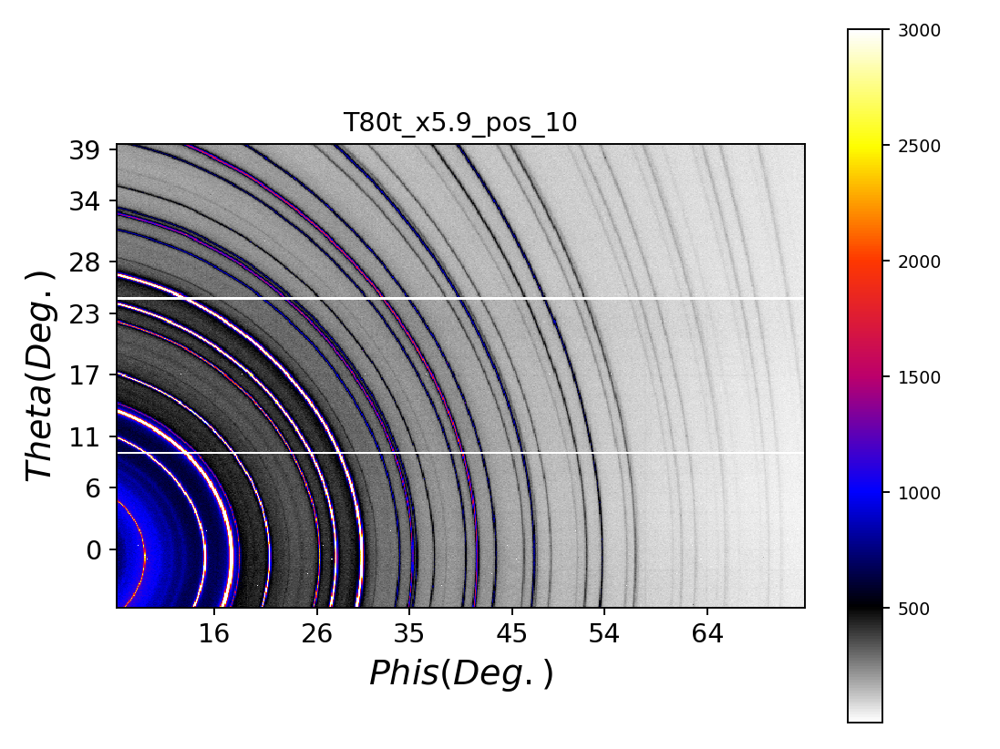

<IPython.core.display.Javascript object>


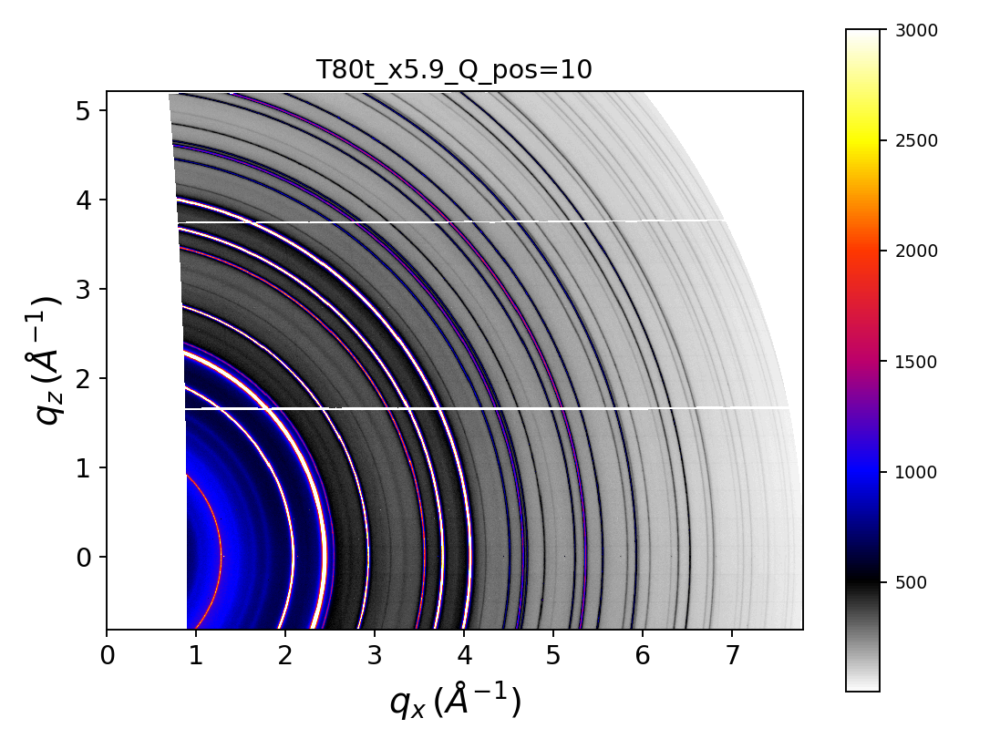

Stitching Pos: ...11
------> files to be stitched are: 
['T80t_x5.9_000111_WAXS.tif' 'T80t_x5.9_000112_WAXS.tif'
 'T80t_x5.9_000113_WAXS.tif' 'T80t_x5.9_000114_WAXS.tif'
 'T80t_x5.9_000115_WAXS.tif' 'T80t_x5.9_000116_WAXS.tif'
 'T80t_x5.9_000117_WAXS.tif' 'T80t_x5.9_000118_WAXS.tif'
 'T80t_x5.9_000119_WAXS.tif' 'T80t_x5.9_000120_WAXS.tif'
 'T80t_x5.9_000121_WAXS.tif'].


<IPython.core.display.Javascript object>


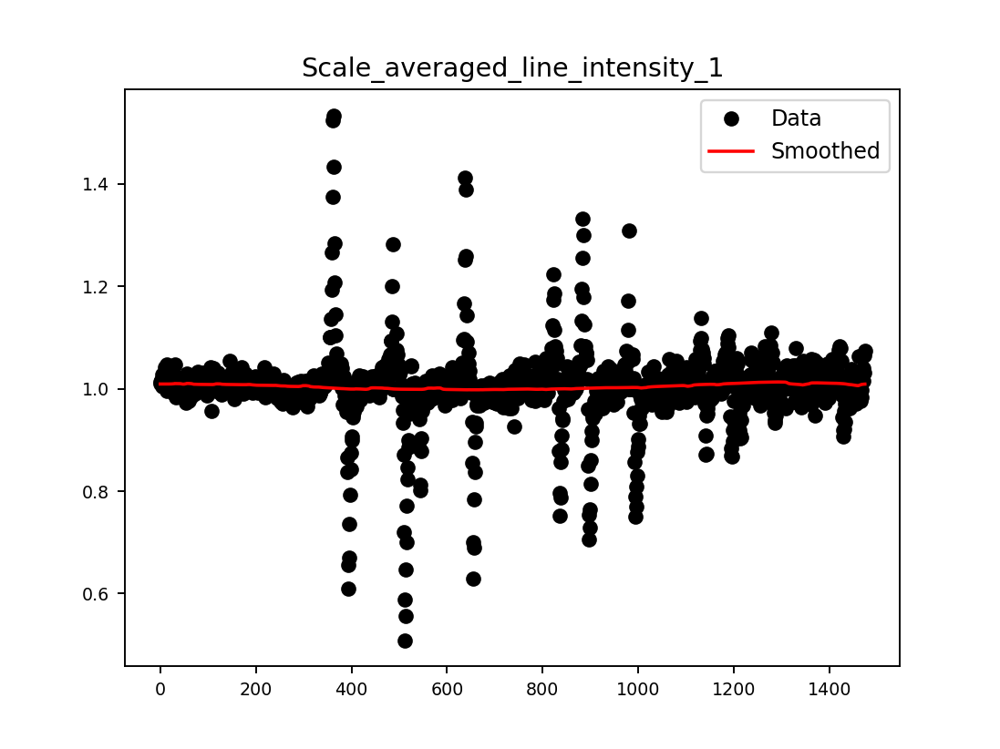

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=11.tif.


<IPython.core.display.Javascript object>


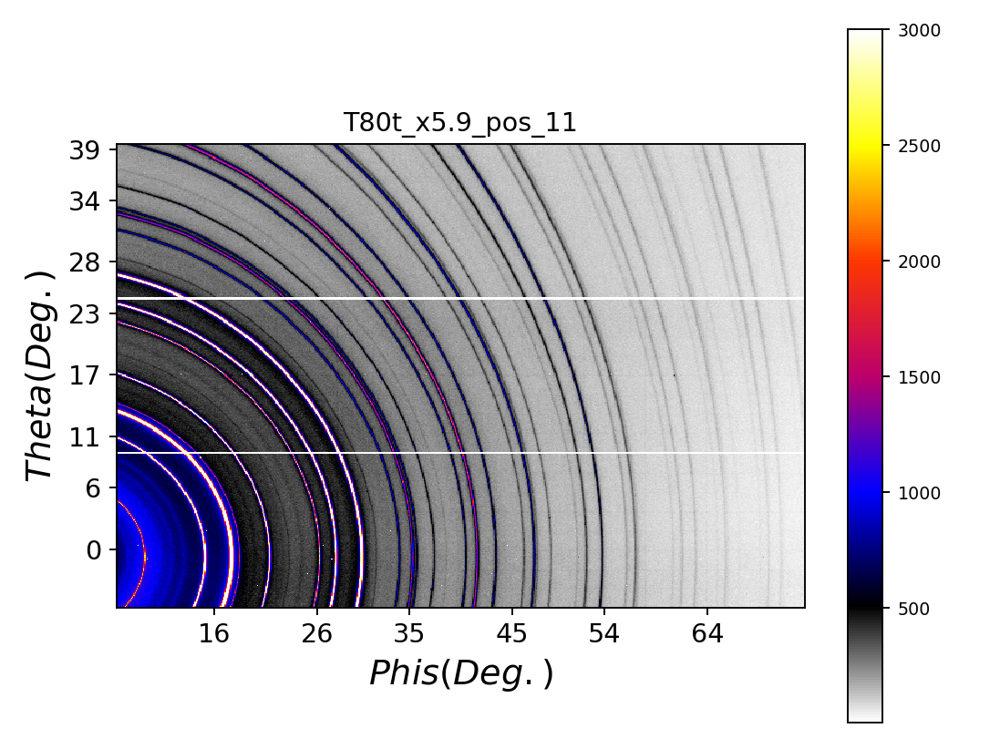

<IPython.core.display.Javascript object>


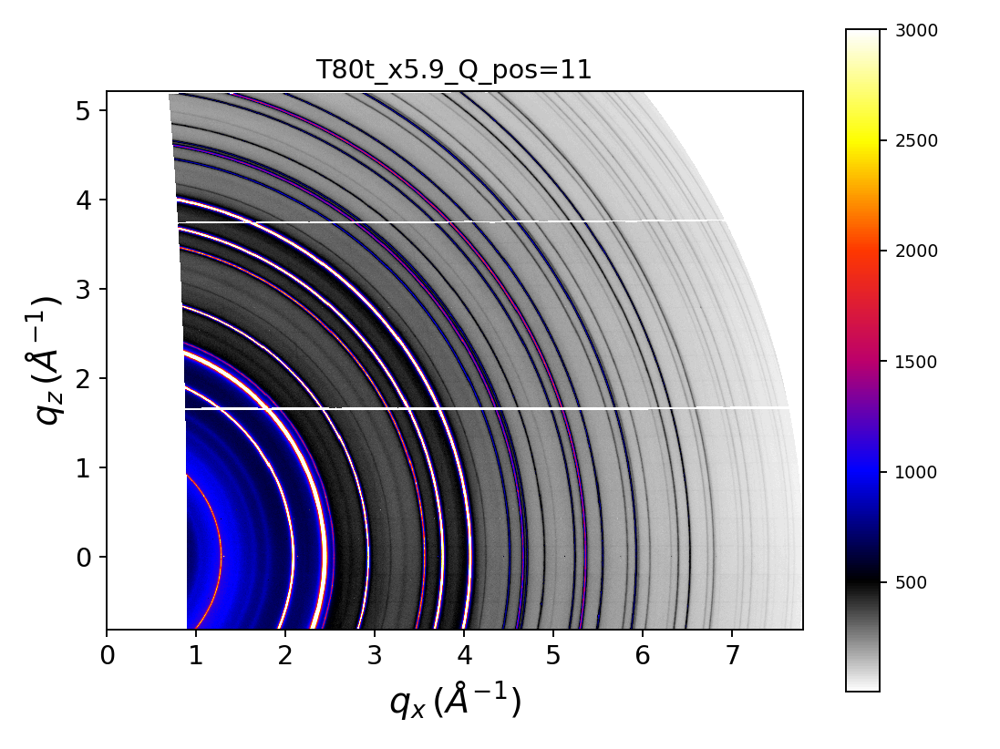

Stitching Pos: ...12
------> files to be stitched are: 
['T80t_x5.9_000132_WAXS.tif' 'T80t_x5.9_000131_WAXS.tif'
 'T80t_x5.9_000130_WAXS.tif' 'T80t_x5.9_000129_WAXS.tif'
 'T80t_x5.9_000128_WAXS.tif' 'T80t_x5.9_000127_WAXS.tif'
 'T80t_x5.9_000126_WAXS.tif' 'T80t_x5.9_000125_WAXS.tif'
 'T80t_x5.9_000124_WAXS.tif' 'T80t_x5.9_000123_WAXS.tif'
 'T80t_x5.9_000122_WAXS.tif'].


<IPython.core.display.Javascript object>


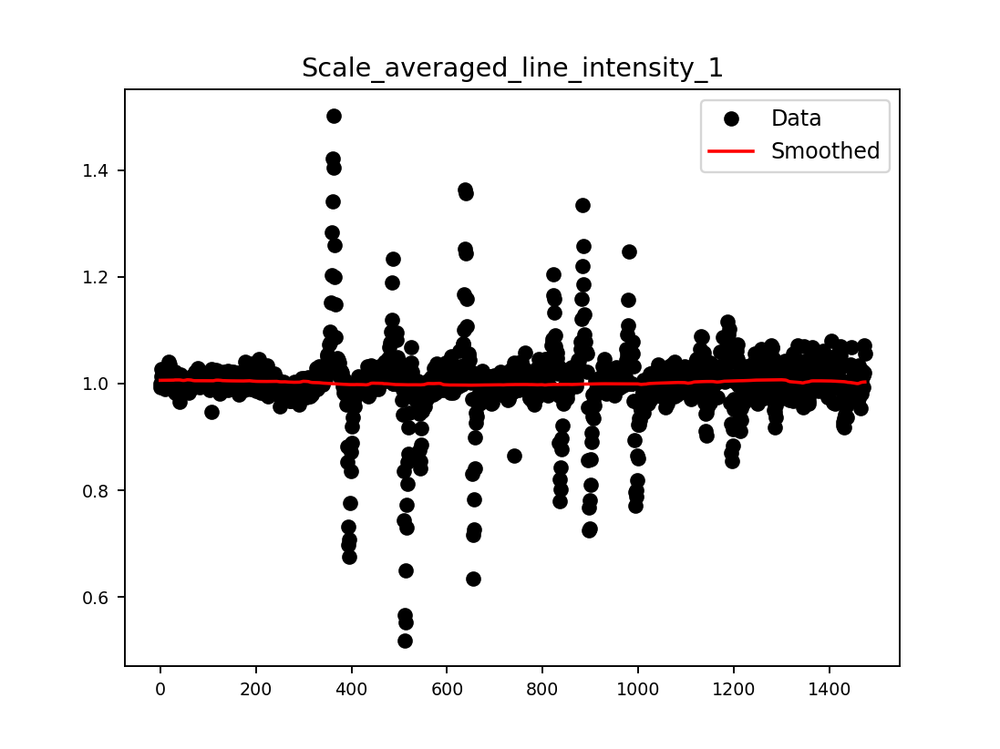

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=12.tif.


<IPython.core.display.Javascript object>


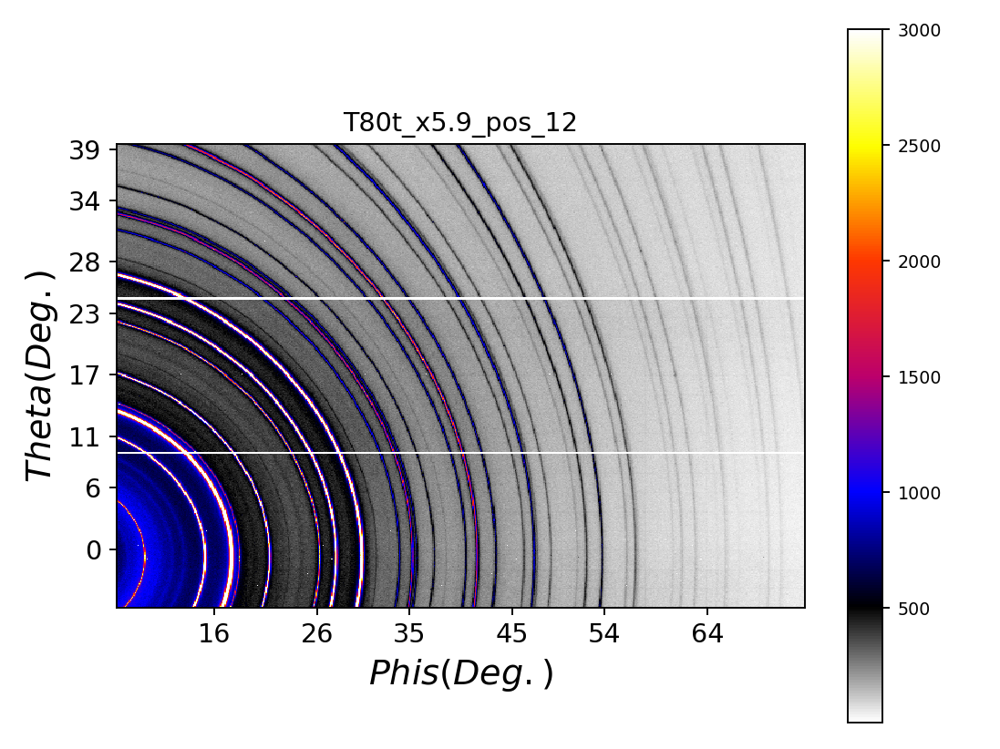

<IPython.core.display.Javascript object>


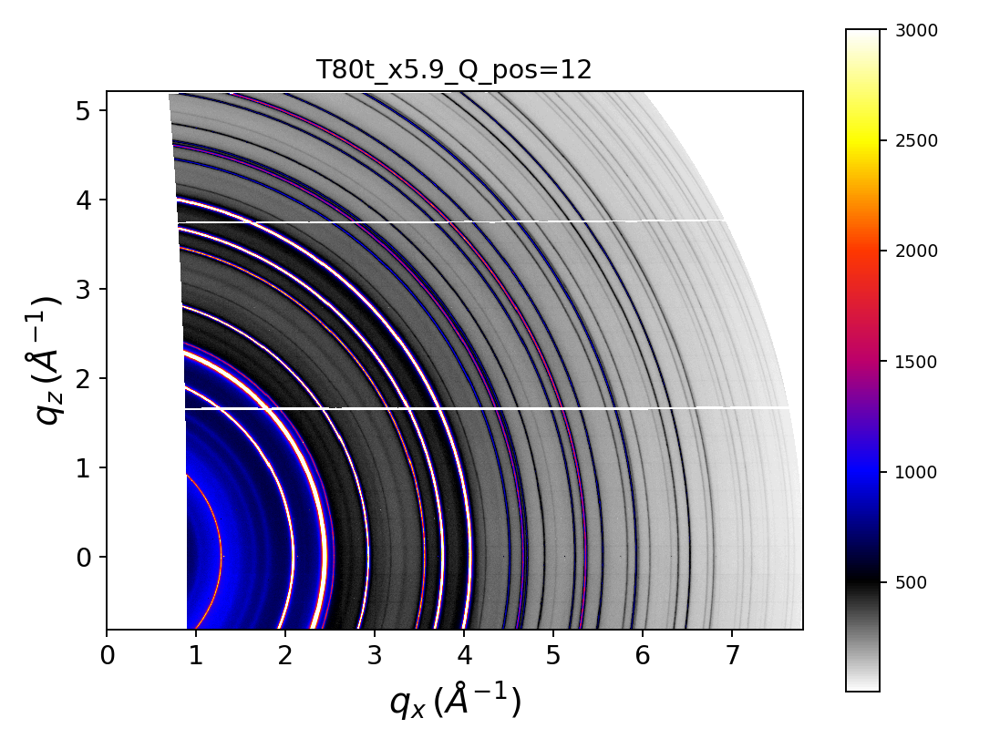

Stitching Pos: ...13
------> files to be stitched are: 
['T80t_x5.9_000133_WAXS.tif' 'T80t_x5.9_000134_WAXS.tif'
 'T80t_x5.9_000135_WAXS.tif' 'T80t_x5.9_000136_WAXS.tif'
 'T80t_x5.9_000137_WAXS.tif' 'T80t_x5.9_000138_WAXS.tif'
 'T80t_x5.9_000139_WAXS.tif' 'T80t_x5.9_000140_WAXS.tif'
 'T80t_x5.9_000141_WAXS.tif' 'T80t_x5.9_000142_WAXS.tif'
 'T80t_x5.9_000143_WAXS.tif'].


<IPython.core.display.Javascript object>


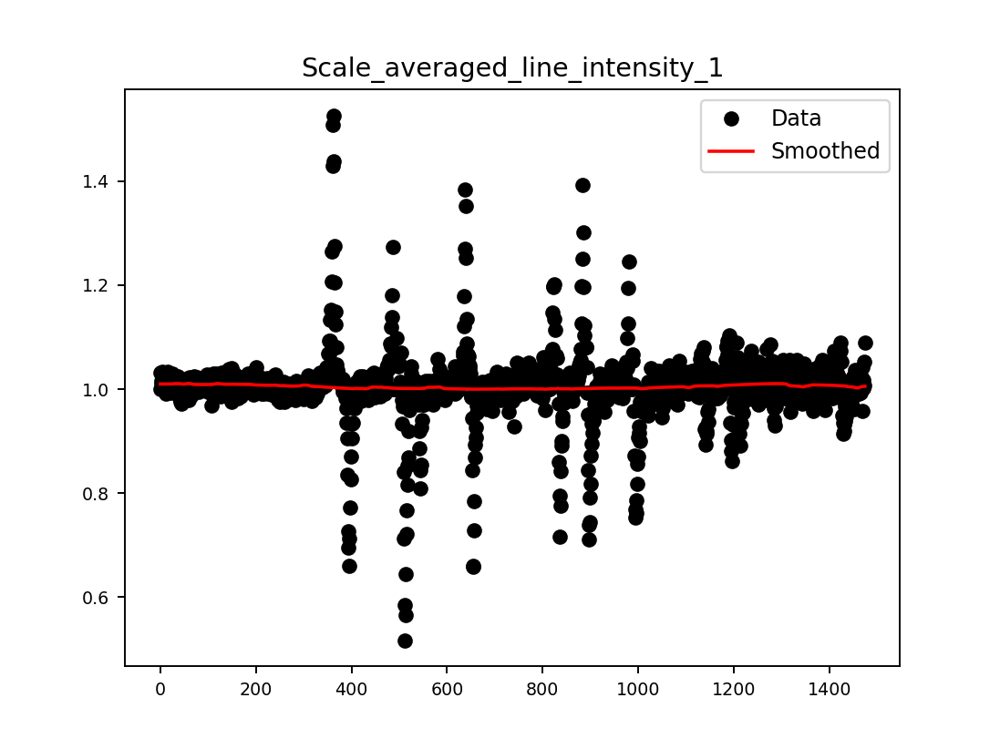

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=13.tif.


<IPython.core.display.Javascript object>


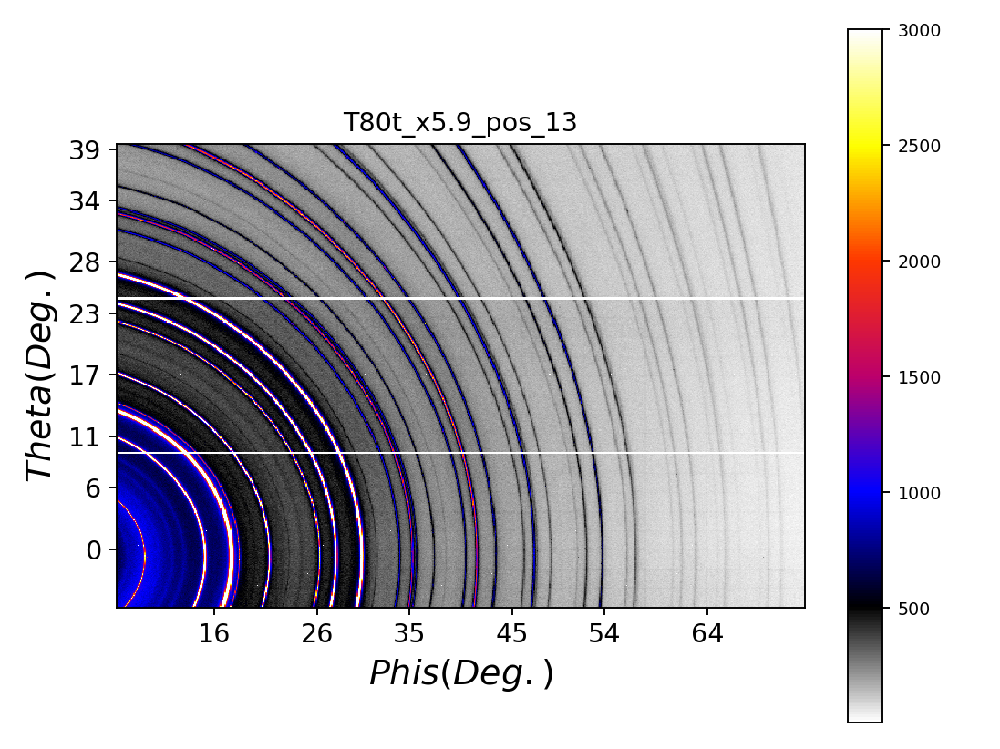

<IPython.core.display.Javascript object>


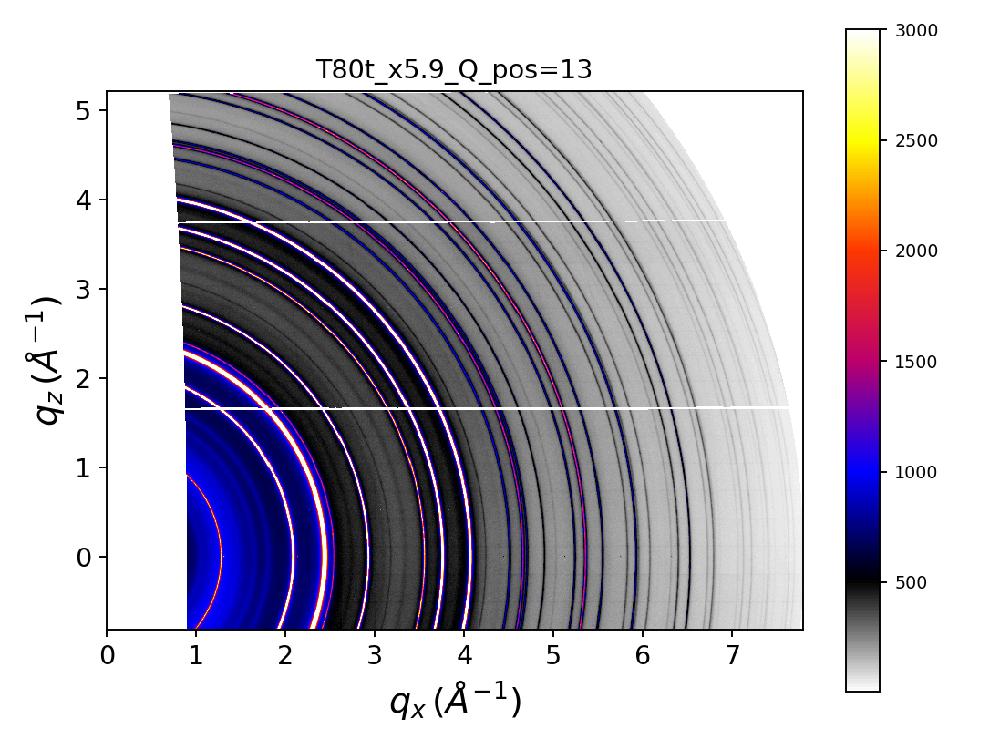

Stitching Pos: ...14
------> files to be stitched are: 
['T80t_x5.9_000154_WAXS.tif' 'T80t_x5.9_000153_WAXS.tif'
 'T80t_x5.9_000152_WAXS.tif' 'T80t_x5.9_000151_WAXS.tif'
 'T80t_x5.9_000150_WAXS.tif' 'T80t_x5.9_000149_WAXS.tif'
 'T80t_x5.9_000148_WAXS.tif' 'T80t_x5.9_000147_WAXS.tif'
 'T80t_x5.9_000146_WAXS.tif' 'T80t_x5.9_000145_WAXS.tif'
 'T80t_x5.9_000144_WAXS.tif'].


<IPython.core.display.Javascript object>


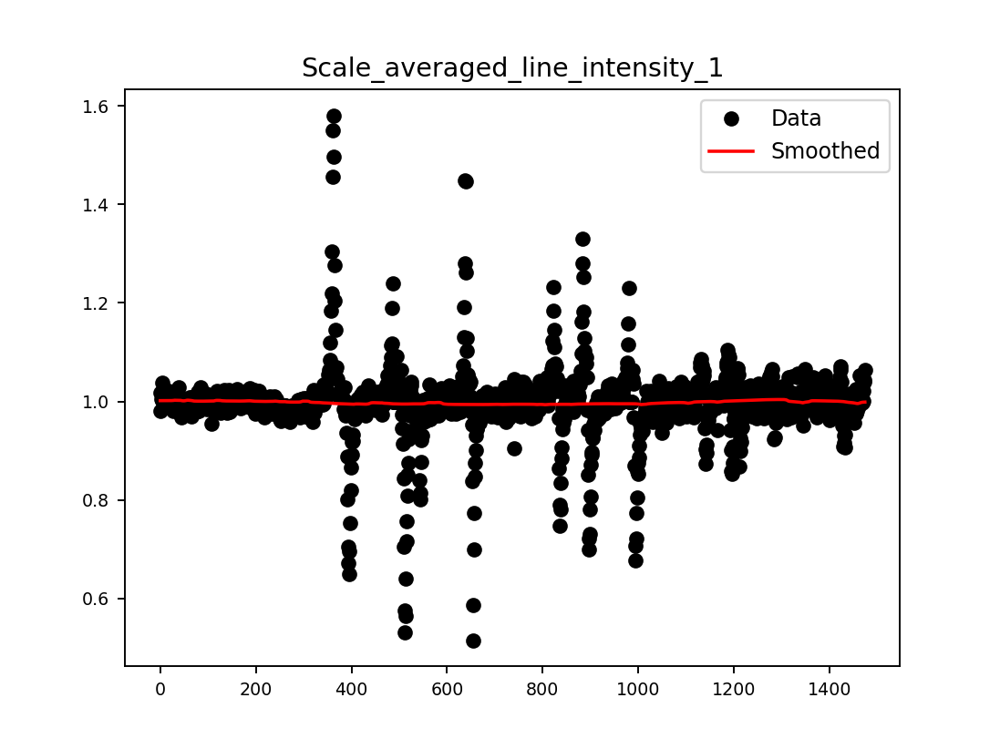

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=14.tif.


<IPython.core.display.Javascript object>


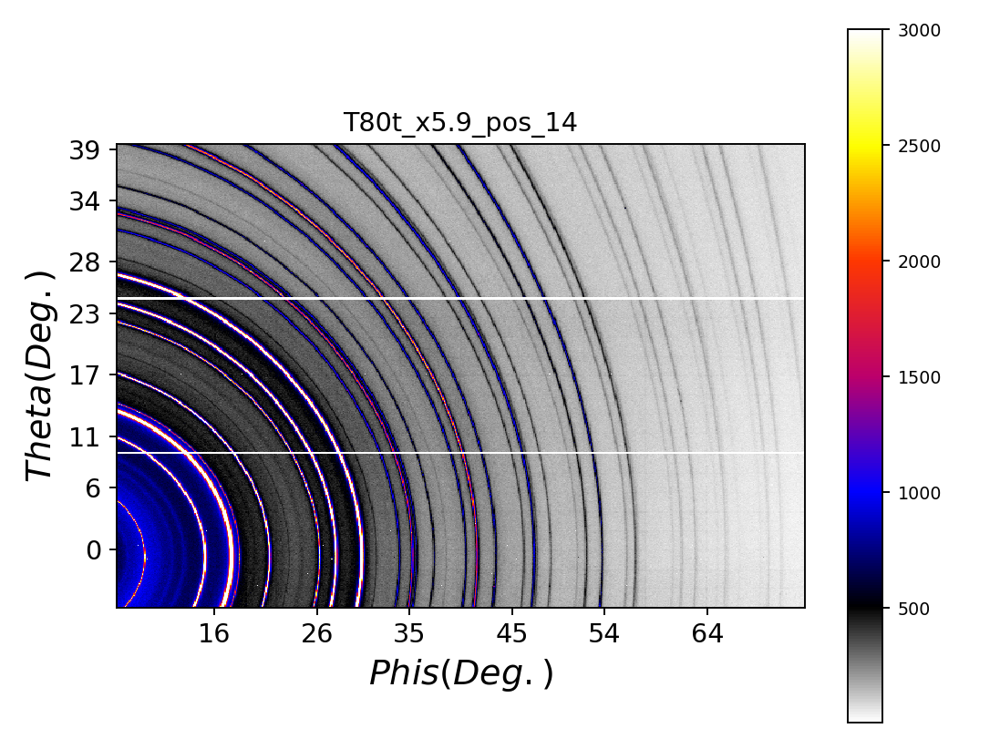

<IPython.core.display.Javascript object>


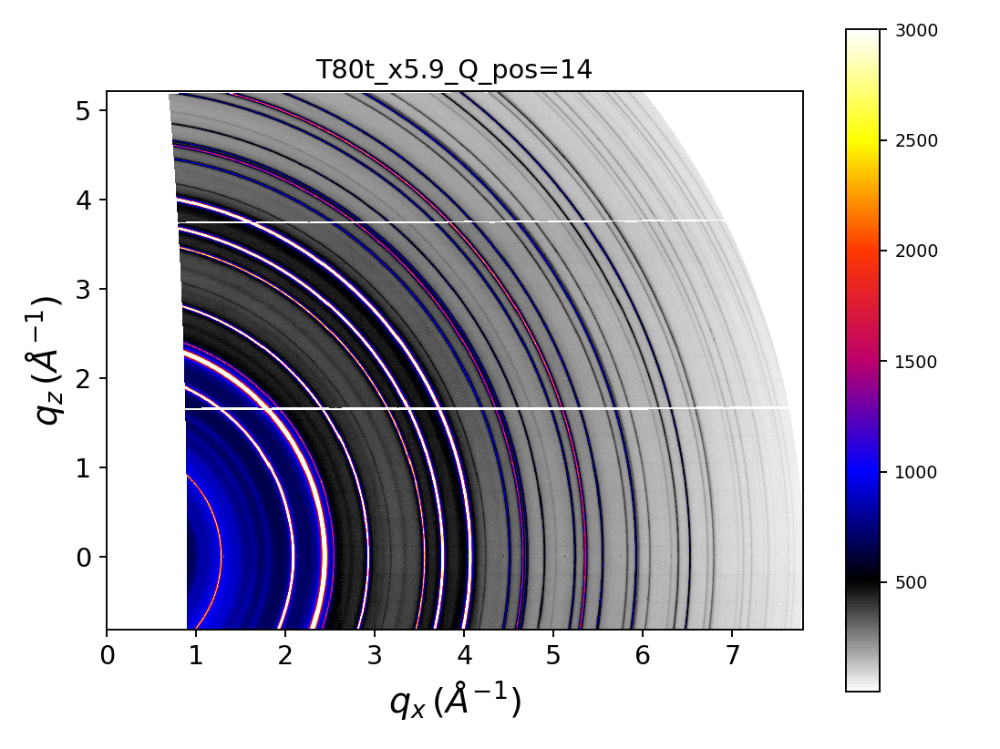

Stitching Pos: ...15
------> files to be stitched are: 
['T80t_x5.9_000155_WAXS.tif' 'T80t_x5.9_000156_WAXS.tif'
 'T80t_x5.9_000157_WAXS.tif' 'T80t_x5.9_000158_WAXS.tif'
 'T80t_x5.9_000159_WAXS.tif' 'T80t_x5.9_000160_WAXS.tif'
 'T80t_x5.9_000161_WAXS.tif' 'T80t_x5.9_000162_WAXS.tif'
 'T80t_x5.9_000163_WAXS.tif' 'T80t_x5.9_000164_WAXS.tif'
 'T80t_x5.9_000165_WAXS.tif'].


<IPython.core.display.Javascript object>


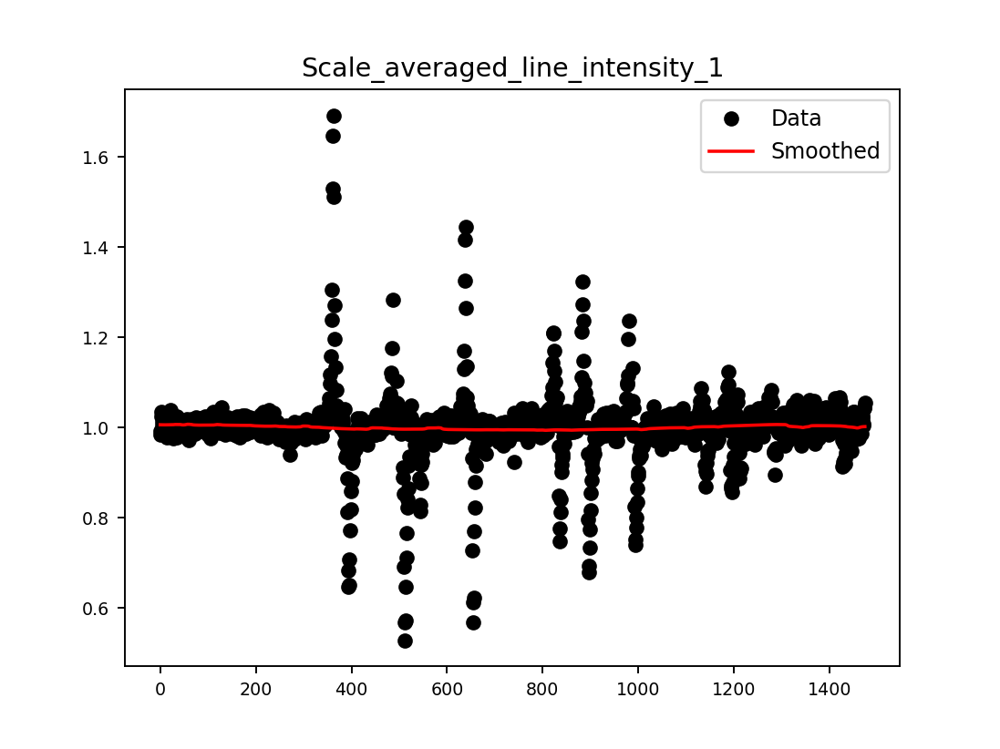

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=15.tif.


<IPython.core.display.Javascript object>


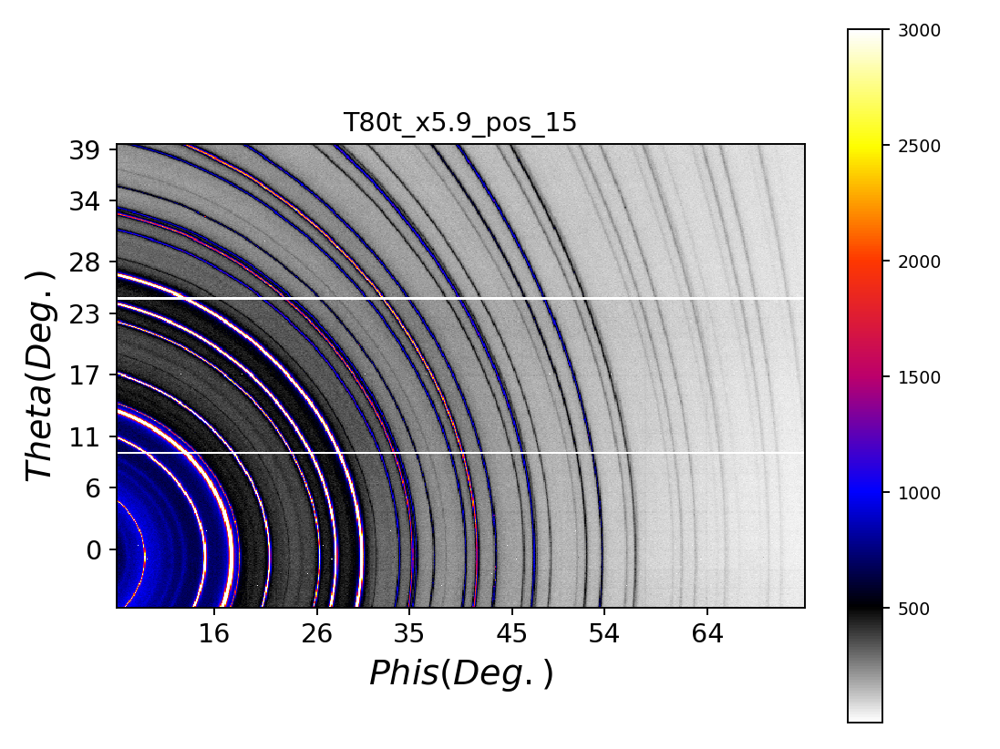

<IPython.core.display.Javascript object>


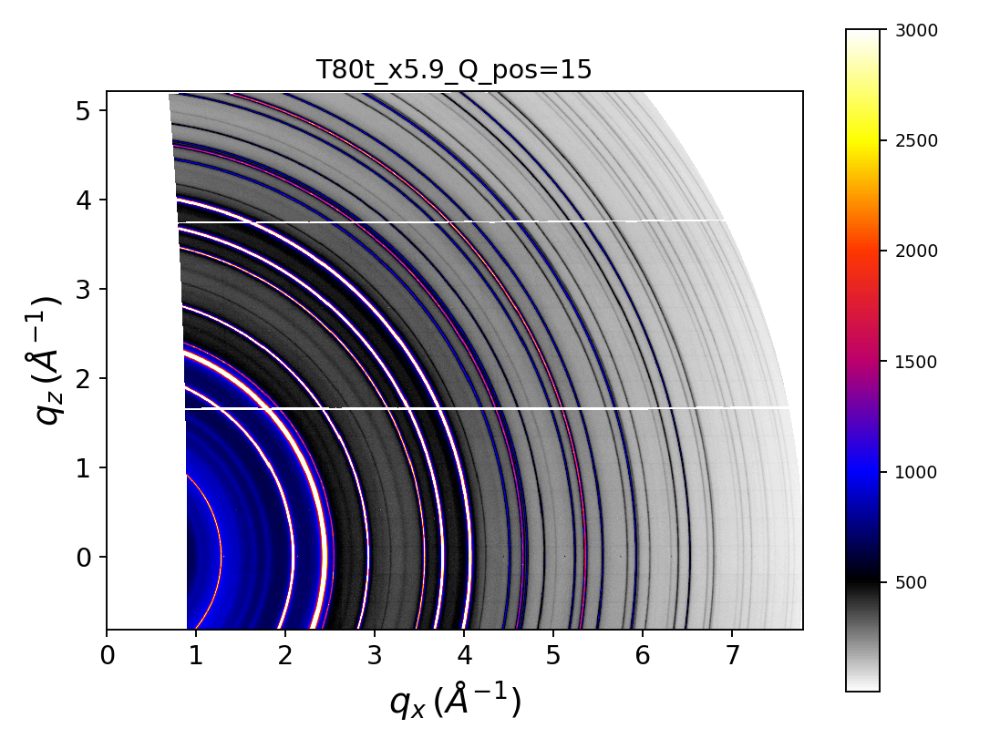

Stitching Pos: ...16
------> files to be stitched are: 
['T80t_x5.9_000176_WAXS.tif' 'T80t_x5.9_000175_WAXS.tif'
 'T80t_x5.9_000174_WAXS.tif' 'T80t_x5.9_000173_WAXS.tif'
 'T80t_x5.9_000172_WAXS.tif' 'T80t_x5.9_000171_WAXS.tif'
 'T80t_x5.9_000170_WAXS.tif' 'T80t_x5.9_000169_WAXS.tif'
 'T80t_x5.9_000168_WAXS.tif' 'T80t_x5.9_000167_WAXS.tif'
 'T80t_x5.9_000166_WAXS.tif'].


<IPython.core.display.Javascript object>

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=16.tif.


<IPython.core.display.Javascript object>


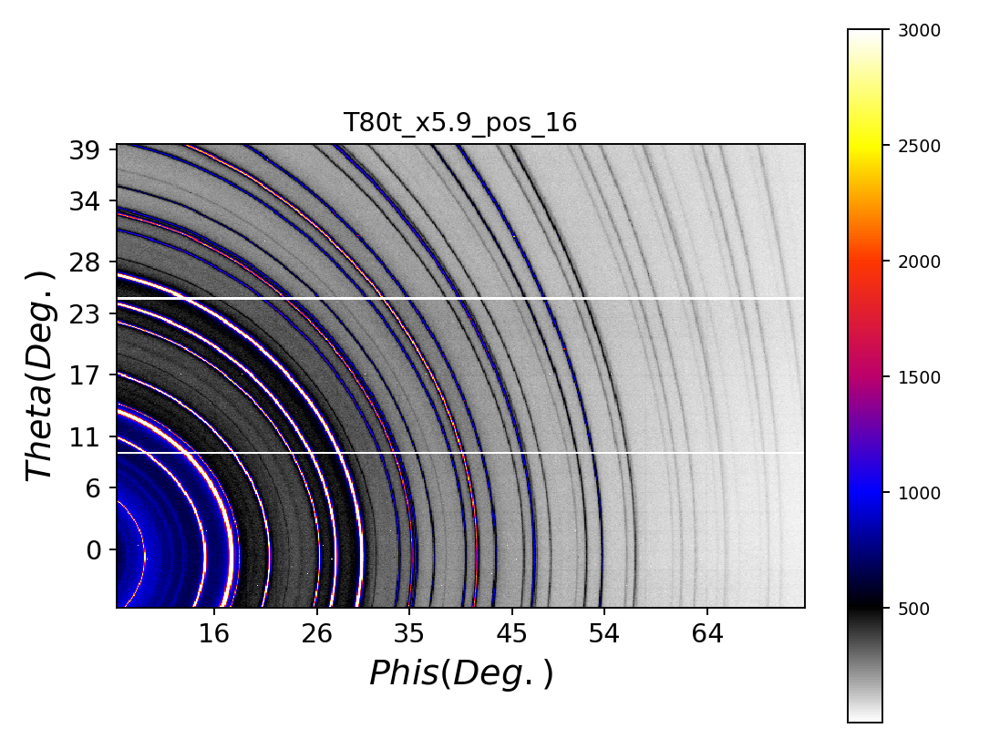

<IPython.core.display.Javascript object>


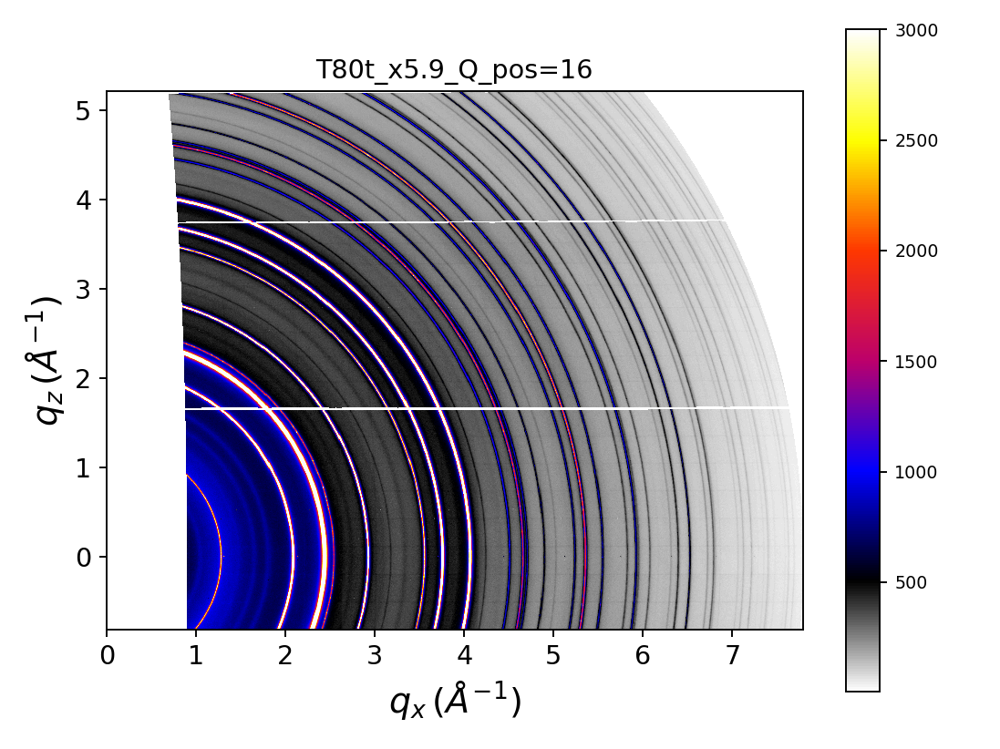

Stitching Pos: ...17
------> files to be stitched are: 
['T80t_x5.9_000177_WAXS.tif' 'T80t_x5.9_000178_WAXS.tif'
 'T80t_x5.9_000179_WAXS.tif' 'T80t_x5.9_000180_WAXS.tif'
 'T80t_x5.9_000181_WAXS.tif' 'T80t_x5.9_000182_WAXS.tif'
 'T80t_x5.9_000183_WAXS.tif' 'T80t_x5.9_000184_WAXS.tif'
 'T80t_x5.9_000185_WAXS.tif' 'T80t_x5.9_000186_WAXS.tif'
 'T80t_x5.9_000187_WAXS.tif'].


<IPython.core.display.Javascript object>


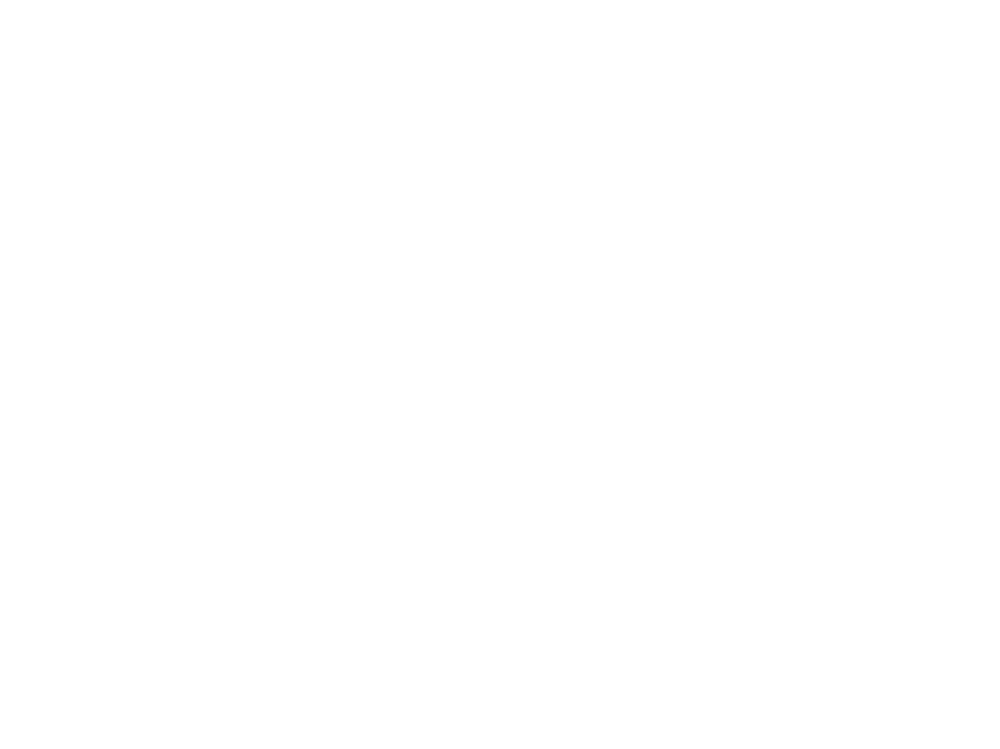

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=17.tif.


<IPython.core.display.Javascript object>


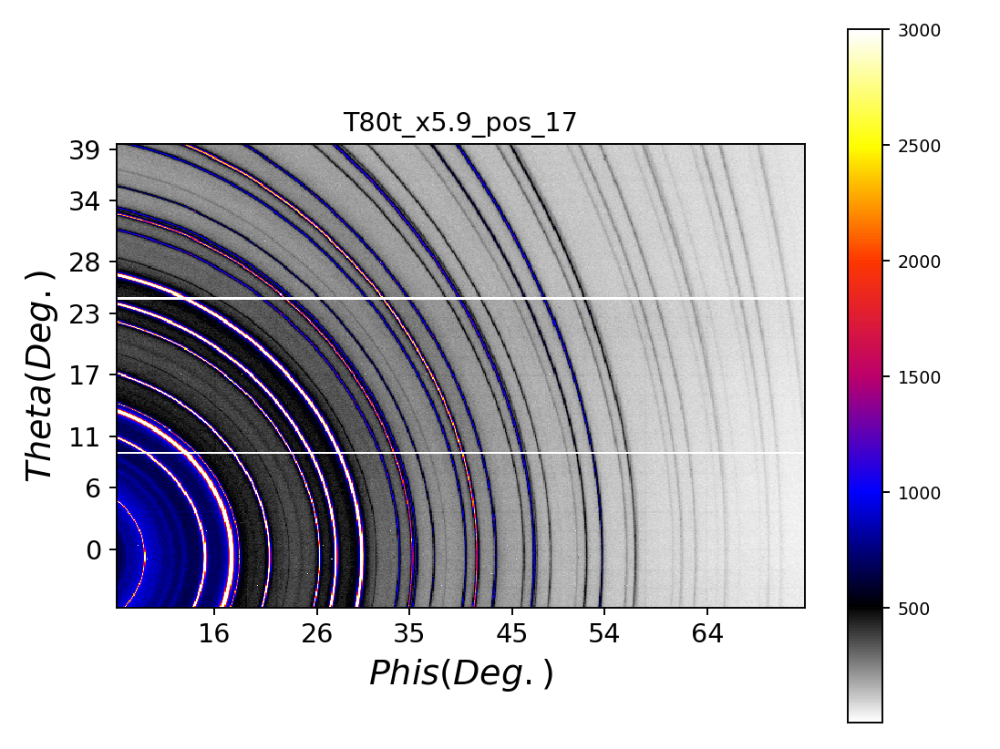

<IPython.core.display.Javascript object>


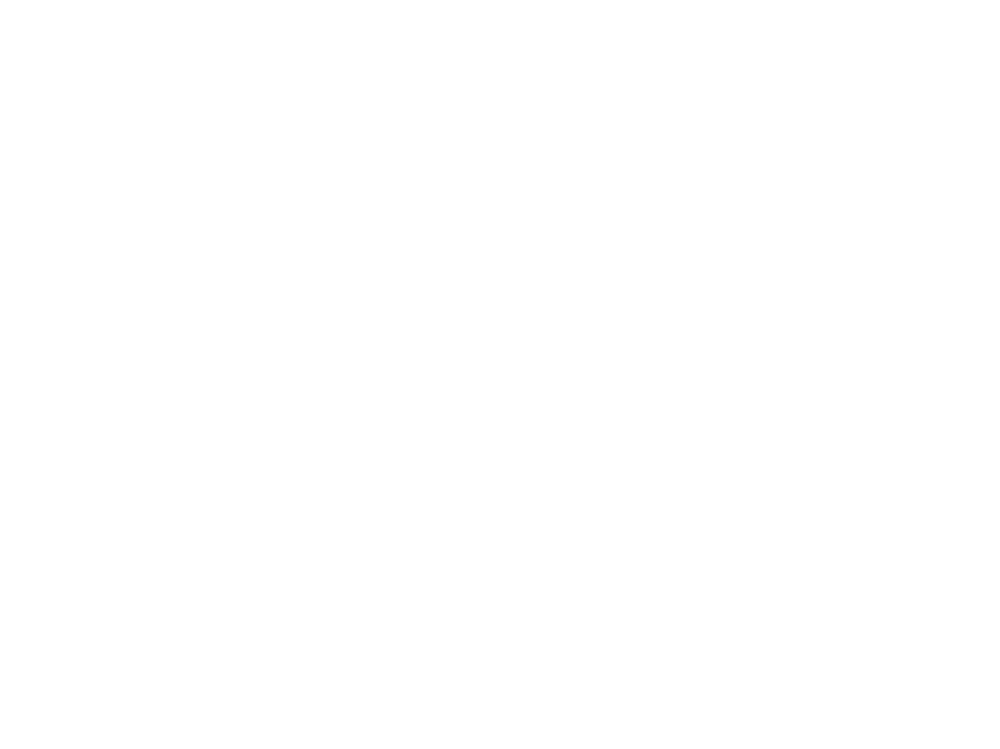

Stitching Pos: ...18
------> files to be stitched are: 
['T80t_x5.9_000198_WAXS.tif' 'T80t_x5.9_000197_WAXS.tif'
 'T80t_x5.9_000196_WAXS.tif' 'T80t_x5.9_000195_WAXS.tif'
 'T80t_x5.9_000194_WAXS.tif' 'T80t_x5.9_000193_WAXS.tif'
 'T80t_x5.9_000192_WAXS.tif' 'T80t_x5.9_000191_WAXS.tif'
 'T80t_x5.9_000190_WAXS.tif' 'T80t_x5.9_000189_WAXS.tif'
 'T80t_x5.9_000188_WAXS.tif'].


<IPython.core.display.Javascript object>


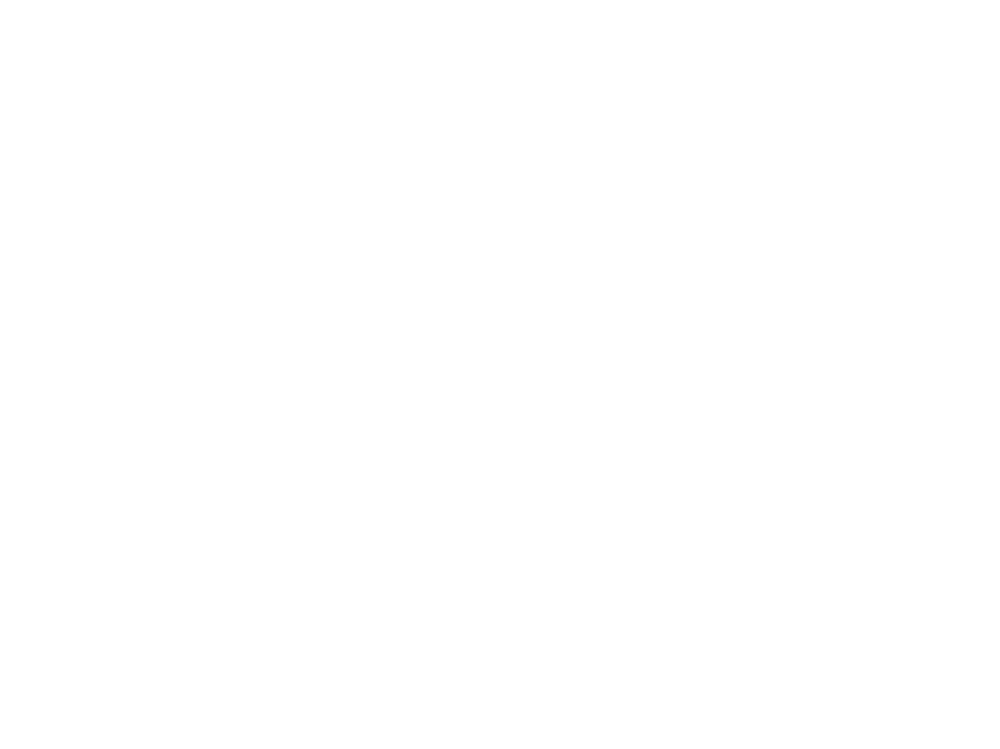

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=18.tif.


<IPython.core.display.Javascript object>


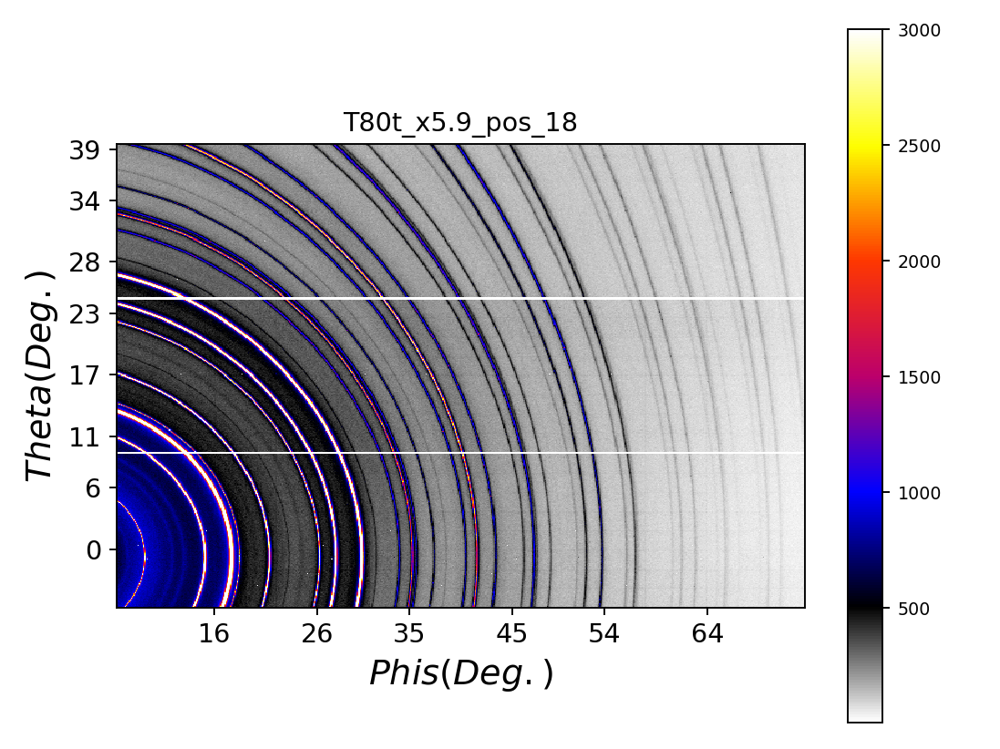

<IPython.core.display.Javascript object>


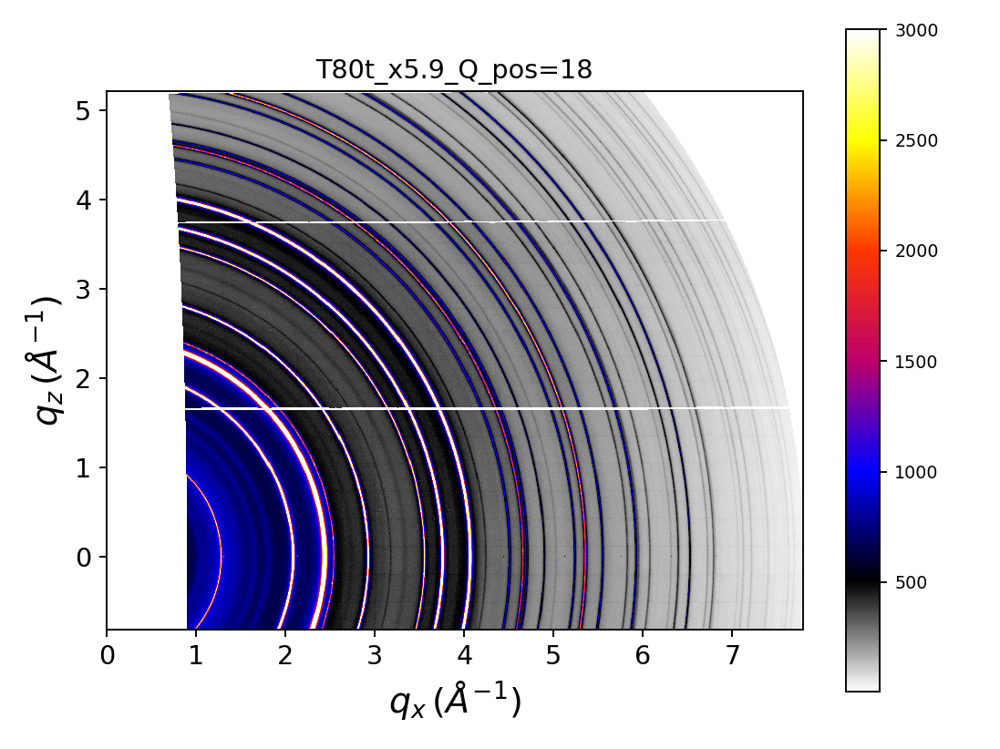

Stitching Pos: ...19
------> files to be stitched are: 
['T80t_x5.9_000199_WAXS.tif' 'T80t_x5.9_000200_WAXS.tif'
 'T80t_x5.9_000201_WAXS.tif' 'T80t_x5.9_000202_WAXS.tif'
 'T80t_x5.9_000203_WAXS.tif' 'T80t_x5.9_000204_WAXS.tif'
 'T80t_x5.9_000205_WAXS.tif' 'T80t_x5.9_000206_WAXS.tif'
 'T80t_x5.9_000207_WAXS.tif' 'T80t_x5.9_000208_WAXS.tif'
 'T80t_x5.9_000209_WAXS.tif'].


<IPython.core.display.Javascript object>


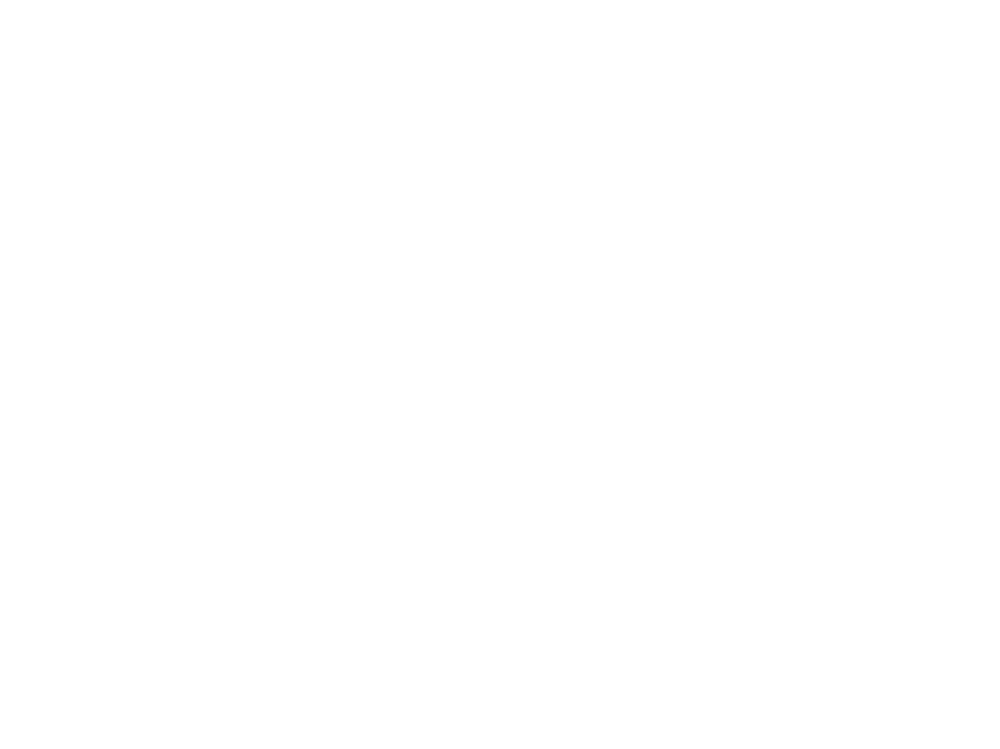

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=19.tif.


<IPython.core.display.Javascript object>


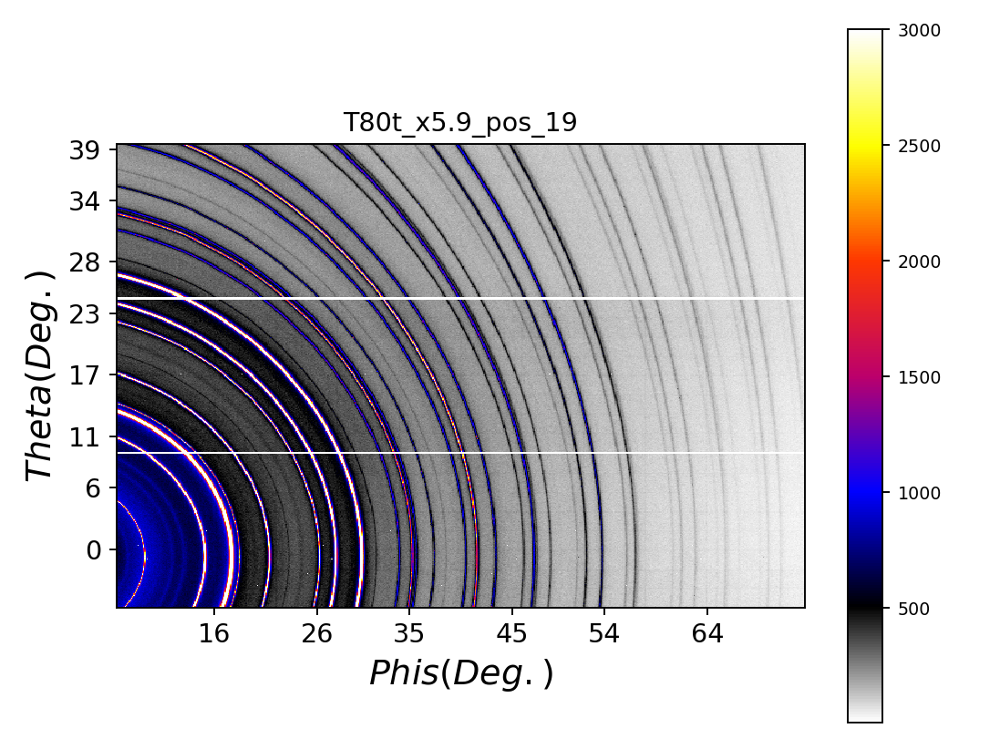

<IPython.core.display.Javascript object>


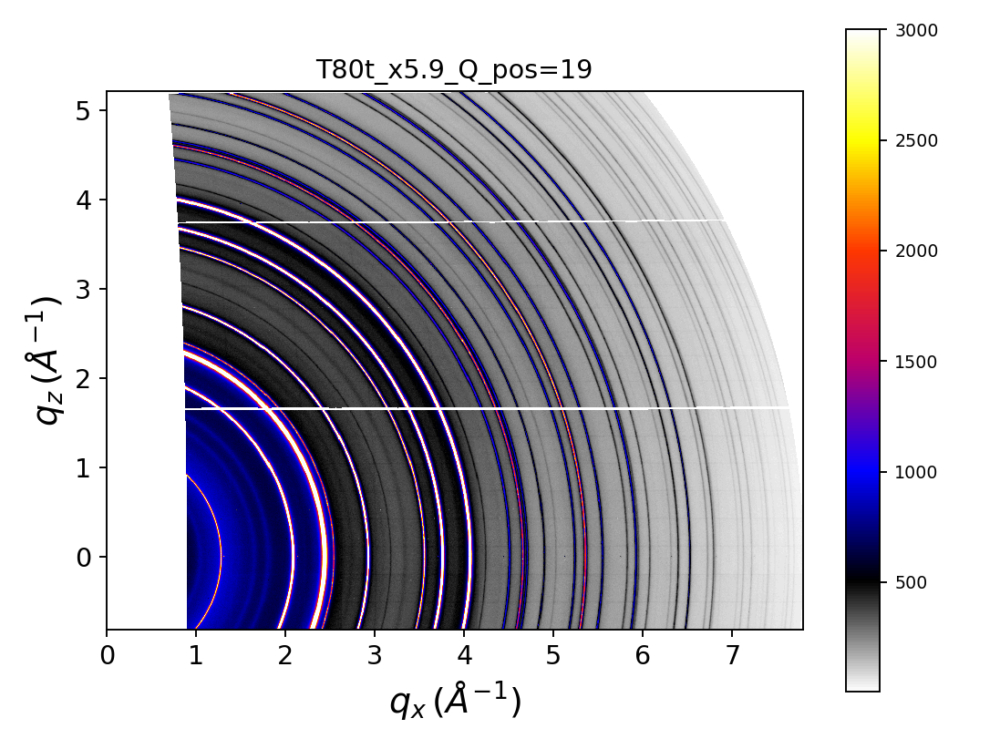

Stitching Pos: ...20
------> files to be stitched are: 
['T80t_x5.9_000220_WAXS.tif' 'T80t_x5.9_000219_WAXS.tif'
 'T80t_x5.9_000218_WAXS.tif' 'T80t_x5.9_000217_WAXS.tif'
 'T80t_x5.9_000216_WAXS.tif' 'T80t_x5.9_000215_WAXS.tif'
 'T80t_x5.9_000214_WAXS.tif' 'T80t_x5.9_000213_WAXS.tif'
 'T80t_x5.9_000212_WAXS.tif' 'T80t_x5.9_000211_WAXS.tif'
 'T80t_x5.9_000210_WAXS.tif'].


<IPython.core.display.Javascript object>


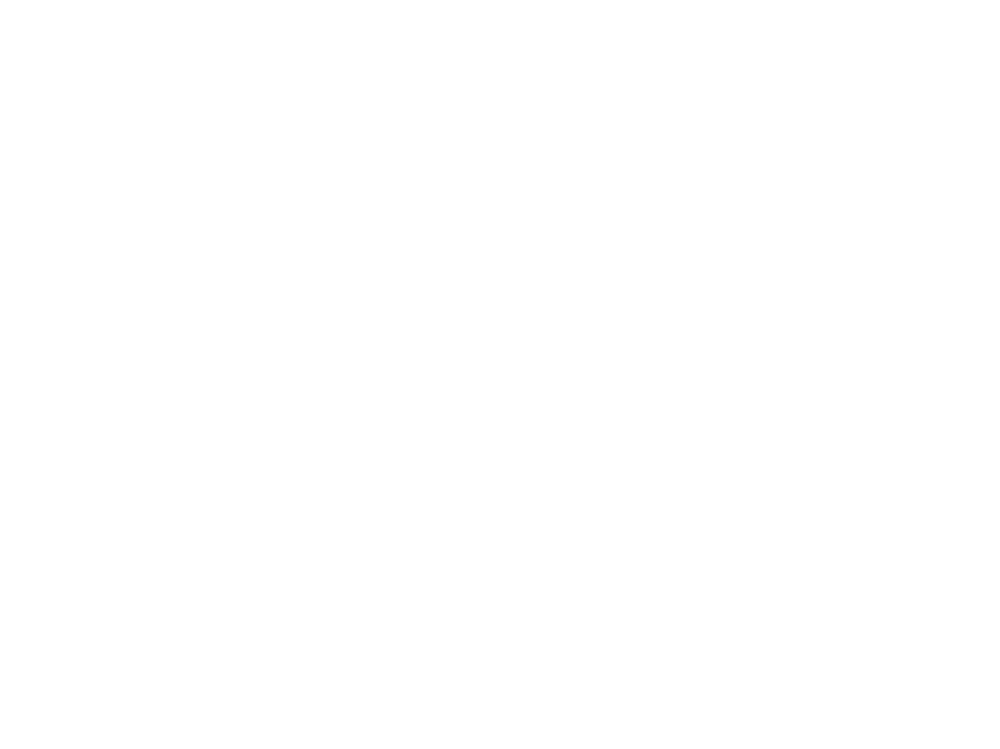

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=20.tif.


<IPython.core.display.Javascript object>


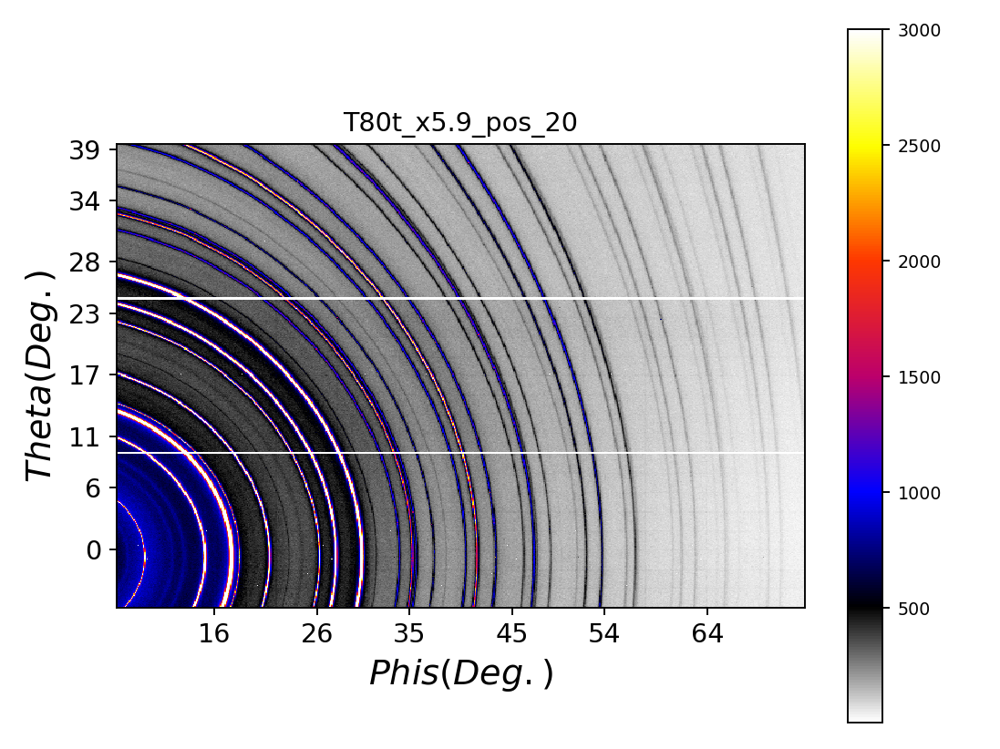

<IPython.core.display.Javascript object>


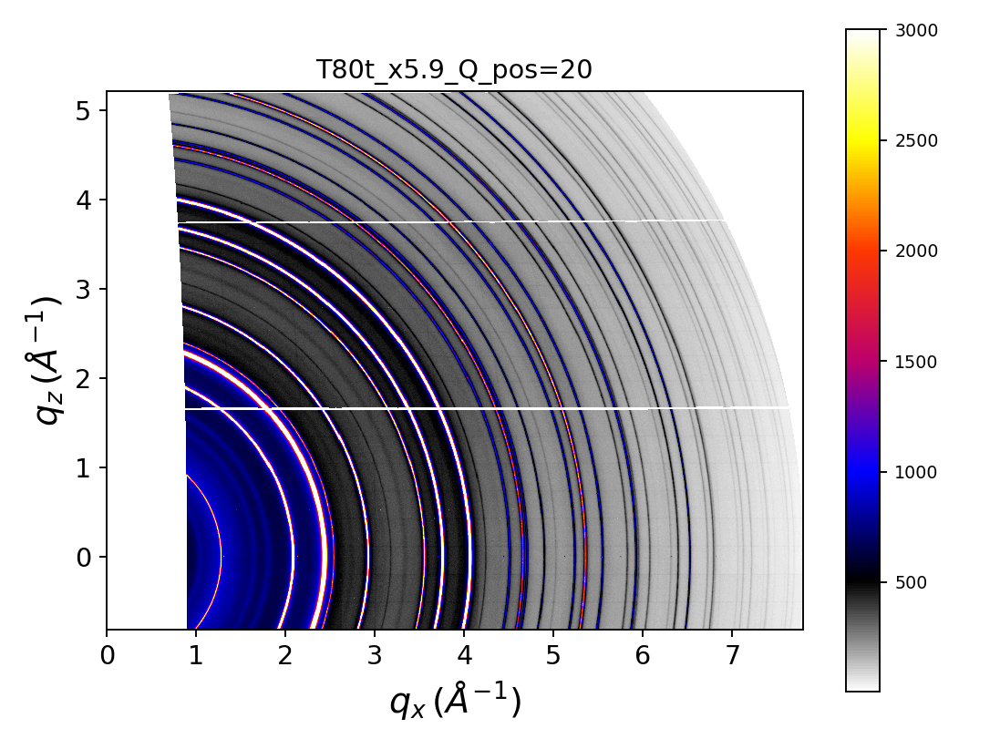

Stitching Pos: ...21
------> files to be stitched are: 
['T80t_x5.9_000221_WAXS.tif' 'T80t_x5.9_000222_WAXS.tif'
 'T80t_x5.9_000223_WAXS.tif' 'T80t_x5.9_000224_WAXS.tif'
 'T80t_x5.9_000225_WAXS.tif' 'T80t_x5.9_000226_WAXS.tif'
 'T80t_x5.9_000227_WAXS.tif' 'T80t_x5.9_000228_WAXS.tif'
 'T80t_x5.9_000229_WAXS.tif' 'T80t_x5.9_000230_WAXS.tif'
 'T80t_x5.9_000231_WAXS.tif'].


<IPython.core.display.Javascript object>


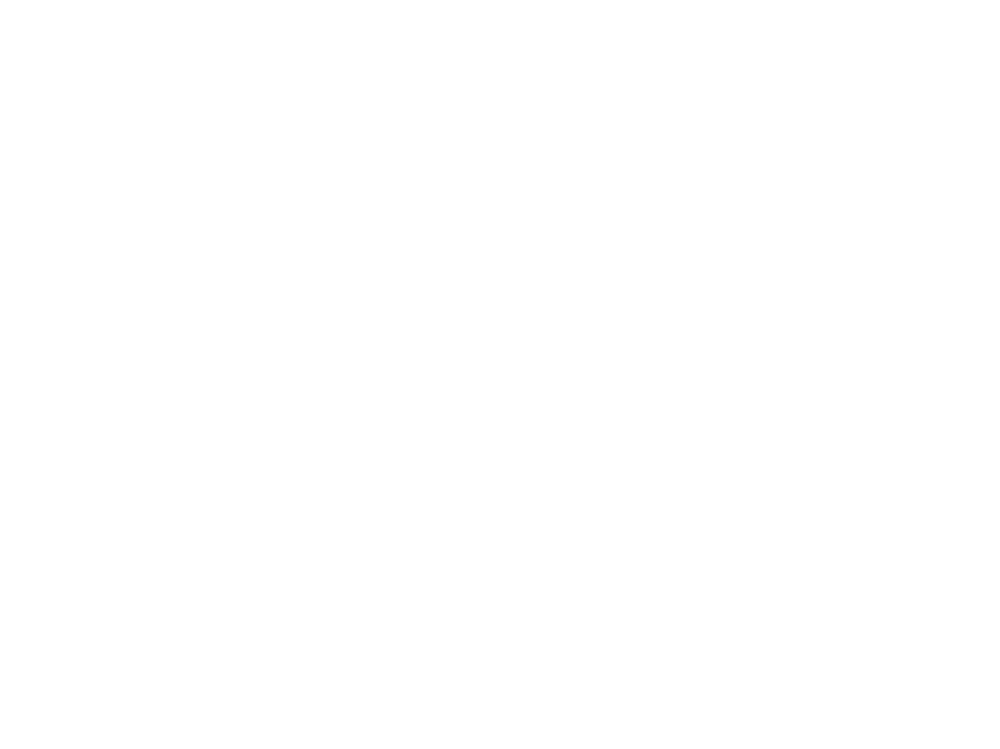

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=21.tif.


<IPython.core.display.Javascript object>


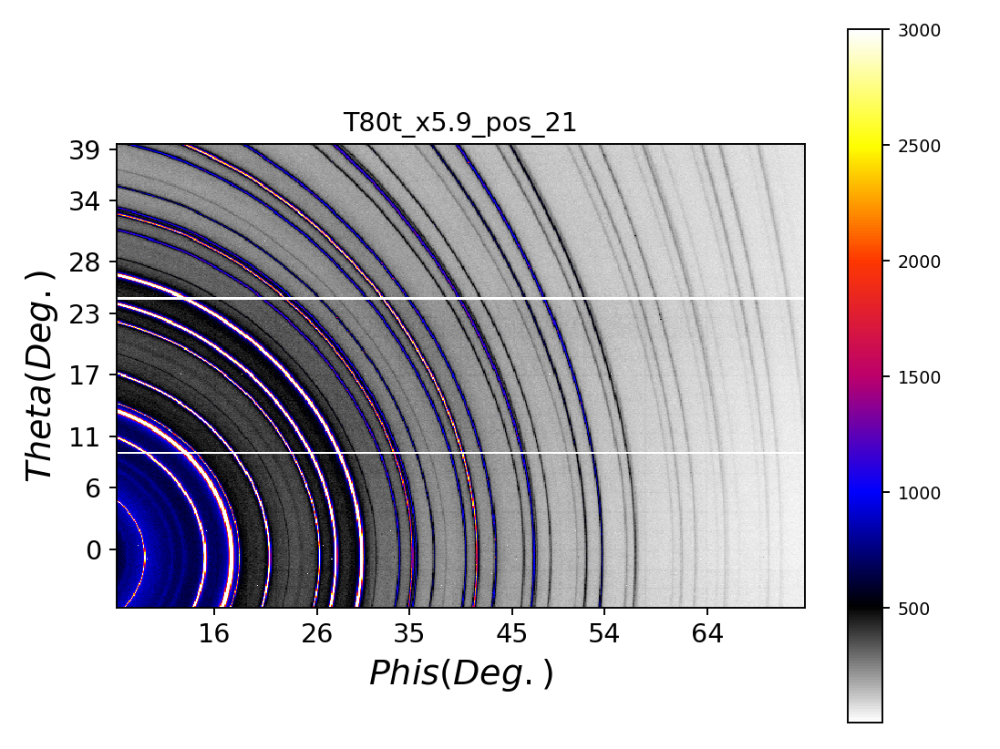

<IPython.core.display.Javascript object>


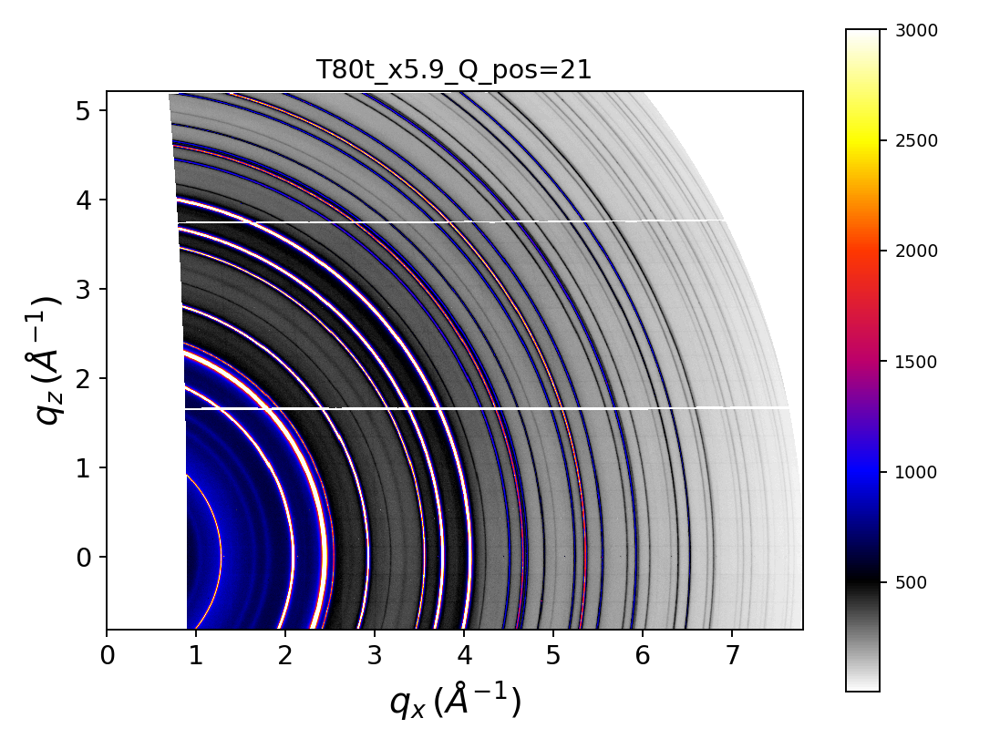

Stitching Pos: ...22
------> files to be stitched are: 
['T80t_x5.9_000242_WAXS.tif' 'T80t_x5.9_000241_WAXS.tif'
 'T80t_x5.9_000240_WAXS.tif' 'T80t_x5.9_000239_WAXS.tif'
 'T80t_x5.9_000238_WAXS.tif' 'T80t_x5.9_000237_WAXS.tif'
 'T80t_x5.9_000236_WAXS.tif' 'T80t_x5.9_000235_WAXS.tif'
 'T80t_x5.9_000234_WAXS.tif' 'T80t_x5.9_000233_WAXS.tif'
 'T80t_x5.9_000232_WAXS.tif'].


<IPython.core.display.Javascript object>


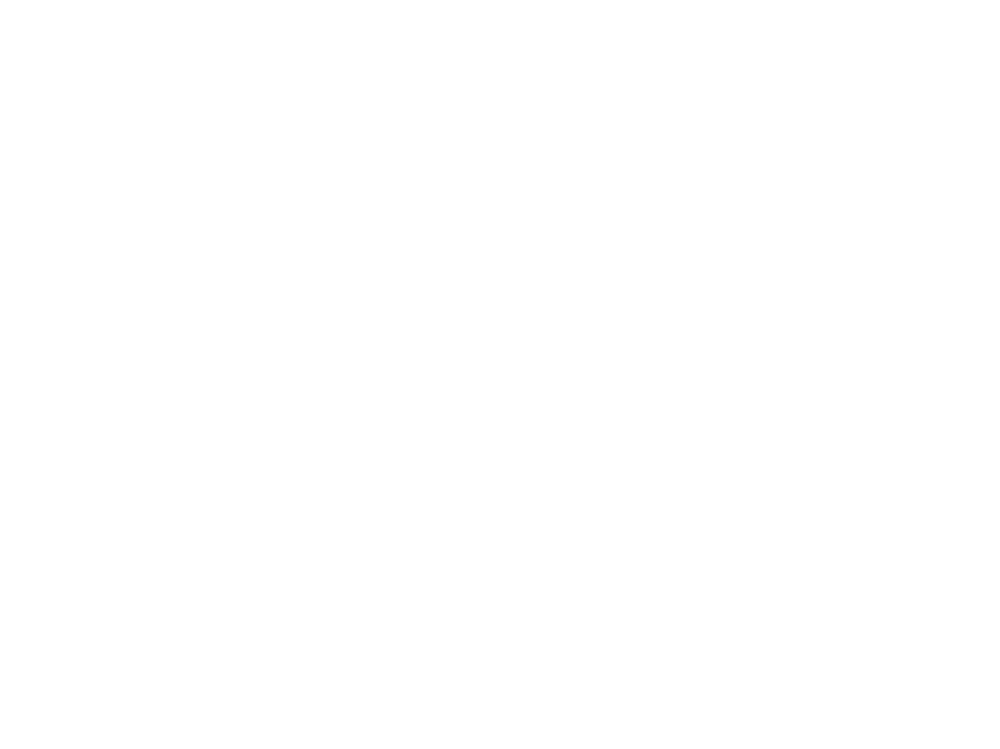

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=22.tif.


<IPython.core.display.Javascript object>


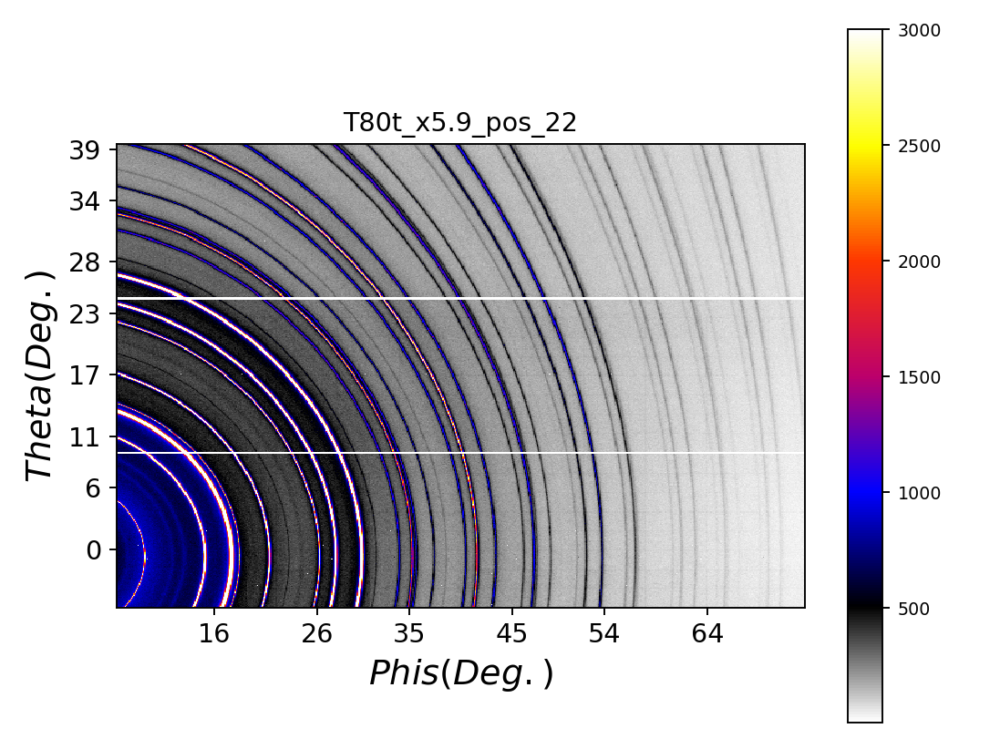

<IPython.core.display.Javascript object>


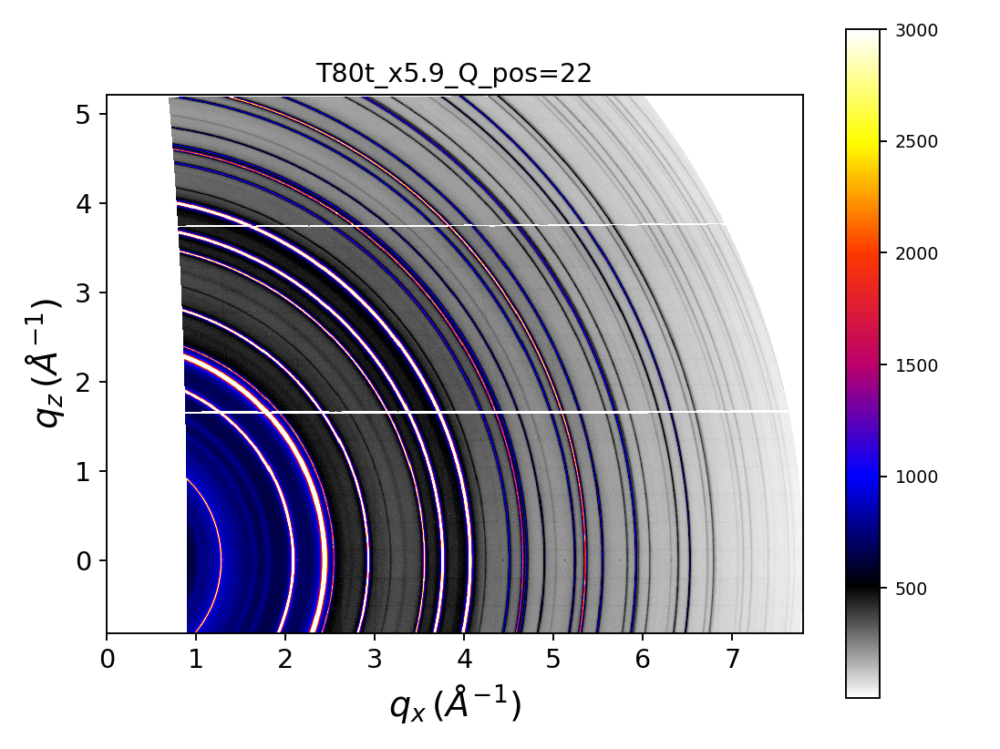

Stitching Pos: ...23
------> files to be stitched are: 
['T80t_x5.9_000243_WAXS.tif' 'T80t_x5.9_000244_WAXS.tif'
 'T80t_x5.9_000245_WAXS.tif' 'T80t_x5.9_000246_WAXS.tif'
 'T80t_x5.9_000247_WAXS.tif' 'T80t_x5.9_000248_WAXS.tif'
 'T80t_x5.9_000249_WAXS.tif' 'T80t_x5.9_000250_WAXS.tif'
 'T80t_x5.9_000251_WAXS.tif' 'T80t_x5.9_000252_WAXS.tif'
 'T80t_x5.9_000253_WAXS.tif'].


<IPython.core.display.Javascript object>


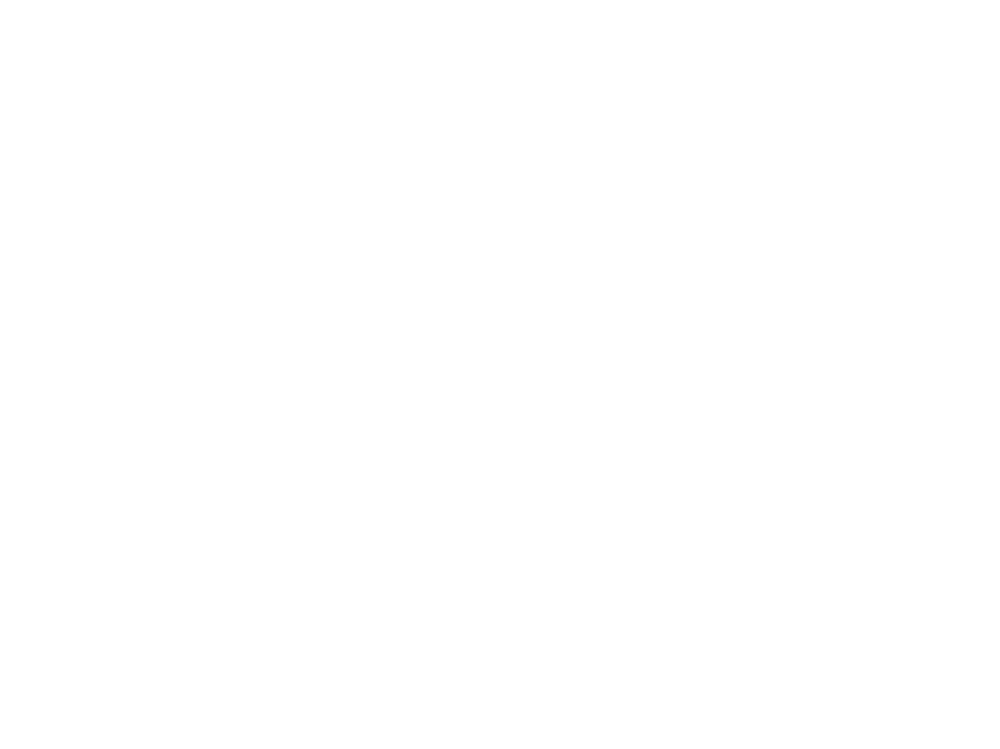

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=23.tif.


<IPython.core.display.Javascript object>


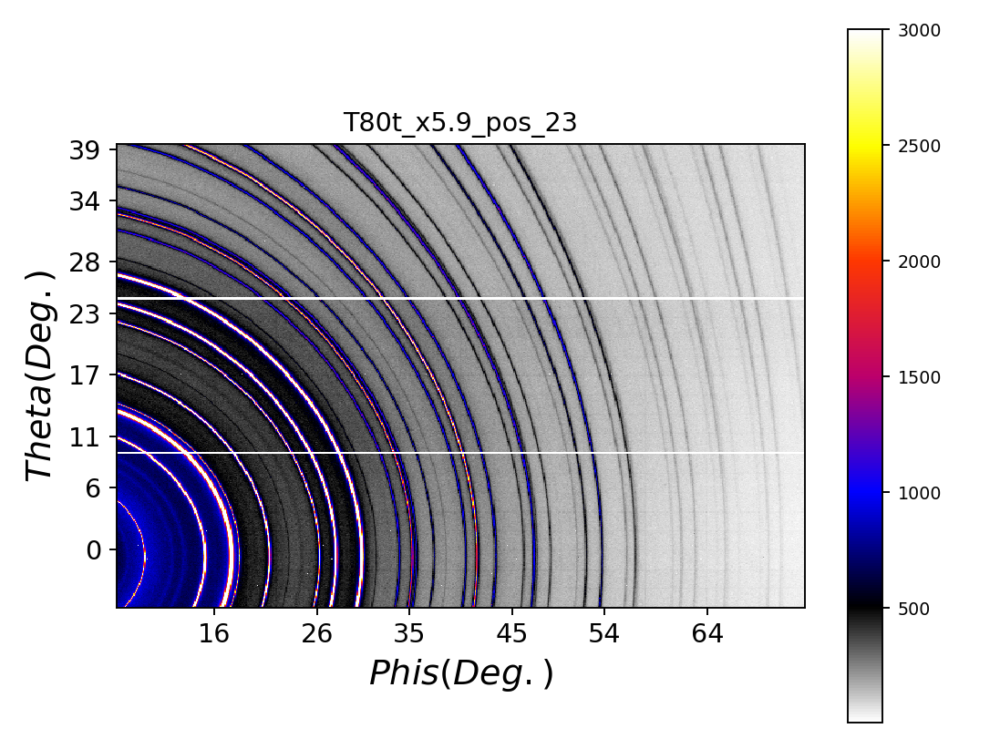

<IPython.core.display.Javascript object>


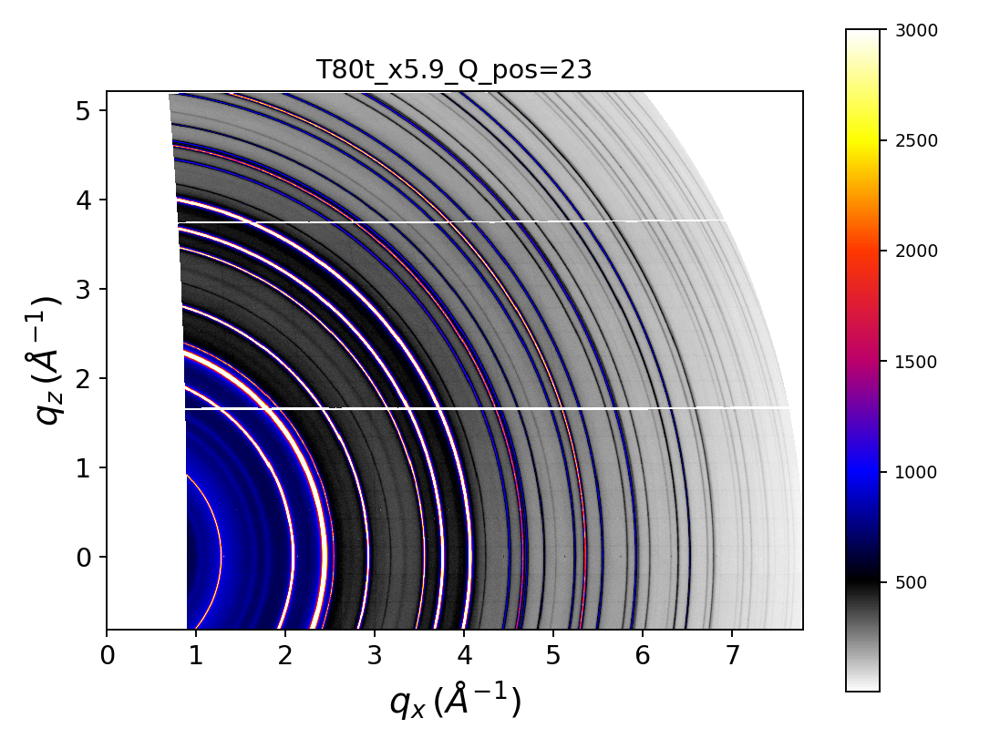

Stitching Pos: ...24
------> files to be stitched are: 
['T80t_x5.9_000264_WAXS.tif' 'T80t_x5.9_000263_WAXS.tif'
 'T80t_x5.9_000262_WAXS.tif' 'T80t_x5.9_000261_WAXS.tif'
 'T80t_x5.9_000260_WAXS.tif' 'T80t_x5.9_000259_WAXS.tif'
 'T80t_x5.9_000258_WAXS.tif' 'T80t_x5.9_000257_WAXS.tif'
 'T80t_x5.9_000256_WAXS.tif' 'T80t_x5.9_000255_WAXS.tif'
 'T80t_x5.9_000254_WAXS.tif'].


<IPython.core.display.Javascript object>


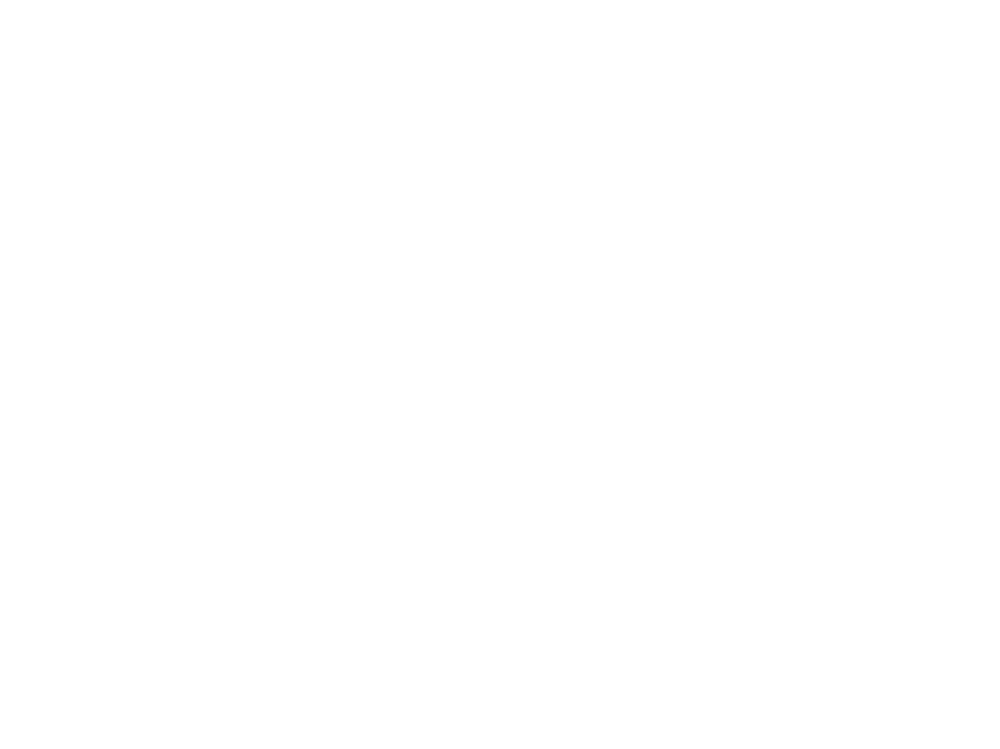

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=24.tif.


<IPython.core.display.Javascript object>


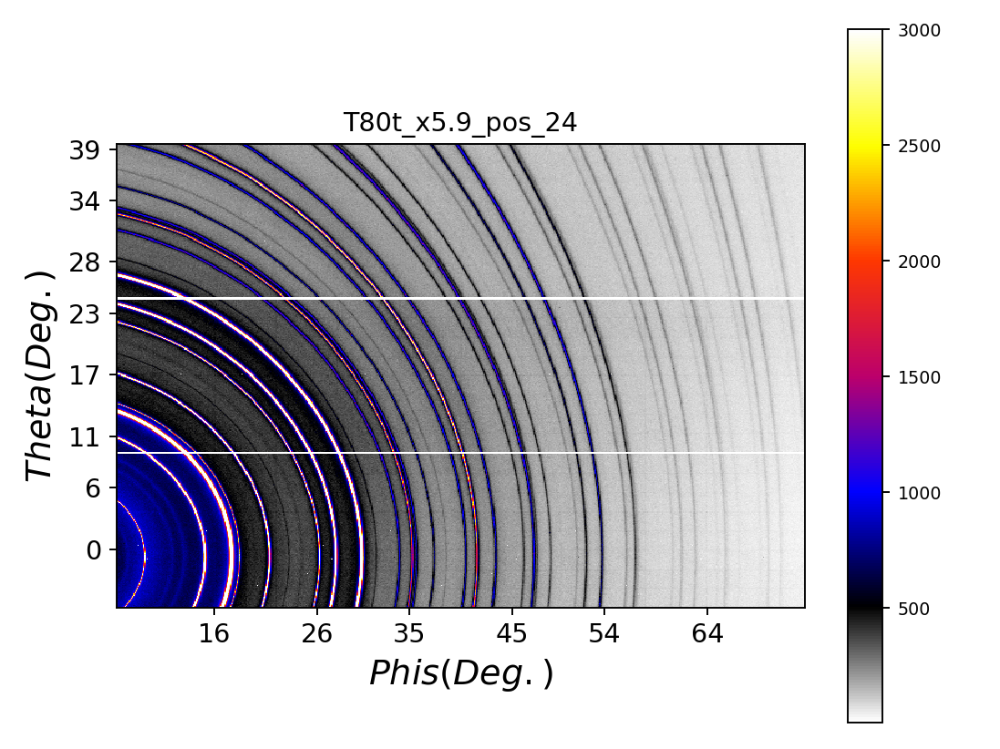

<IPython.core.display.Javascript object>


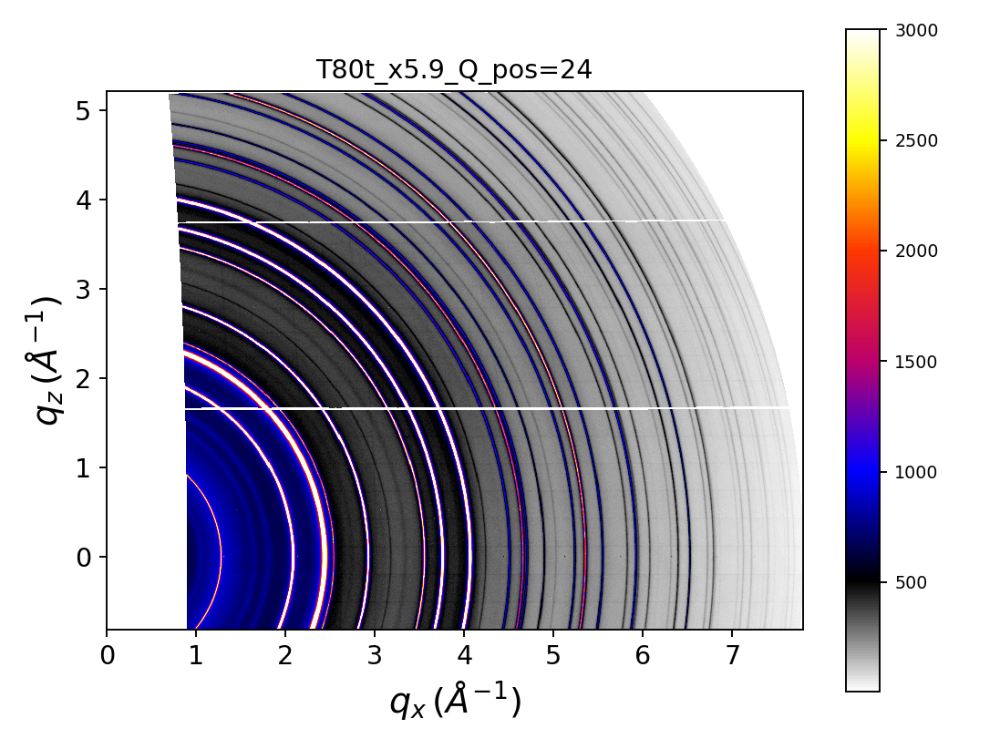

Stitching Pos: ...25
------> files to be stitched are: 
['T80t_x5.9_000265_WAXS.tif' 'T80t_x5.9_000266_WAXS.tif'
 'T80t_x5.9_000267_WAXS.tif' 'T80t_x5.9_000268_WAXS.tif'
 'T80t_x5.9_000269_WAXS.tif' 'T80t_x5.9_000270_WAXS.tif'
 'T80t_x5.9_000271_WAXS.tif' 'T80t_x5.9_000272_WAXS.tif'
 'T80t_x5.9_000273_WAXS.tif' 'T80t_x5.9_000274_WAXS.tif'
 'T80t_x5.9_000275_WAXS.tif'].


<IPython.core.display.Javascript object>


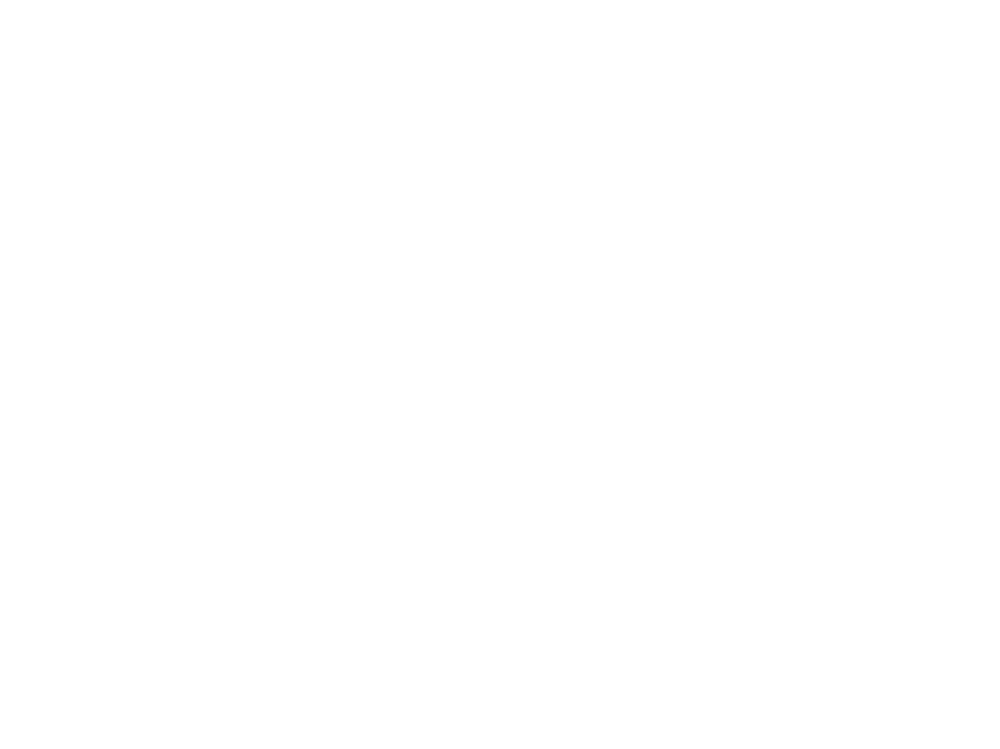

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=25.tif.


<IPython.core.display.Javascript object>


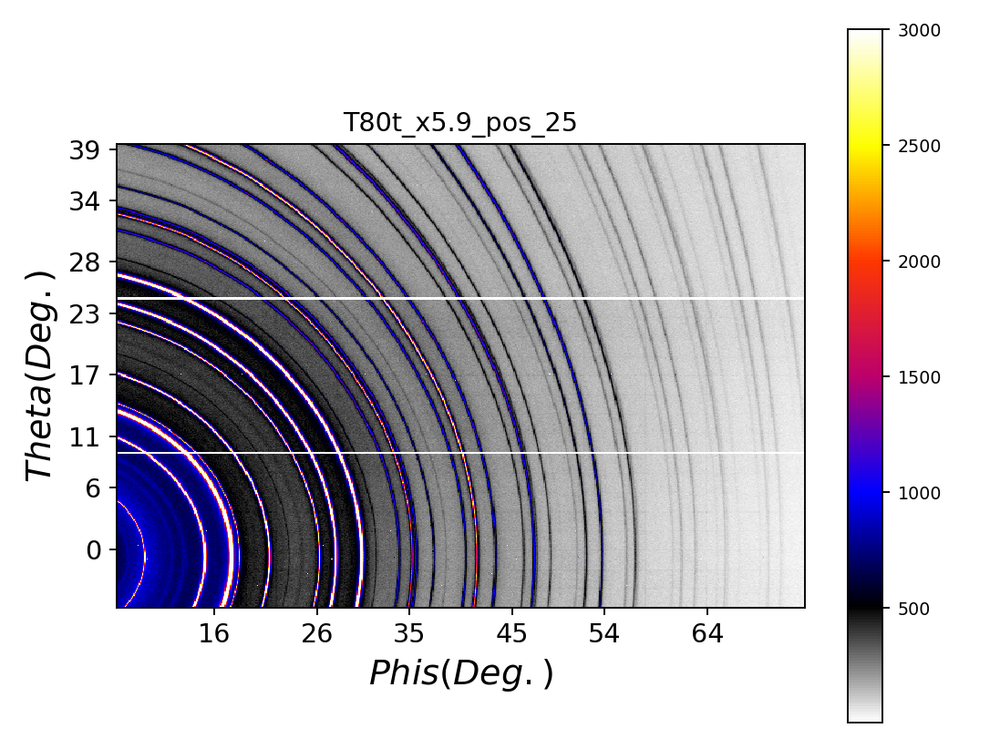

<IPython.core.display.Javascript object>


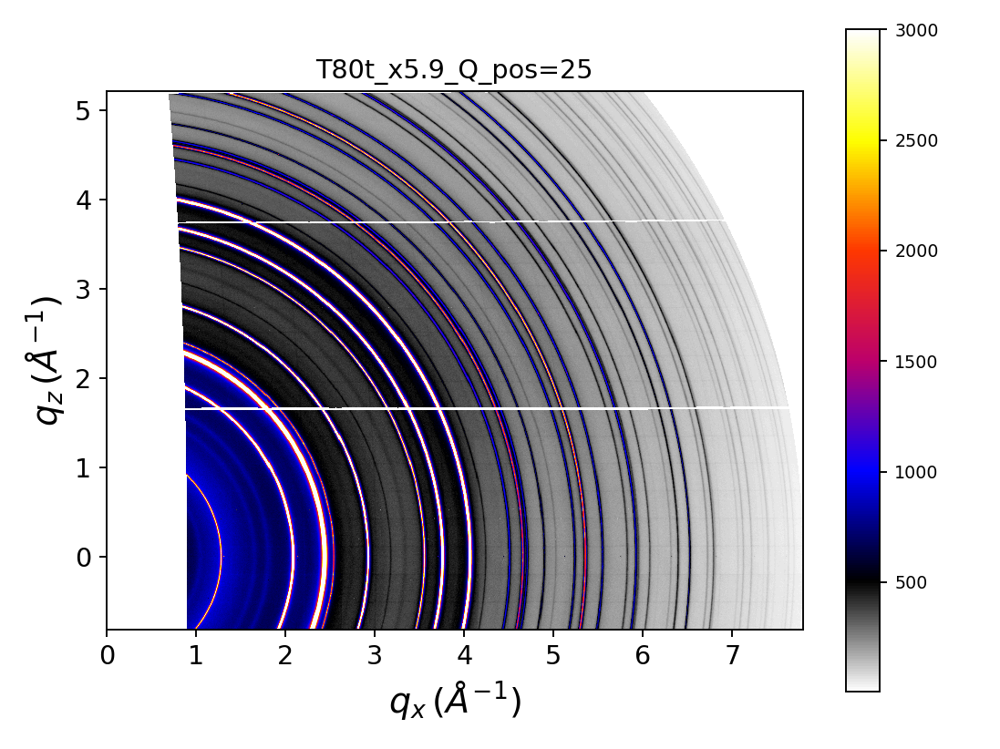

Stitching Pos: ...26
------> files to be stitched are: 
['T80t_x5.9_000286_WAXS.tif' 'T80t_x5.9_000285_WAXS.tif'
 'T80t_x5.9_000284_WAXS.tif' 'T80t_x5.9_000283_WAXS.tif'
 'T80t_x5.9_000282_WAXS.tif' 'T80t_x5.9_000281_WAXS.tif'
 'T80t_x5.9_000280_WAXS.tif' 'T80t_x5.9_000279_WAXS.tif'
 'T80t_x5.9_000278_WAXS.tif' 'T80t_x5.9_000277_WAXS.tif'
 'T80t_x5.9_000276_WAXS.tif'].


<IPython.core.display.Javascript object>


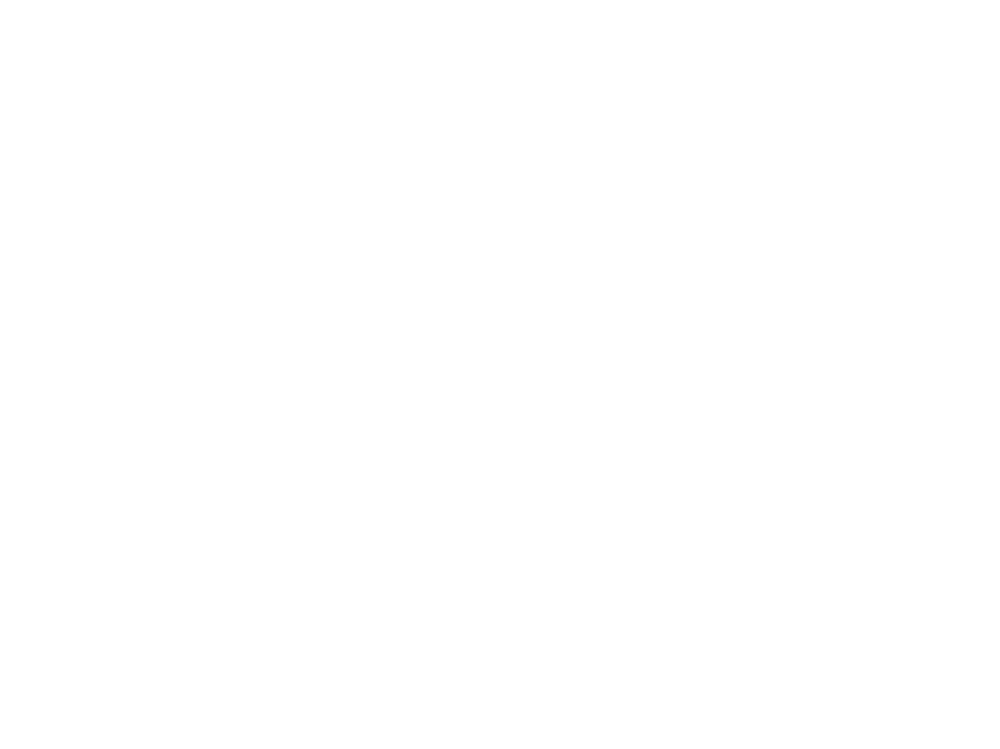

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=26.tif.


<IPython.core.display.Javascript object>


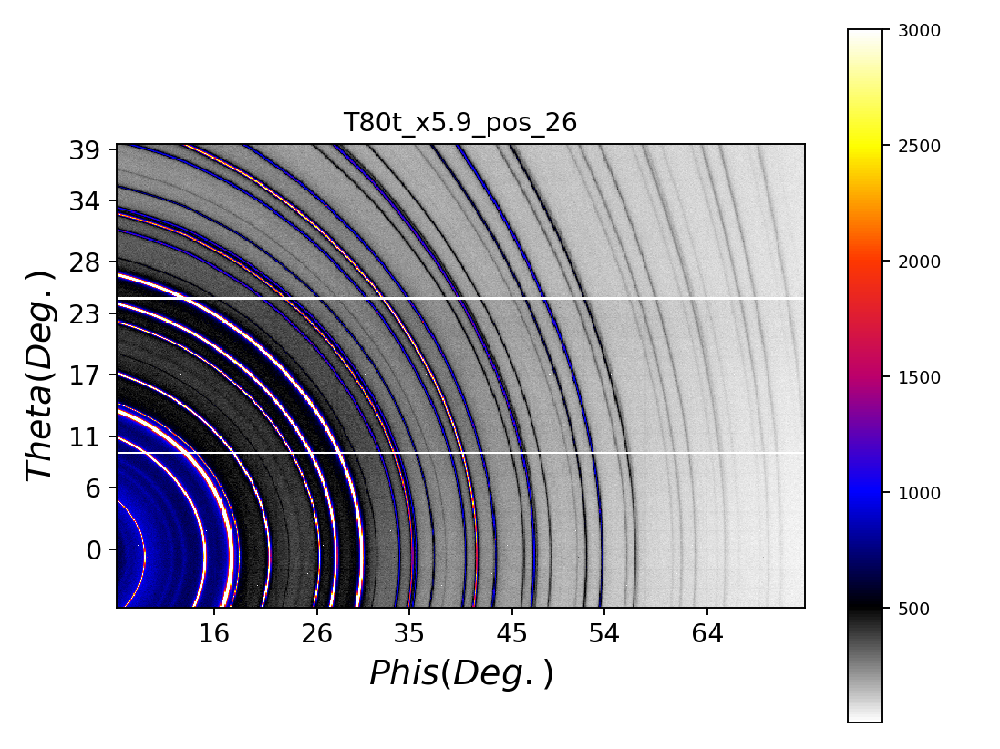

<IPython.core.display.Javascript object>


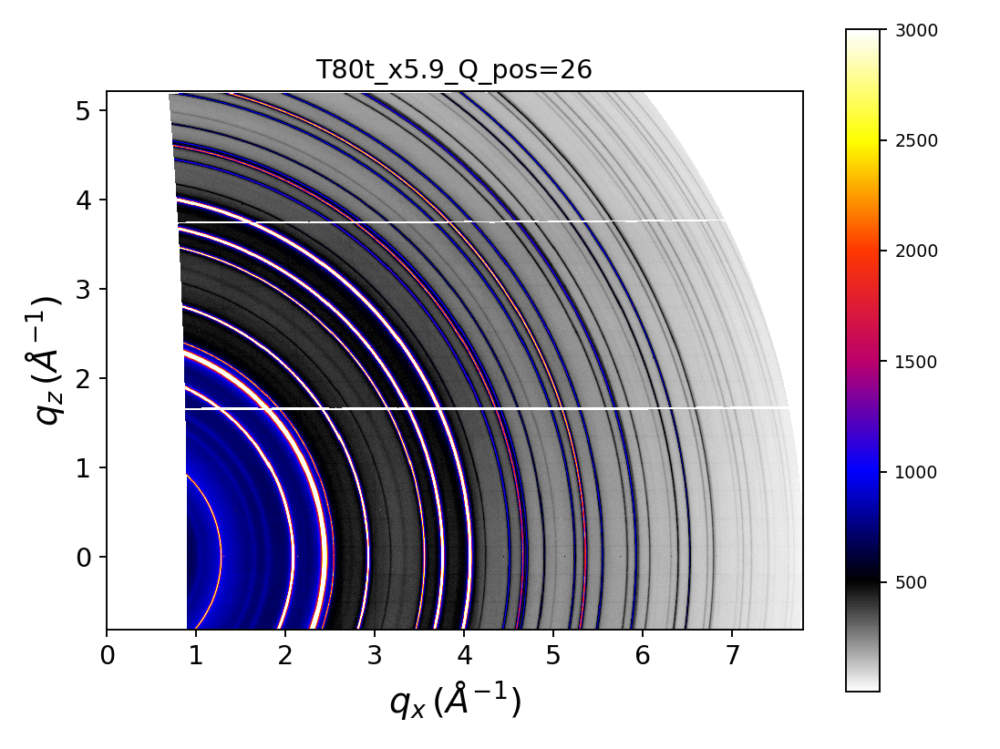

Stitching Pos: ...27
------> files to be stitched are: 
['T80t_x5.9_000287_WAXS.tif' 'T80t_x5.9_000288_WAXS.tif'
 'T80t_x5.9_000289_WAXS.tif' 'T80t_x5.9_000290_WAXS.tif'
 'T80t_x5.9_000291_WAXS.tif' 'T80t_x5.9_000292_WAXS.tif'
 'T80t_x5.9_000293_WAXS.tif' 'T80t_x5.9_000294_WAXS.tif'
 'T80t_x5.9_000295_WAXS.tif' 'T80t_x5.9_000296_WAXS.tif'
 'T80t_x5.9_000297_WAXS.tif'].


<IPython.core.display.Javascript object>


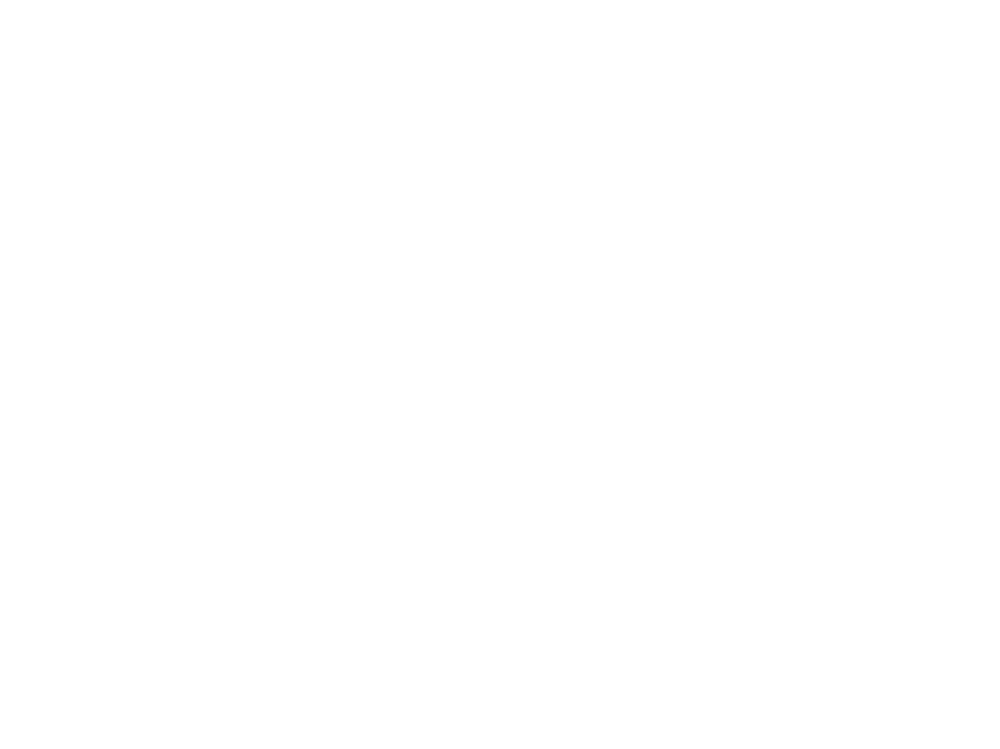

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=27.tif.


<IPython.core.display.Javascript object>


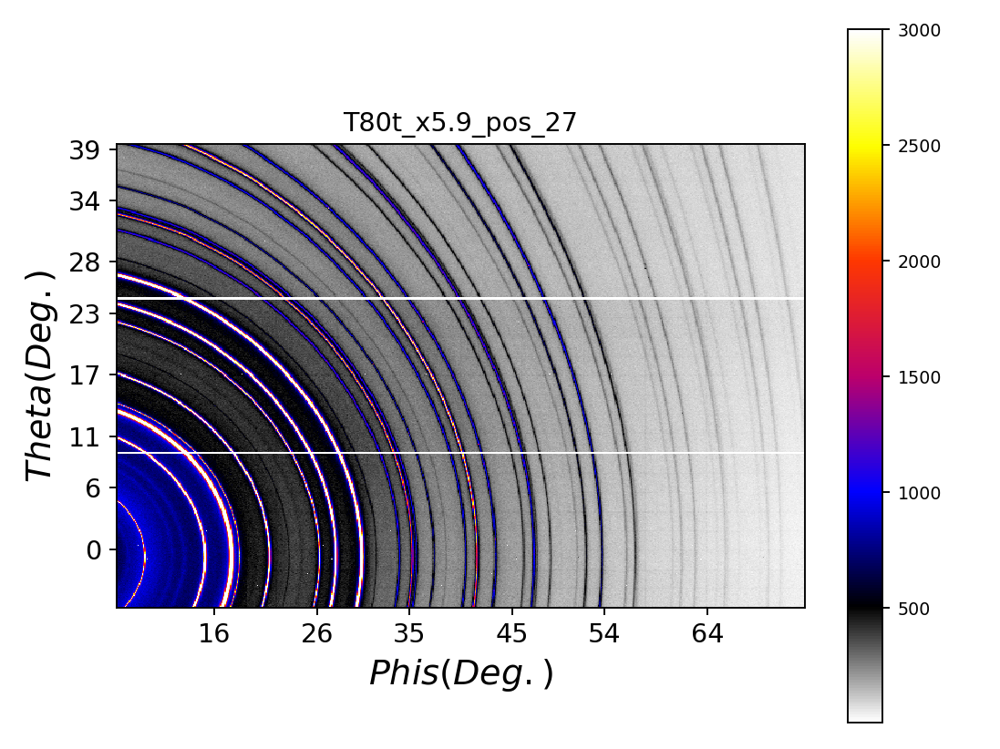

<IPython.core.display.Javascript object>


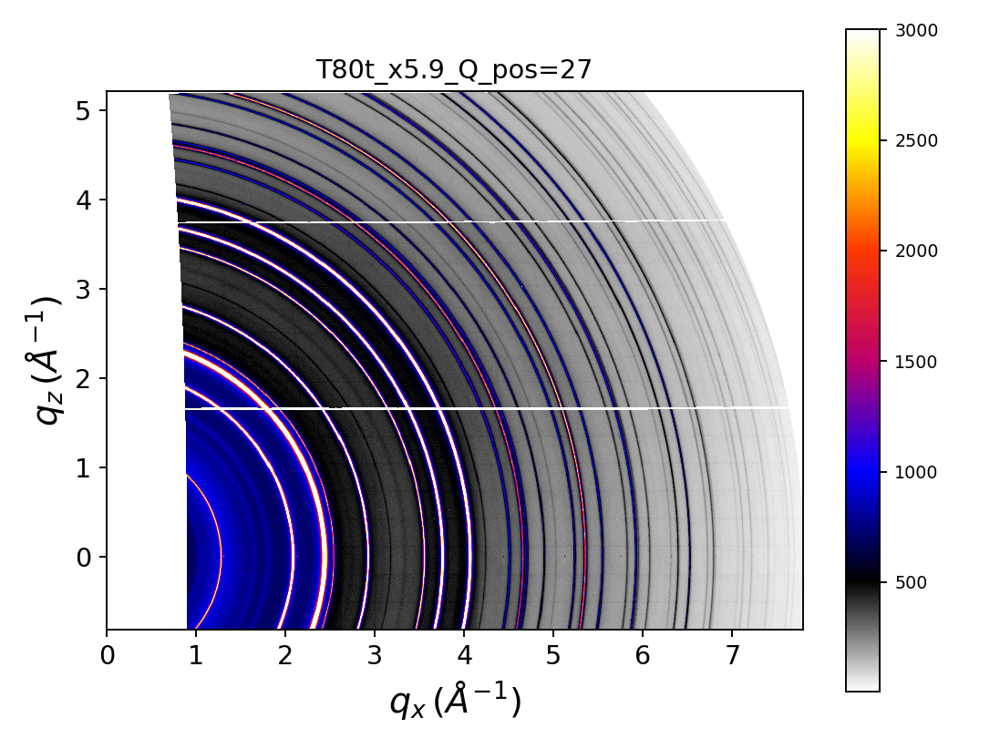

Stitching Pos: ...28
------> files to be stitched are: 
['T80t_x5.9_000308_WAXS.tif' 'T80t_x5.9_000307_WAXS.tif'
 'T80t_x5.9_000306_WAXS.tif' 'T80t_x5.9_000305_WAXS.tif'
 'T80t_x5.9_000304_WAXS.tif' 'T80t_x5.9_000303_WAXS.tif'
 'T80t_x5.9_000302_WAXS.tif' 'T80t_x5.9_000301_WAXS.tif'
 'T80t_x5.9_000300_WAXS.tif' 'T80t_x5.9_000299_WAXS.tif'
 'T80t_x5.9_000298_WAXS.tif'].


<IPython.core.display.Javascript object>


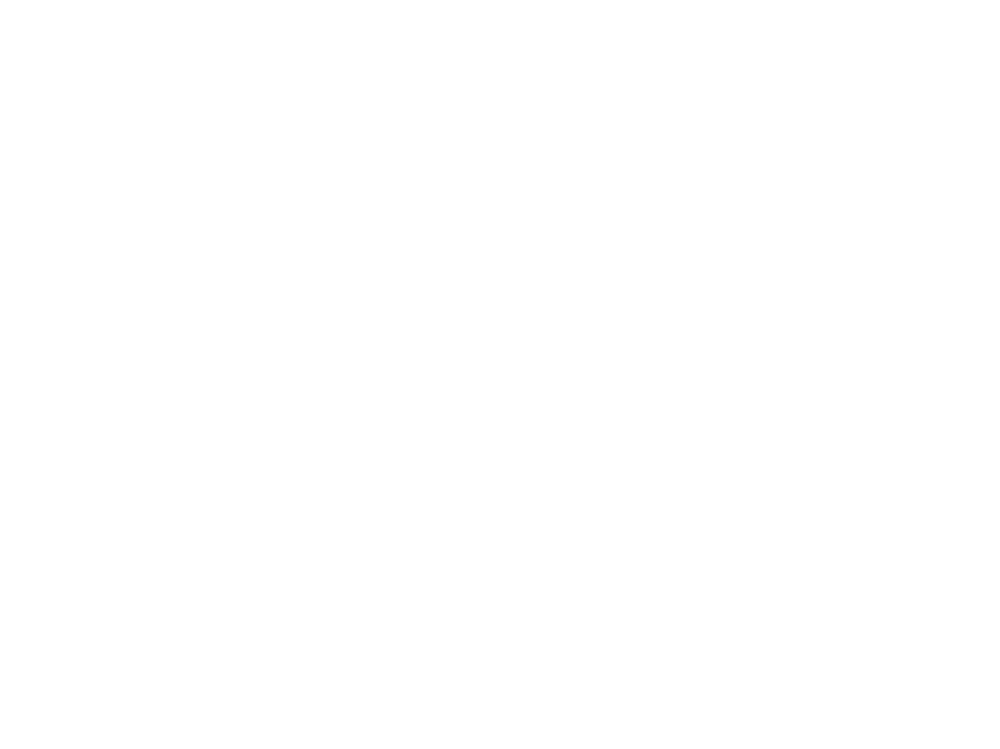

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=28.tif.


<IPython.core.display.Javascript object>


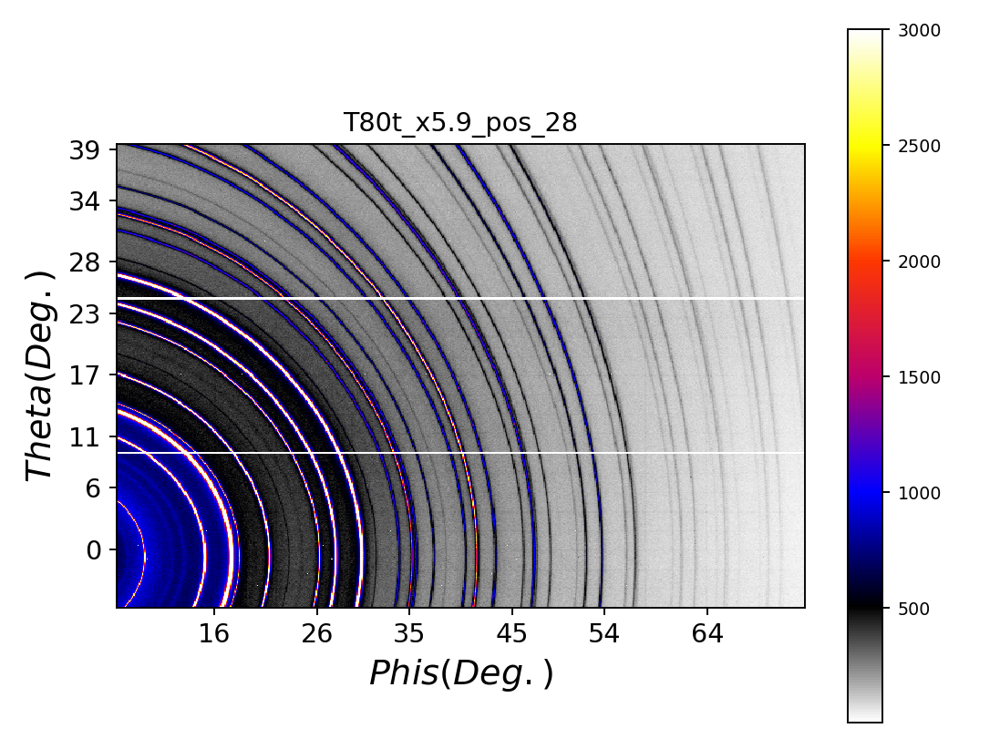

<IPython.core.display.Javascript object>


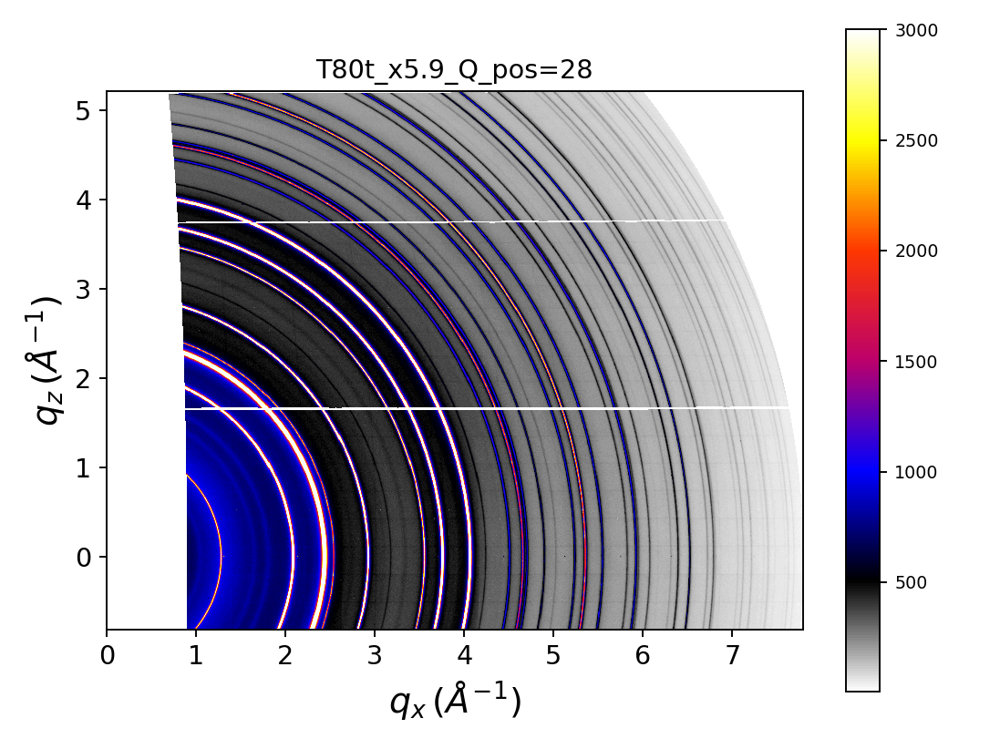

Stitching Pos: ...29
------> files to be stitched are: 
['T80t_x5.9_000309_WAXS.tif' 'T80t_x5.9_000310_WAXS.tif'
 'T80t_x5.9_000311_WAXS.tif' 'T80t_x5.9_000312_WAXS.tif'
 'T80t_x5.9_000313_WAXS.tif' 'T80t_x5.9_000314_WAXS.tif'
 'T80t_x5.9_000315_WAXS.tif' 'T80t_x5.9_000316_WAXS.tif'
 'T80t_x5.9_000317_WAXS.tif' 'T80t_x5.9_000318_WAXS.tif'
 'T80t_x5.9_000319_WAXS.tif'].


<IPython.core.display.Javascript object>


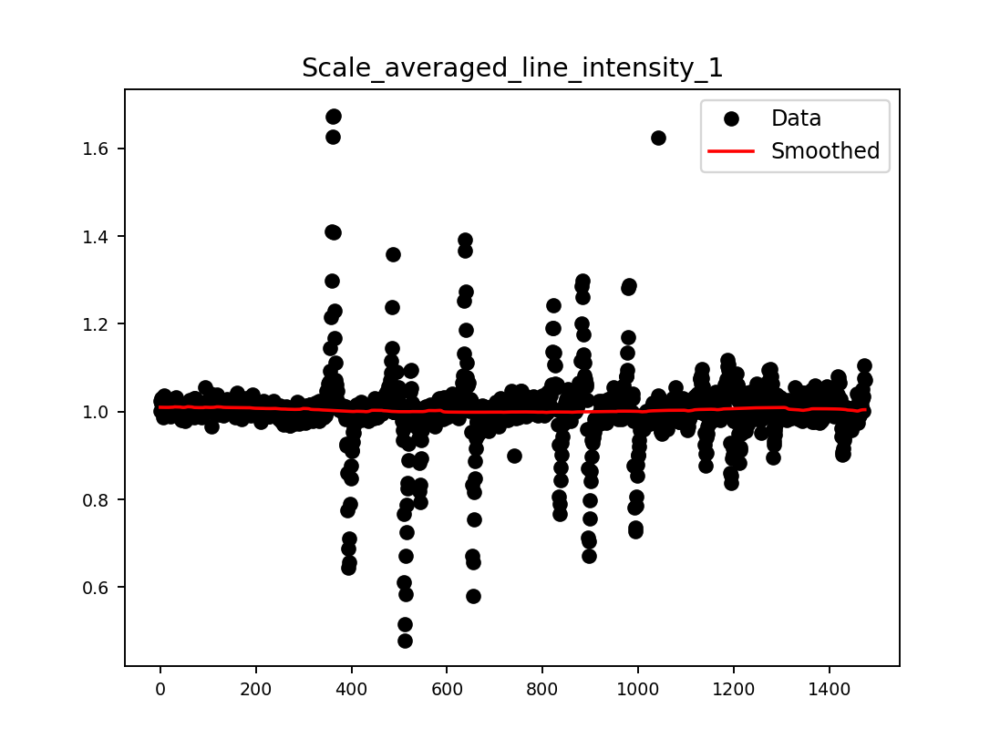

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=29.tif.


<IPython.core.display.Javascript object>


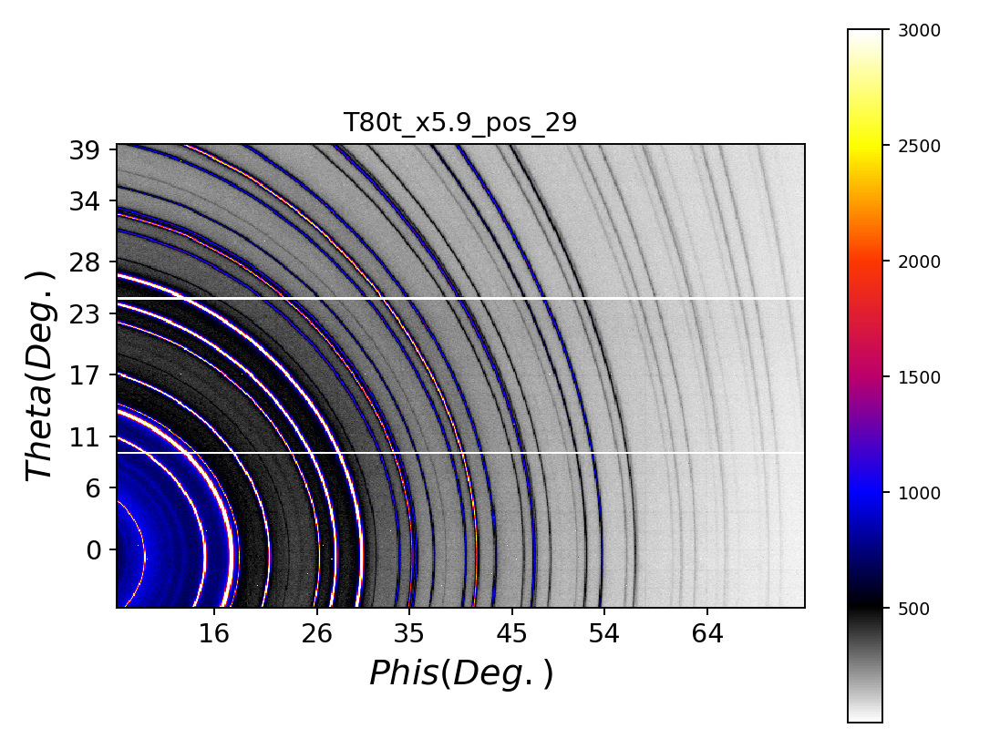

<IPython.core.display.Javascript object>


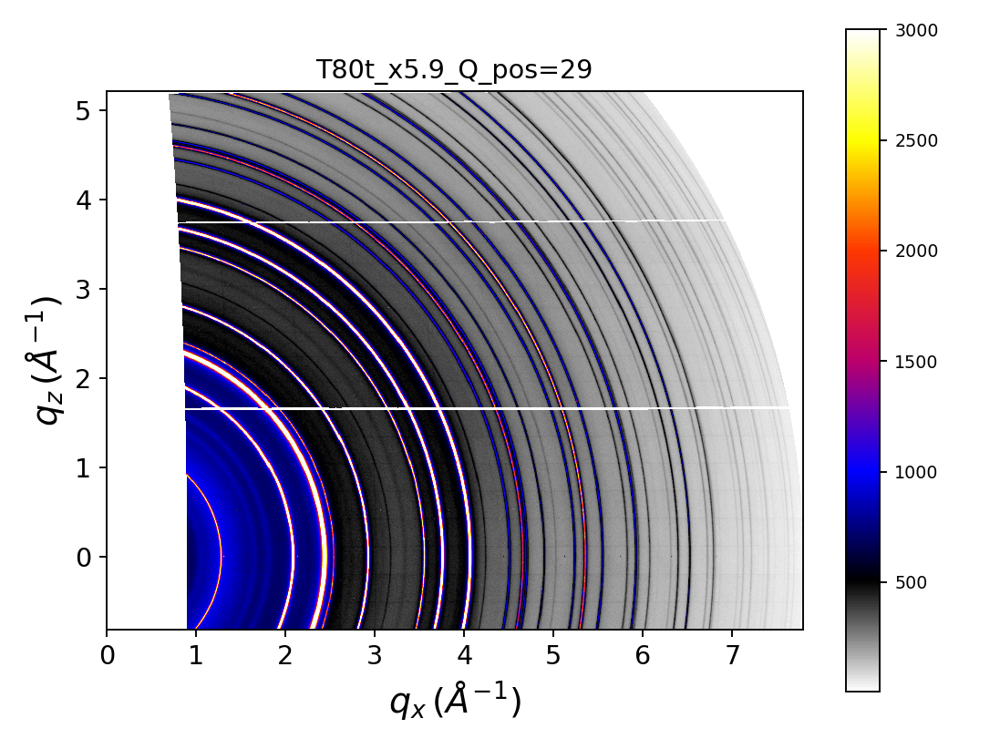

Stitching Pos: ...30
------> files to be stitched are: 
['T80t_x5.9_000330_WAXS.tif' 'T80t_x5.9_000329_WAXS.tif'
 'T80t_x5.9_000328_WAXS.tif' 'T80t_x5.9_000327_WAXS.tif'
 'T80t_x5.9_000326_WAXS.tif' 'T80t_x5.9_000325_WAXS.tif'
 'T80t_x5.9_000324_WAXS.tif' 'T80t_x5.9_000323_WAXS.tif'
 'T80t_x5.9_000322_WAXS.tif' 'T80t_x5.9_000321_WAXS.tif'
 'T80t_x5.9_000320_WAXS.tif'].


<IPython.core.display.Javascript object>


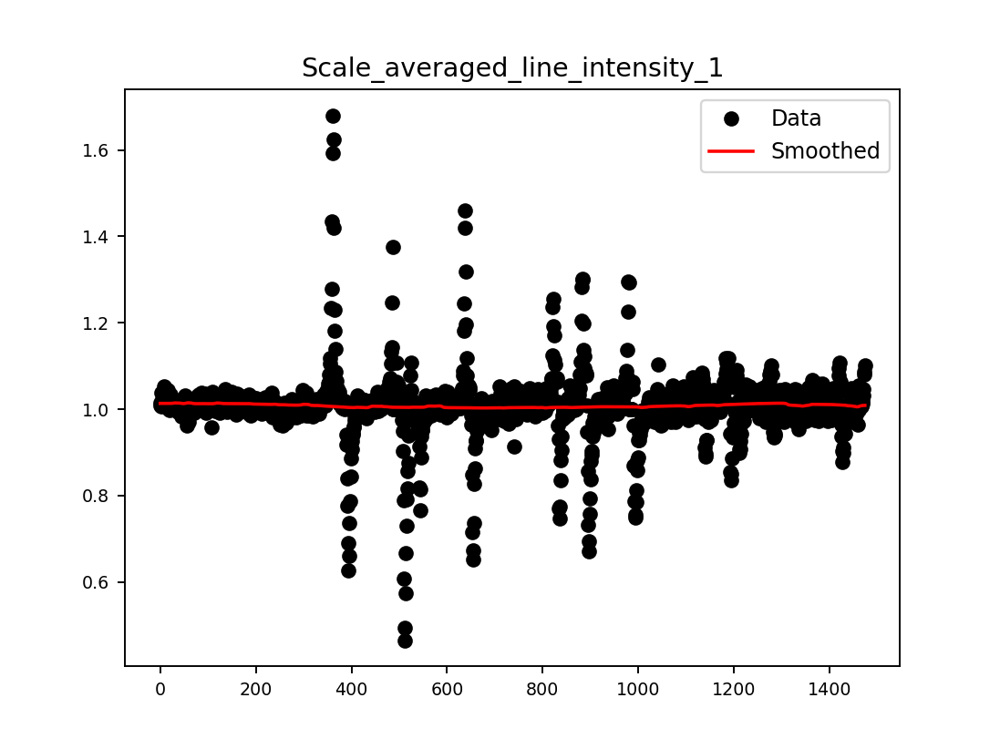

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=30.tif.


<IPython.core.display.Javascript object>


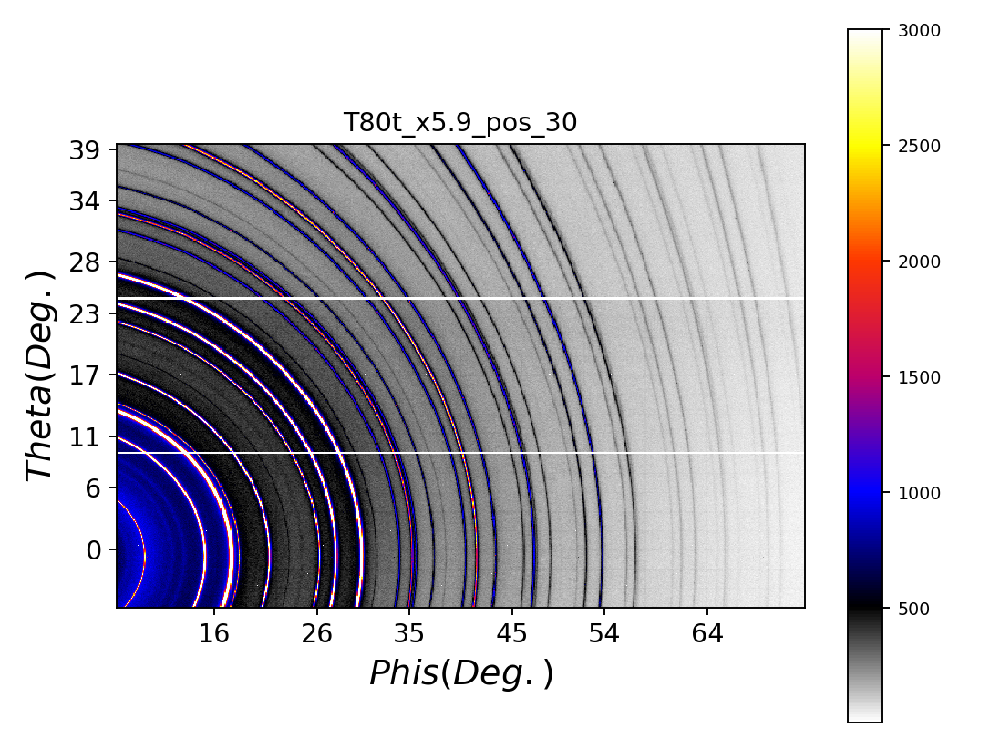

<IPython.core.display.Javascript object>


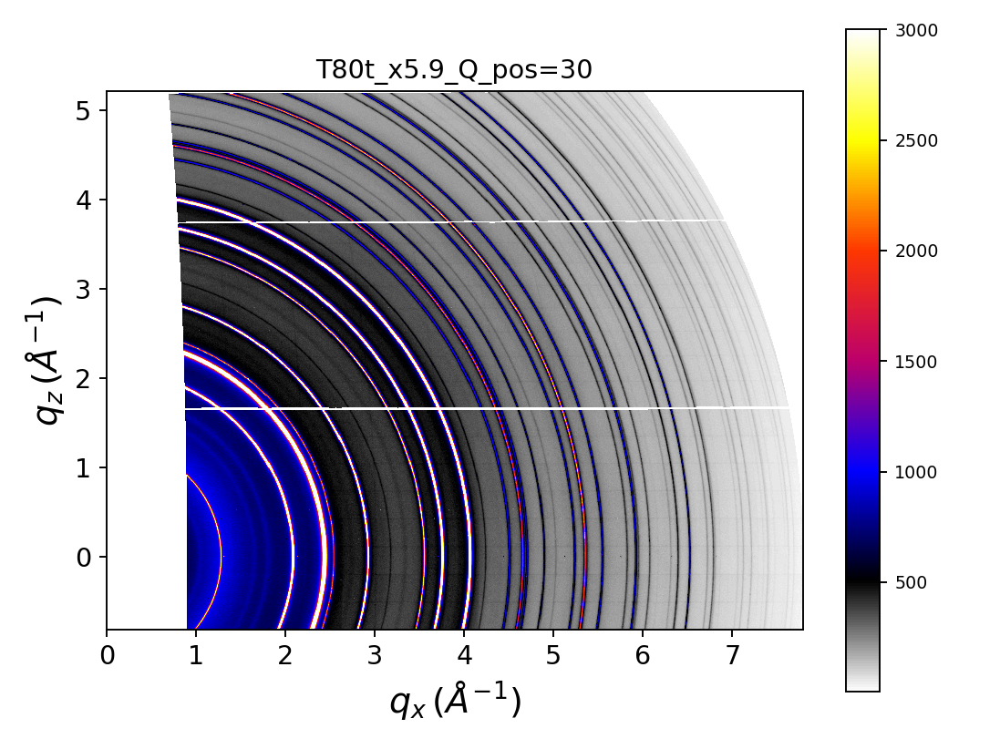

Stitching Pos: ...31
------> files to be stitched are: 
['T80t_x5.9_000331_WAXS.tif' 'T80t_x5.9_000332_WAXS.tif'
 'T80t_x5.9_000333_WAXS.tif' 'T80t_x5.9_000334_WAXS.tif'
 'T80t_x5.9_000335_WAXS.tif' 'T80t_x5.9_000336_WAXS.tif'
 'T80t_x5.9_000337_WAXS.tif' 'T80t_x5.9_000338_WAXS.tif'
 'T80t_x5.9_000339_WAXS.tif' 'T80t_x5.9_000340_WAXS.tif'
 'T80t_x5.9_000341_WAXS.tif'].


<IPython.core.display.Javascript object>


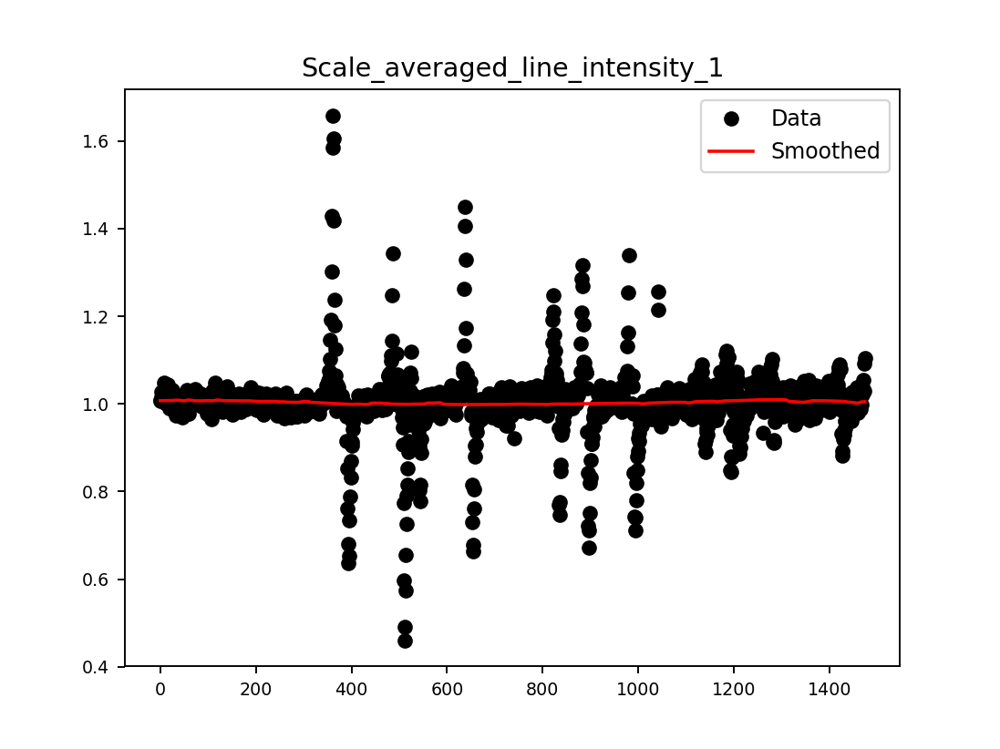

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=31.tif.


<IPython.core.display.Javascript object>


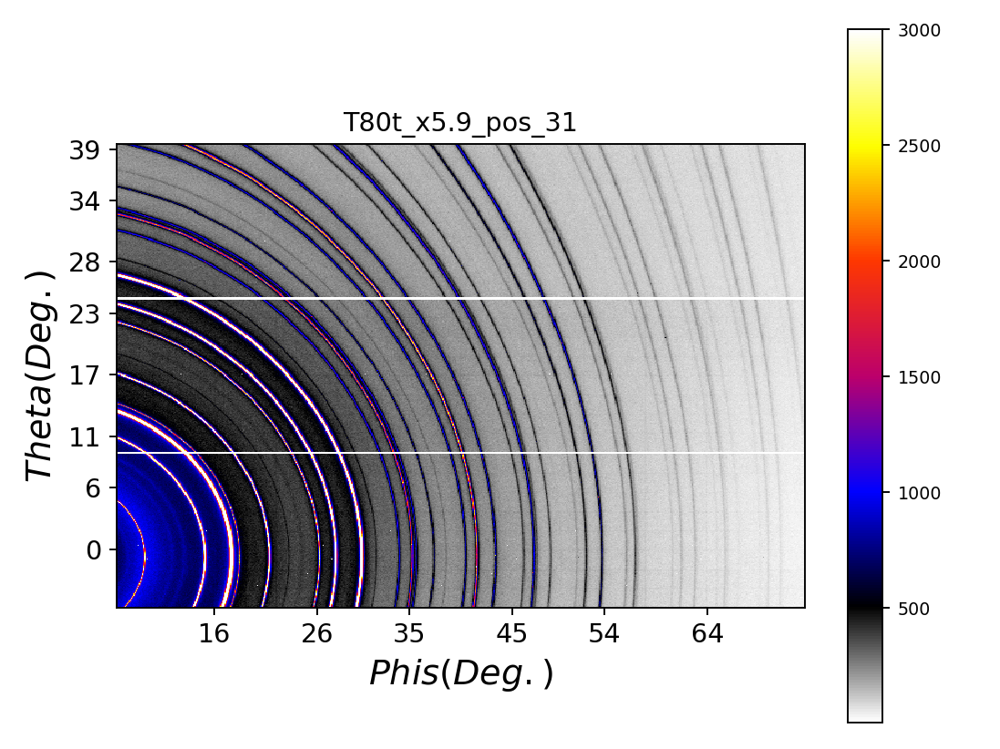

<IPython.core.display.Javascript object>


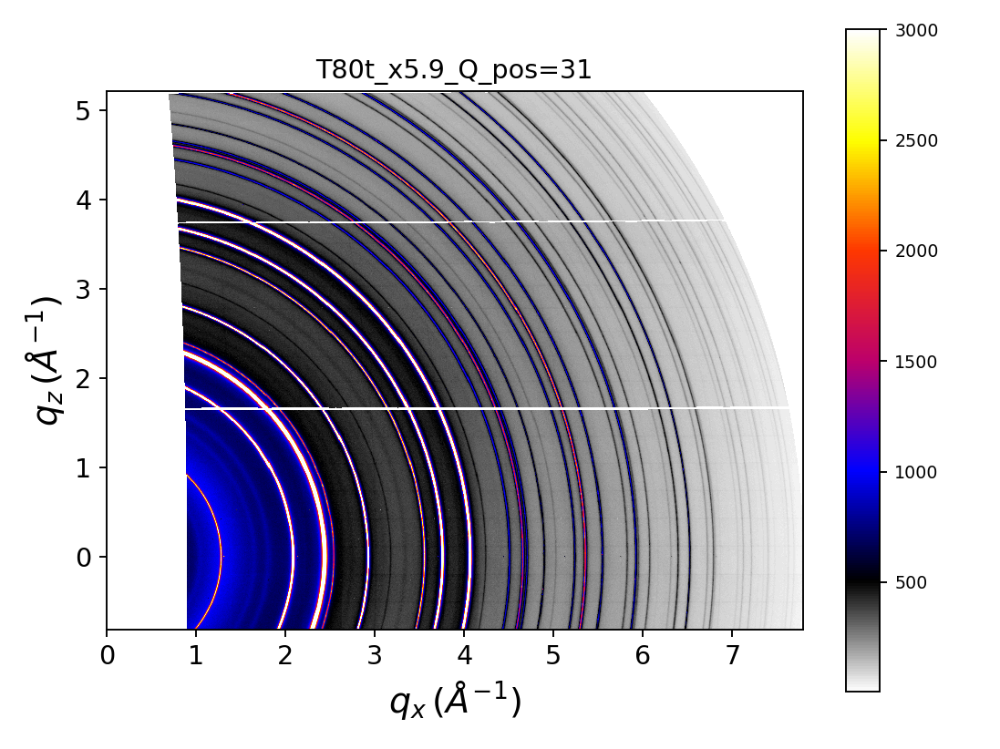

Stitching Pos: ...32
------> files to be stitched are: 
['T80t_x5.9_000352_WAXS.tif' 'T80t_x5.9_000351_WAXS.tif'
 'T80t_x5.9_000350_WAXS.tif' 'T80t_x5.9_000349_WAXS.tif'
 'T80t_x5.9_000348_WAXS.tif' 'T80t_x5.9_000347_WAXS.tif'
 'T80t_x5.9_000346_WAXS.tif' 'T80t_x5.9_000345_WAXS.tif'
 'T80t_x5.9_000344_WAXS.tif' 'T80t_x5.9_000343_WAXS.tif'
 'T80t_x5.9_000342_WAXS.tif'].


<IPython.core.display.Javascript object>


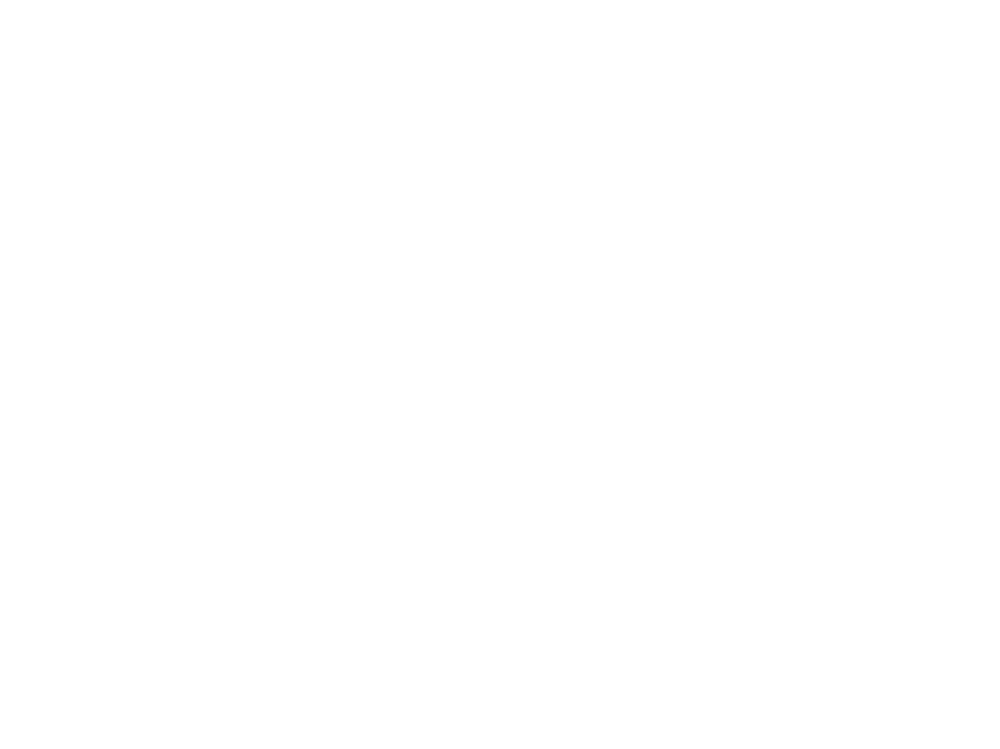

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=32.tif.


<IPython.core.display.Javascript object>


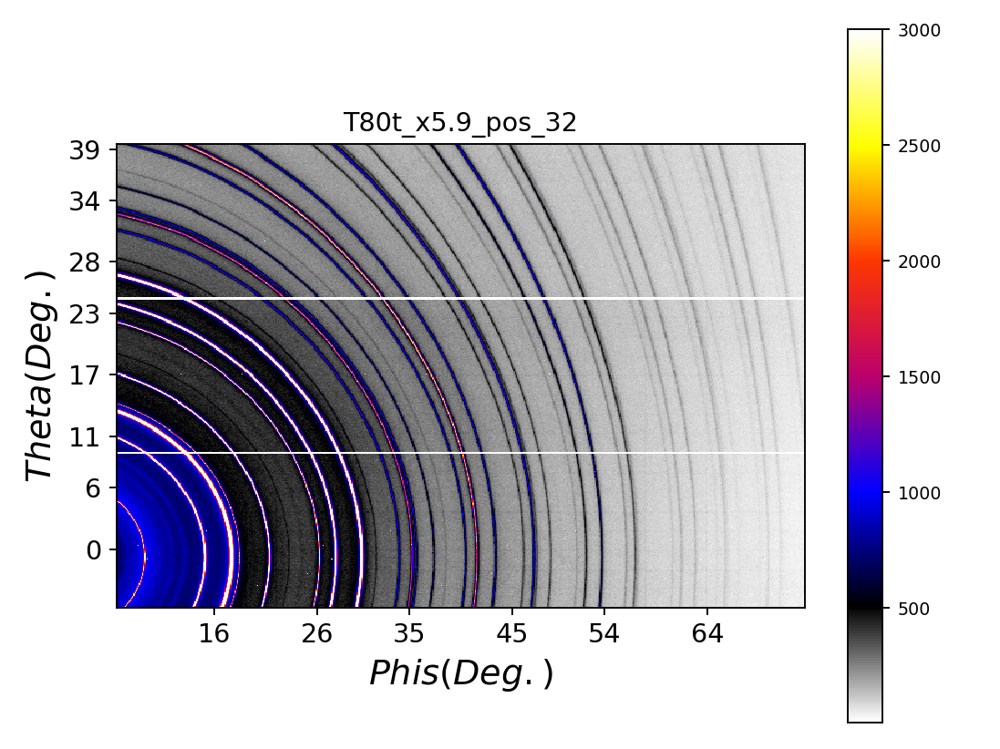

<IPython.core.display.Javascript object>


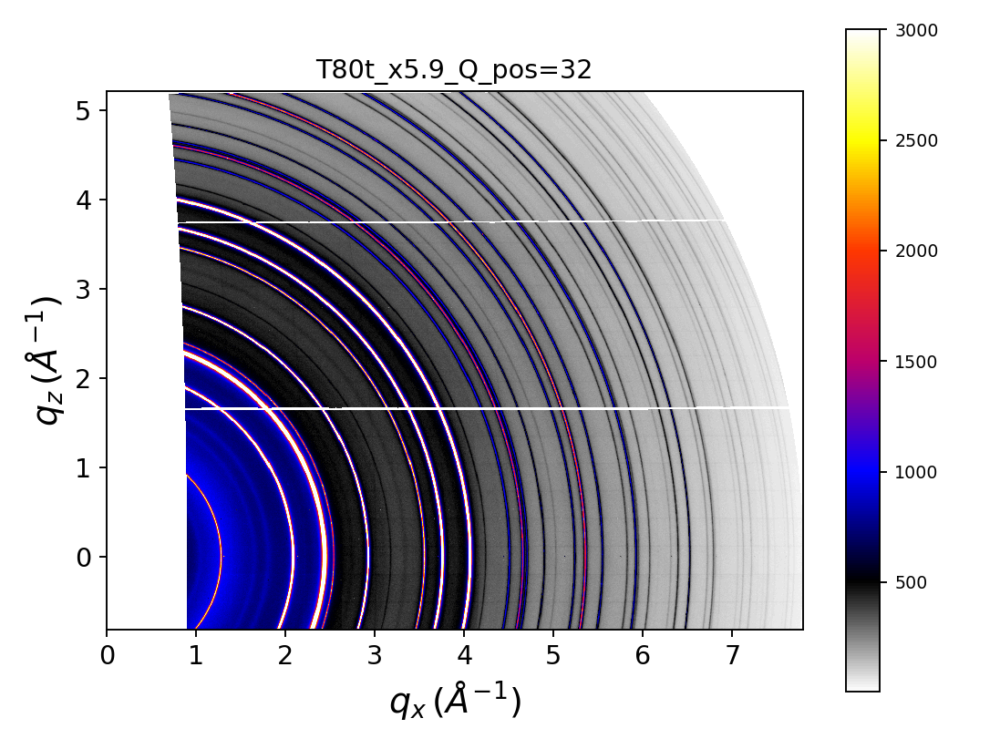

Stitching Pos: ...33
------> files to be stitched are: 
['T80t_x5.9_000353_WAXS.tif' 'T80t_x5.9_000354_WAXS.tif'
 'T80t_x5.9_000355_WAXS.tif' 'T80t_x5.9_000356_WAXS.tif'
 'T80t_x5.9_000357_WAXS.tif' 'T80t_x5.9_000358_WAXS.tif'
 'T80t_x5.9_000359_WAXS.tif' 'T80t_x5.9_000360_WAXS.tif'
 'T80t_x5.9_000361_WAXS.tif' 'T80t_x5.9_000362_WAXS.tif'
 'T80t_x5.9_000363_WAXS.tif'].


<IPython.core.display.Javascript object>


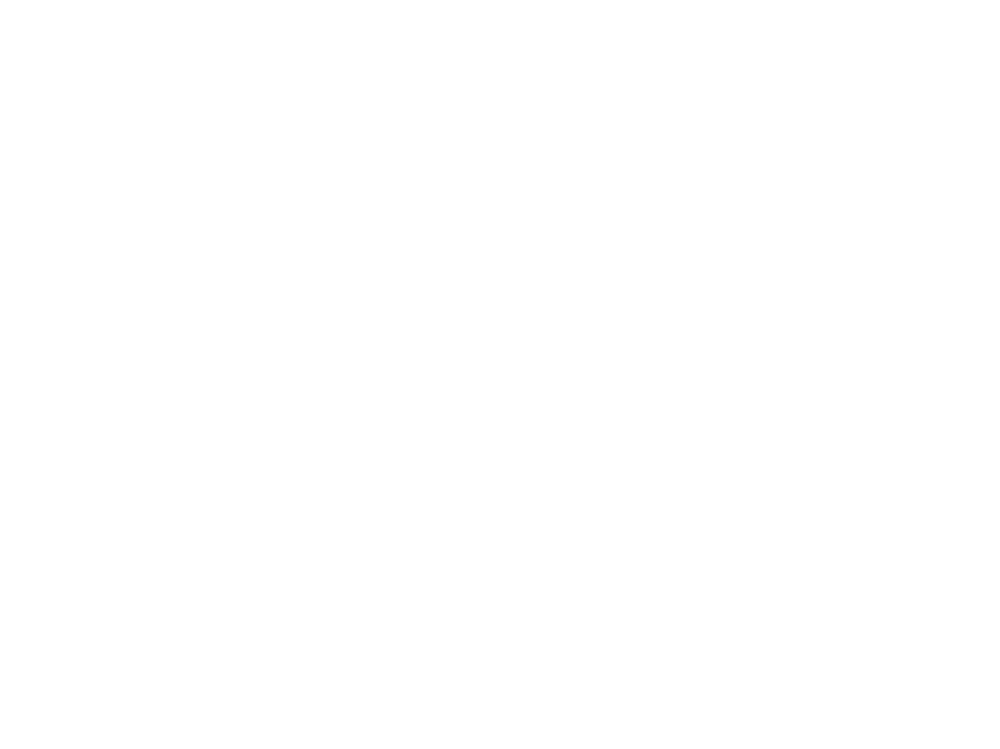

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=33.tif.


<IPython.core.display.Javascript object>


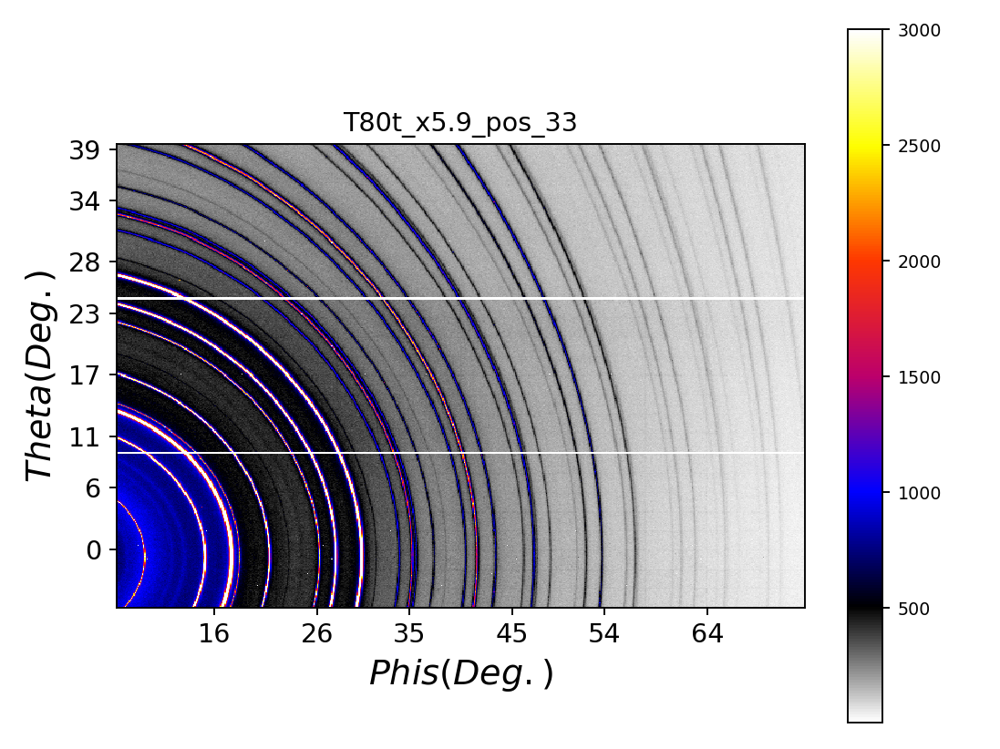

<IPython.core.display.Javascript object>


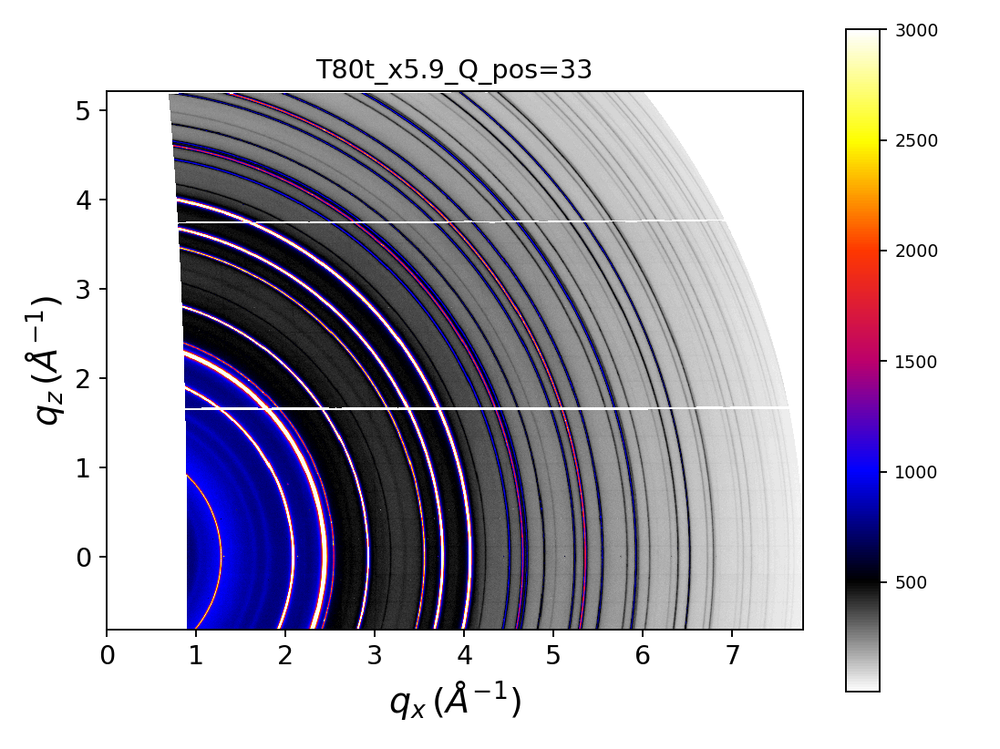

Stitching Pos: ...34
------> files to be stitched are: 
['T80t_x5.9_000374_WAXS.tif' 'T80t_x5.9_000373_WAXS.tif'
 'T80t_x5.9_000372_WAXS.tif' 'T80t_x5.9_000371_WAXS.tif'
 'T80t_x5.9_000370_WAXS.tif' 'T80t_x5.9_000369_WAXS.tif'
 'T80t_x5.9_000368_WAXS.tif' 'T80t_x5.9_000367_WAXS.tif'
 'T80t_x5.9_000366_WAXS.tif' 'T80t_x5.9_000365_WAXS.tif'
 'T80t_x5.9_000364_WAXS.tif'].


<IPython.core.display.Javascript object>


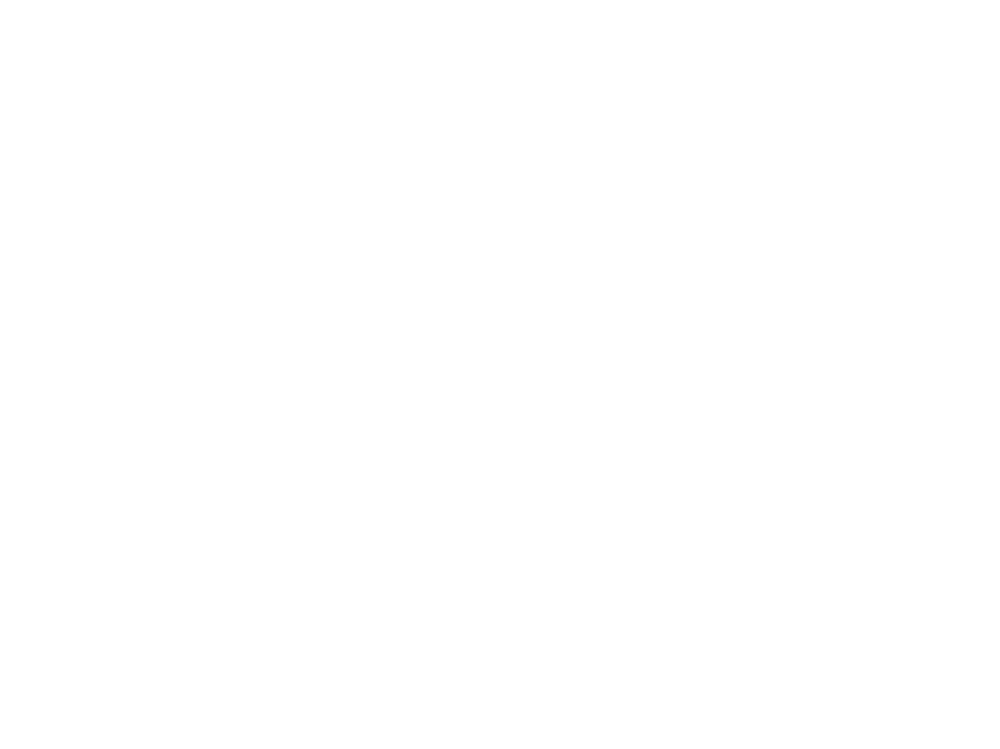

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=34.tif.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


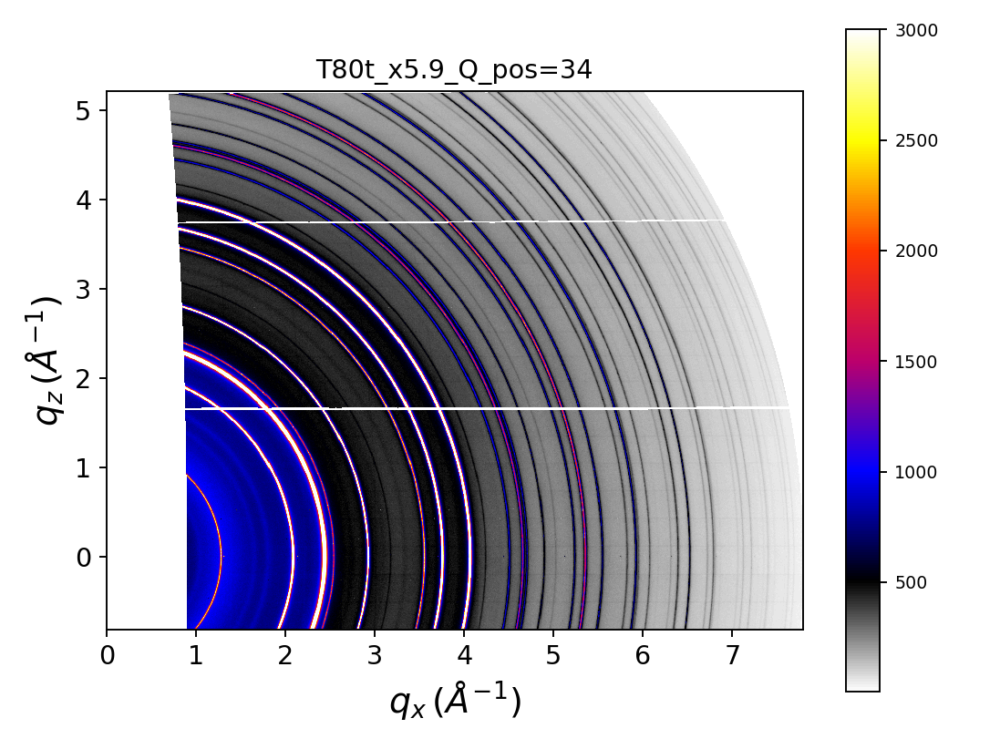

Stitching Pos: ...35
------> files to be stitched are: 
['T80t_x5.9_000375_WAXS.tif' 'T80t_x5.9_000376_WAXS.tif'
 'T80t_x5.9_000377_WAXS.tif' 'T80t_x5.9_000378_WAXS.tif'
 'T80t_x5.9_000379_WAXS.tif' 'T80t_x5.9_000380_WAXS.tif'
 'T80t_x5.9_000381_WAXS.tif' 'T80t_x5.9_000382_WAXS.tif'
 'T80t_x5.9_000383_WAXS.tif' 'T80t_x5.9_000384_WAXS.tif'
 'T80t_x5.9_000385_WAXS.tif'].


<IPython.core.display.Javascript object>


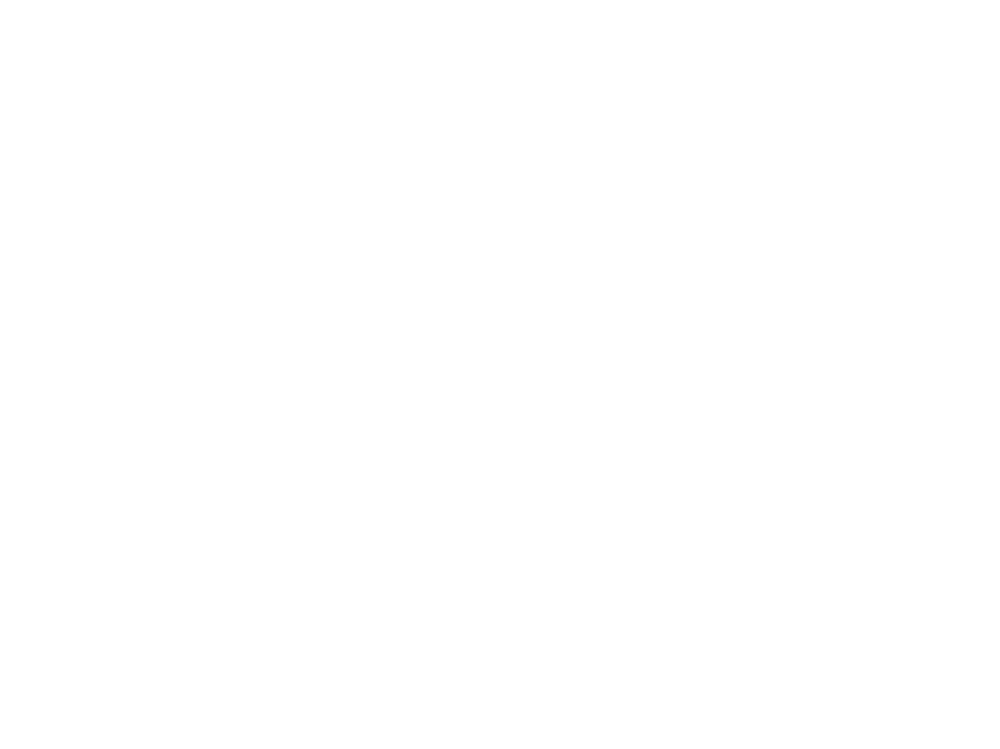

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=35.tif.


<IPython.core.display.Javascript object>


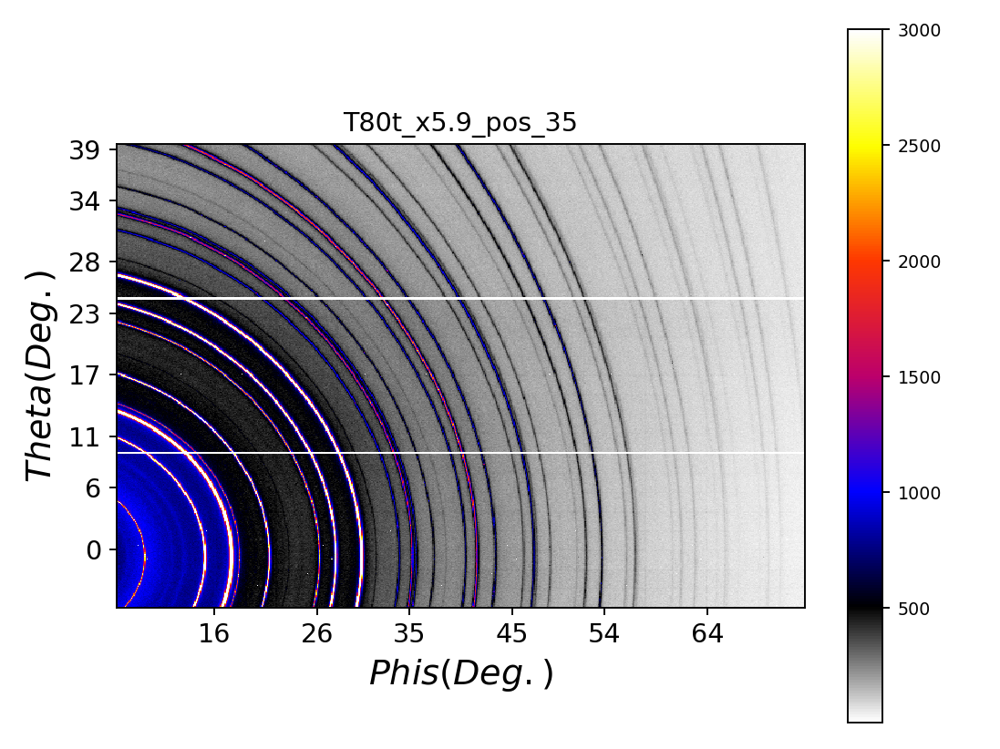

<IPython.core.display.Javascript object>


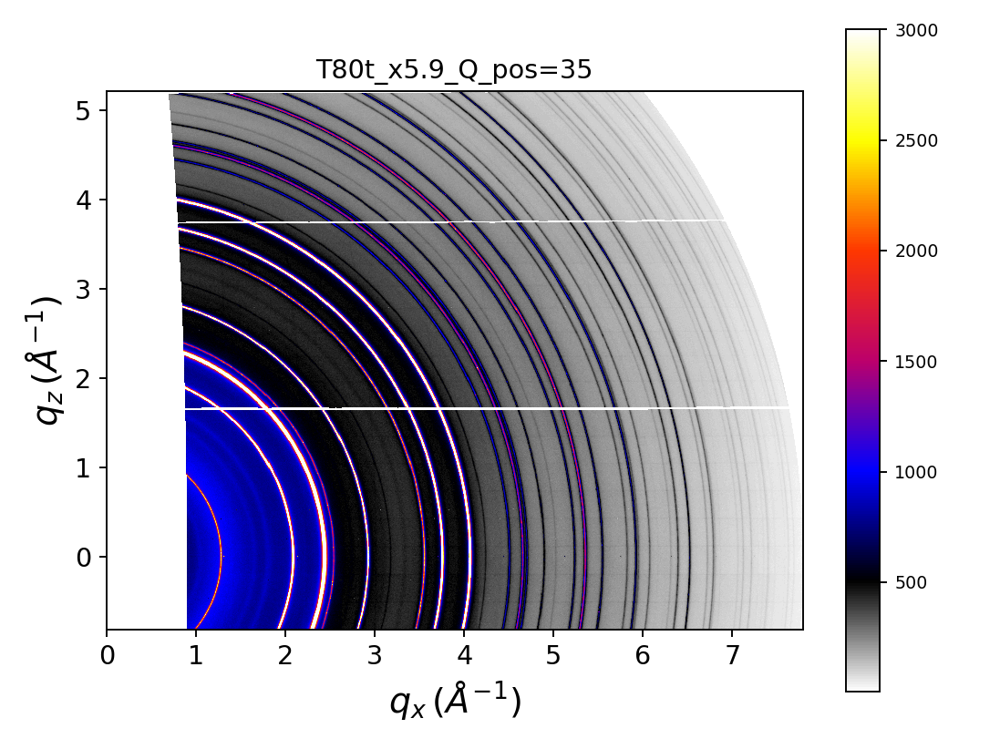

Stitching Pos: ...36
------> files to be stitched are: 
['T80t_x5.9_000396_WAXS.tif' 'T80t_x5.9_000395_WAXS.tif'
 'T80t_x5.9_000394_WAXS.tif' 'T80t_x5.9_000393_WAXS.tif'
 'T80t_x5.9_000392_WAXS.tif' 'T80t_x5.9_000391_WAXS.tif'
 'T80t_x5.9_000390_WAXS.tif' 'T80t_x5.9_000389_WAXS.tif'
 'T80t_x5.9_000388_WAXS.tif' 'T80t_x5.9_000387_WAXS.tif'
 'T80t_x5.9_000386_WAXS.tif'].


<IPython.core.display.Javascript object>


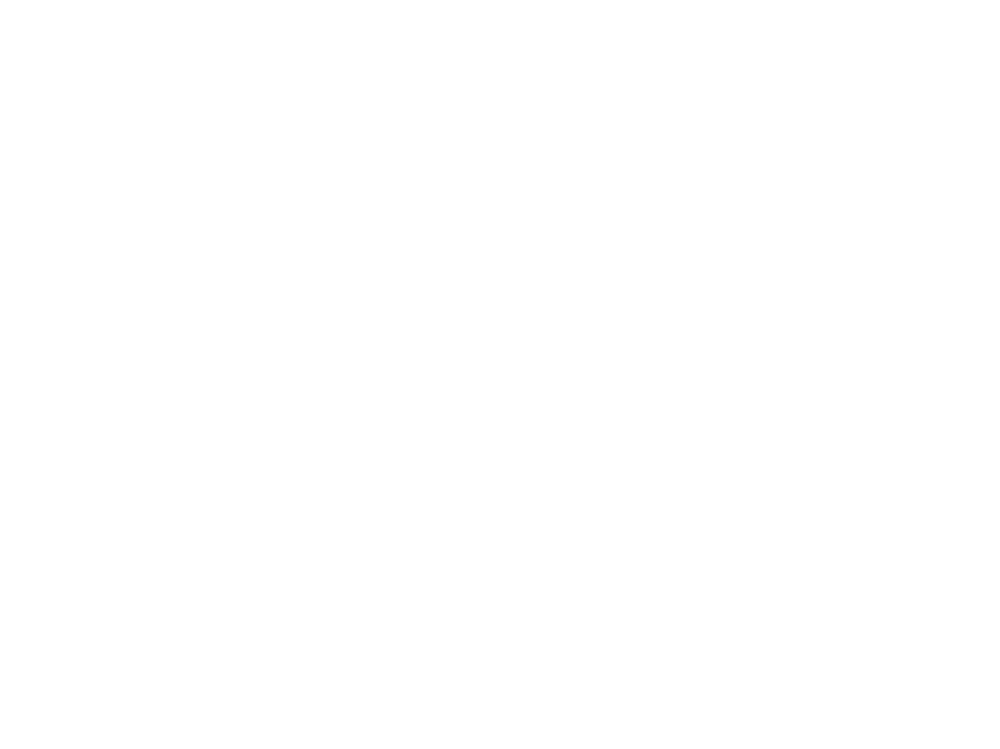

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=36.tif.


<IPython.core.display.Javascript object>


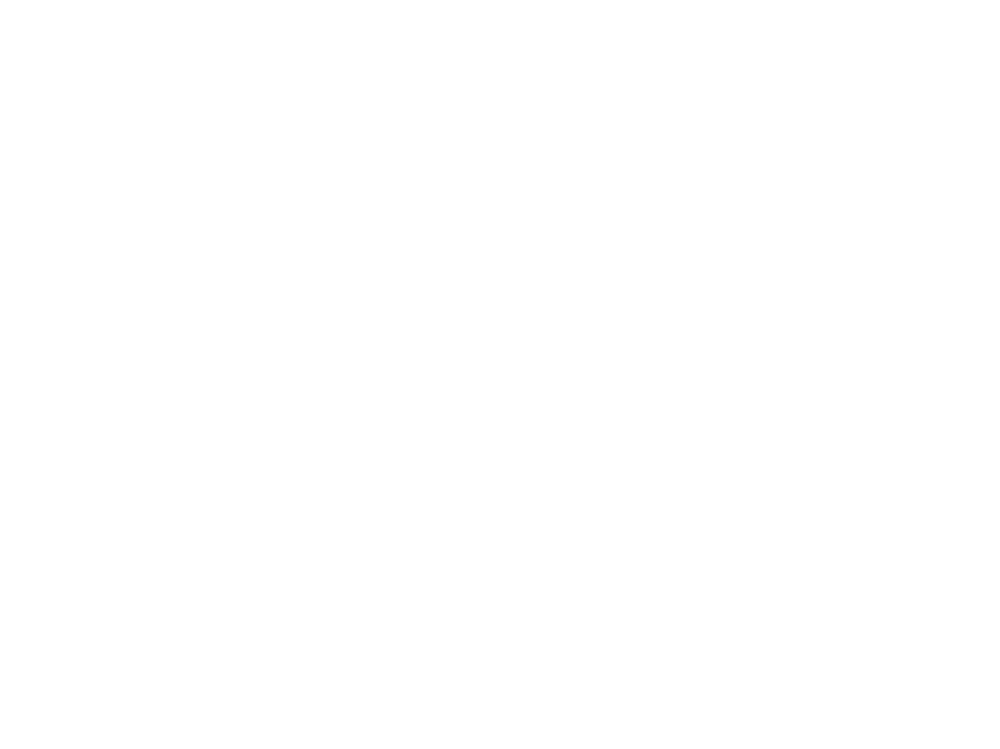

<IPython.core.display.Javascript object>


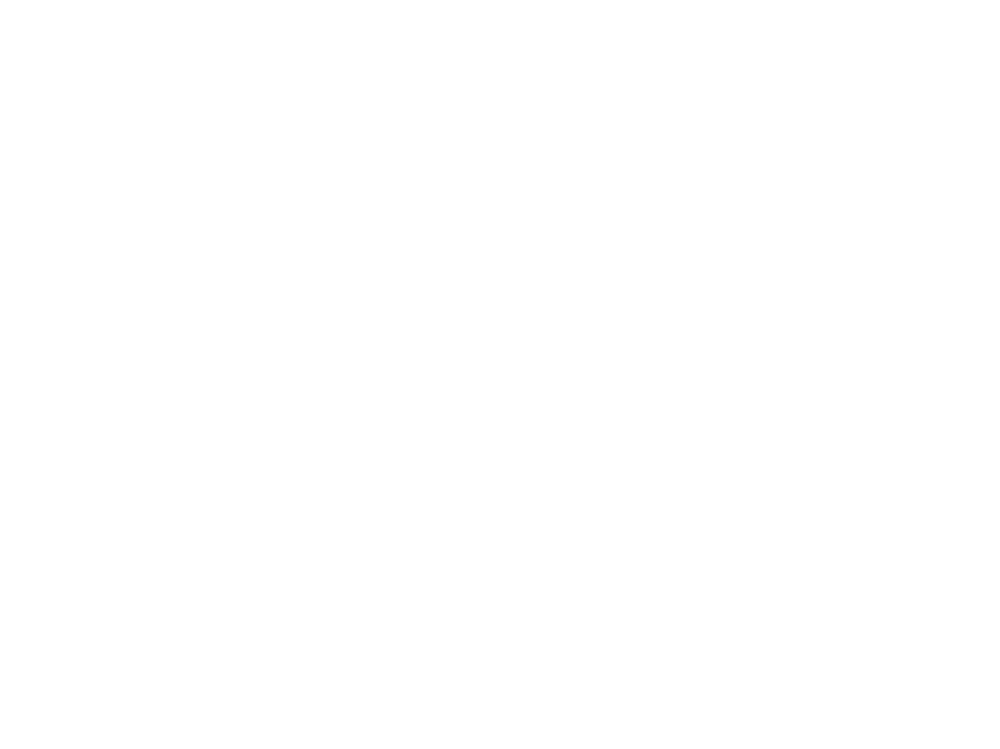

Stitching Pos: ...37
------> files to be stitched are: 
['T80t_x5.9_000397_WAXS.tif' 'T80t_x5.9_000398_WAXS.tif'
 'T80t_x5.9_000399_WAXS.tif' 'T80t_x5.9_000400_WAXS.tif'
 'T80t_x5.9_000401_WAXS.tif' 'T80t_x5.9_000402_WAXS.tif'
 'T80t_x5.9_000403_WAXS.tif' 'T80t_x5.9_000404_WAXS.tif'
 'T80t_x5.9_000405_WAXS.tif' 'T80t_x5.9_000406_WAXS.tif'
 'T80t_x5.9_000407_WAXS.tif'].


<IPython.core.display.Javascript object>


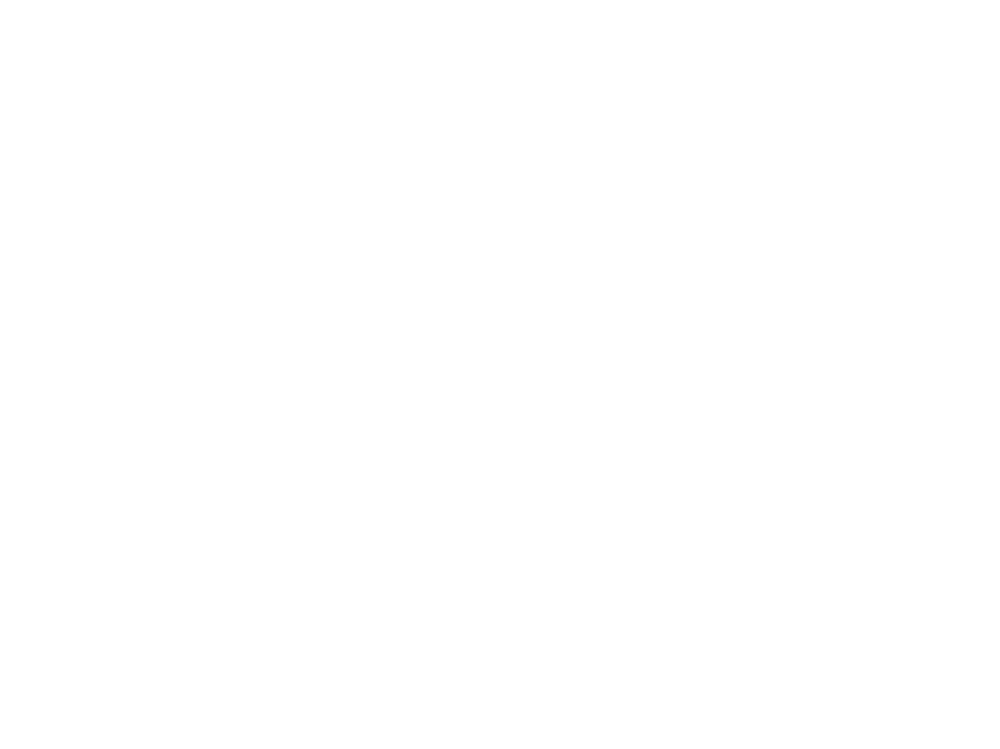

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=37.tif.


<IPython.core.display.Javascript object>


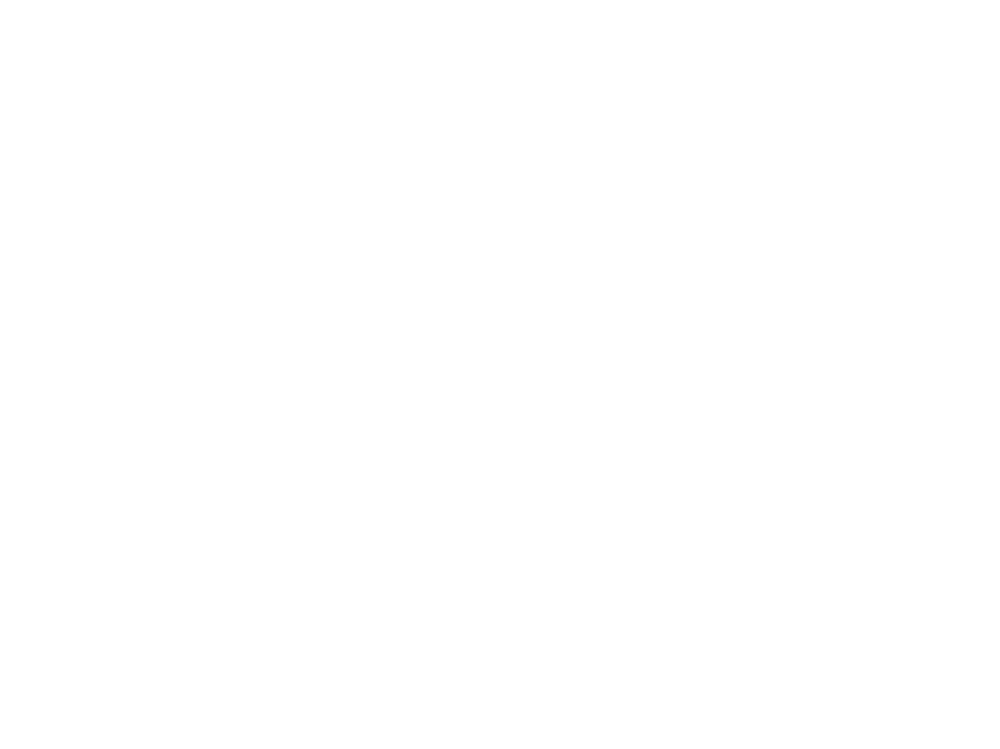

<IPython.core.display.Javascript object>


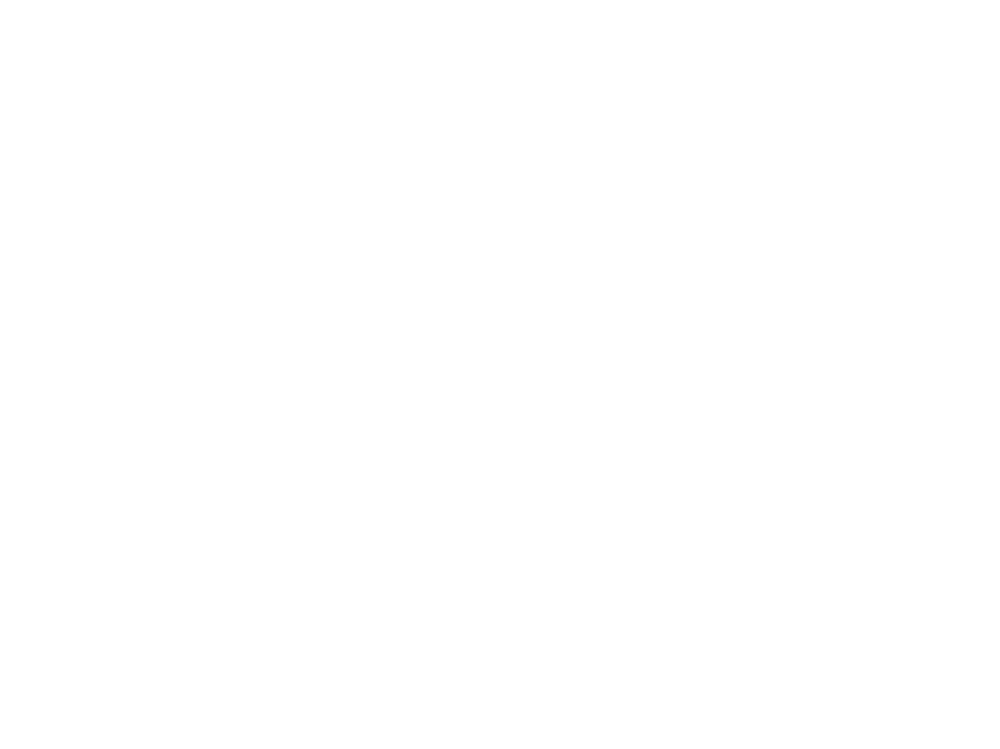

Stitching Pos: ...38
------> files to be stitched are: 
['T80t_x5.9_000418_WAXS.tif' 'T80t_x5.9_000417_WAXS.tif'
 'T80t_x5.9_000416_WAXS.tif' 'T80t_x5.9_000415_WAXS.tif'
 'T80t_x5.9_000414_WAXS.tif' 'T80t_x5.9_000413_WAXS.tif'
 'T80t_x5.9_000412_WAXS.tif' 'T80t_x5.9_000411_WAXS.tif'
 'T80t_x5.9_000410_WAXS.tif' 'T80t_x5.9_000409_WAXS.tif'
 'T80t_x5.9_000408_WAXS.tif'].


<IPython.core.display.Javascript object>


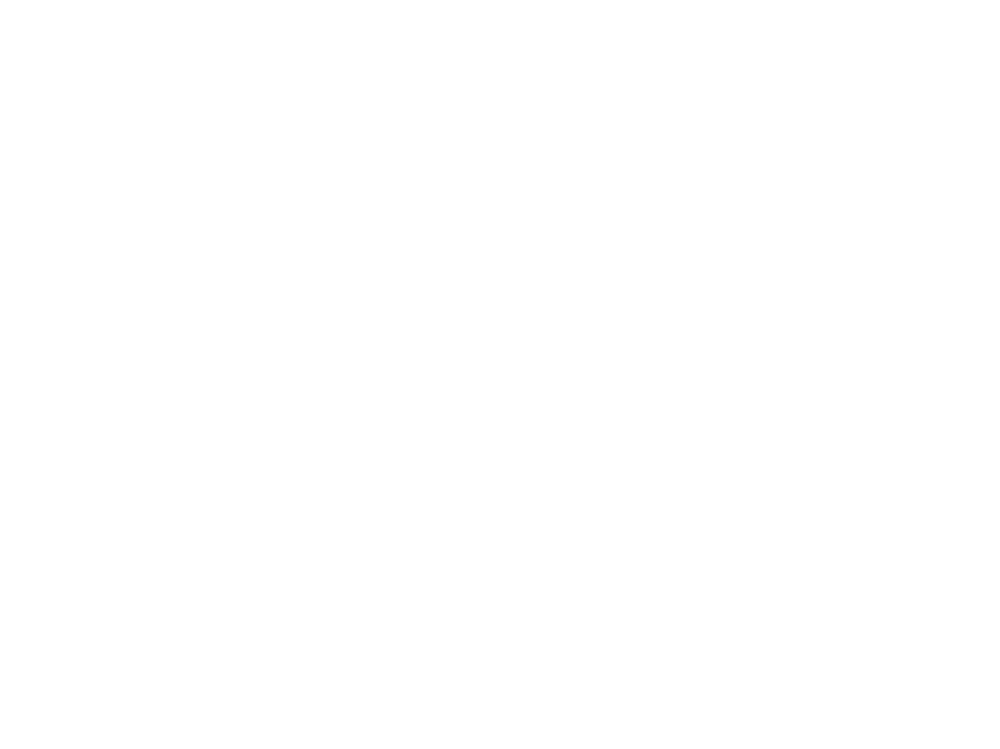

The data is save to: /GPFS/xf12id1/analysis/2018_1/302771a/Results/Steven/T80t_x5.9_/T80t_x5.9_Qmap_pos=38.tif.


<IPython.core.display.Javascript object>


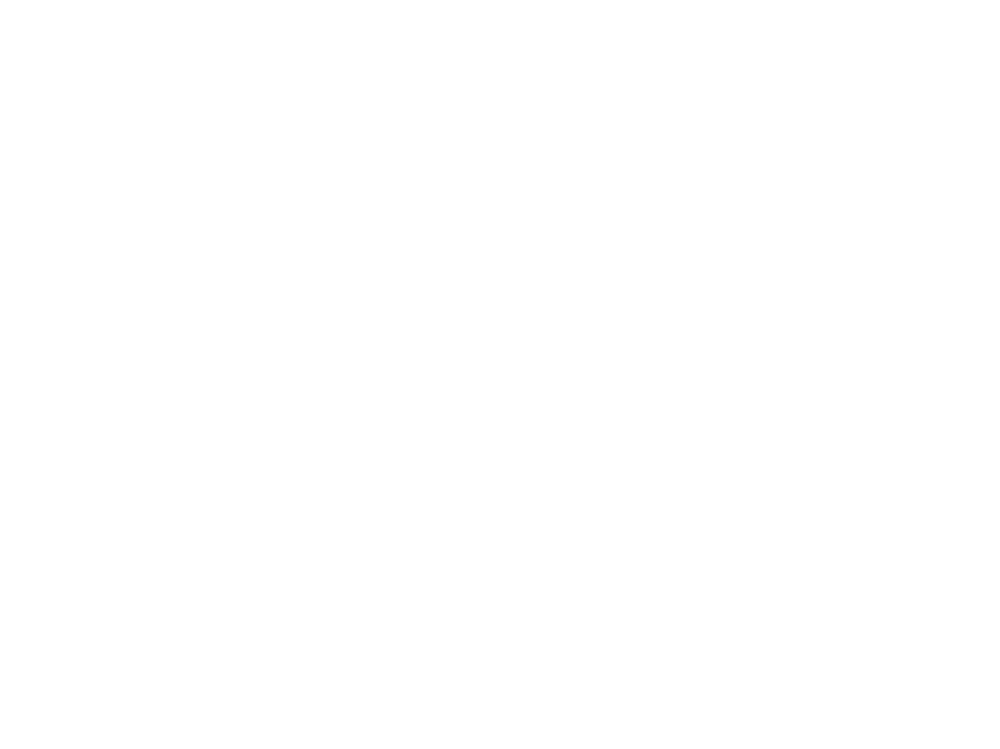

<IPython.core.display.Javascript object>


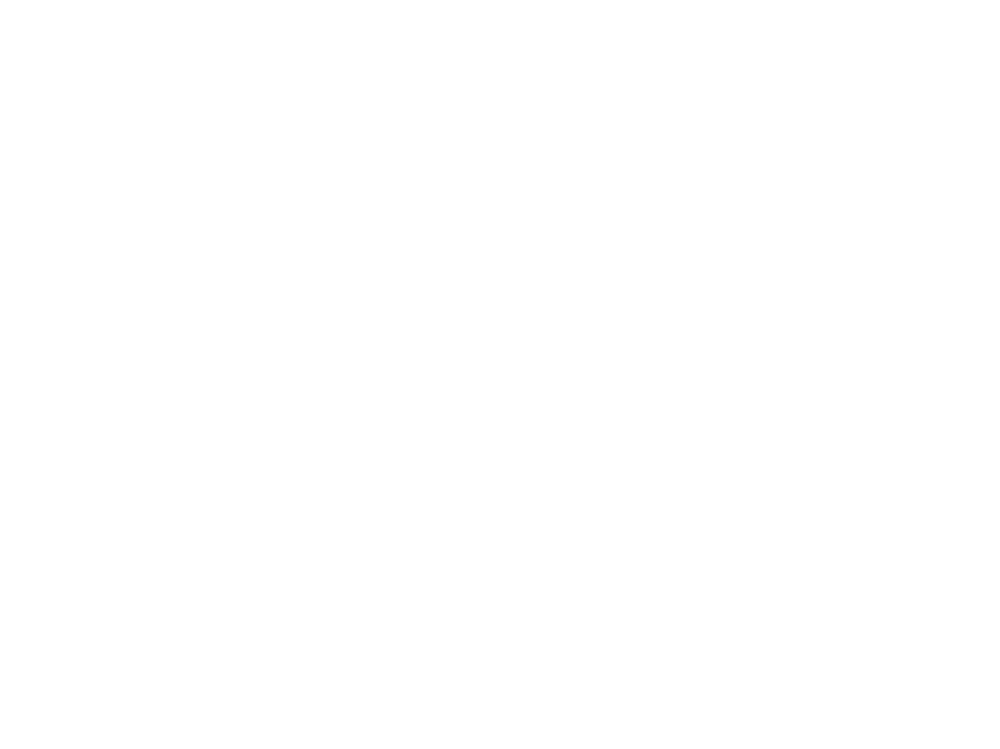

In [74]:
Nstart  = 1# starting point of the stitiching
Nend  =   38# ending point of the stitiching
#there will be a bad point due to beam dump, bad filename from ..to T80t_x5.9_000435_WAXS.tif




ResDir = os.path.join( ResDir0, k +'/' )
os.makedirs(ResDir, exist_ok=True)
print('Results from this analysis will be stashed in the directory %s' % ResDir)

#start_angle = 4.0
#phi_spacing = 6.0

Ni = 11 # number of frames to stitching
vmin= 5
vmax= 3e3
    
w= 1901
p= 5
    
infiles = sorted( fp[sam] )
for pos in range( Nstart, Nend, 1 ):
    print("Stitching Pos: ...%s"%(pos+1))   
    if pos%2:
        fsub = infiles[pos*Ni : (pos+1)* Ni ][::-1]
    else:
        fsub = infiles[pos*Ni : (pos+1)* Ni ] 
  
    #print("------> filename is ranging from %06d to %06d."%( pos*Ni, (pos+1)* Ni -1  ))
    fsubs = np.array( [ np.array( fsub )[i].split('/')[-1] for i in range(len(fsub)) ]   )
    print("------> files to be stitched are: \n%s."%( fsubs ))
    #print( fsub)
    if pos ==0:   
        phis = -start_angle - np.arange(0, Ni) * phi_spacing 
        print('The rotated angles are: %s.'%phis)


    data, dataM, scale,scale_smooth = Correct_Overlap_Images_Intensities( fsub, window_length=w, polyorder=p, 
                                   overlap_width= 29, badpixel_width = 10  )
    check_overlap_scaling_factor( scale,scale_smooth, i=1, filename = ResDir + k + 'smoothed_one_line_1.png', save= False )

    angzs, angze, angxs, angxe = [
        np.degrees( np.arctan2 ( (beam_y-data.shape[0]) * 172/1e6, sam_det ) ), 
        np.degrees( np.arctan2 ( ( beam_y ) * 172/1e6, sam_det ) ),
        abs(phis[0]) - 3.5, 
        abs(phis[ len(phis)-1]) + 3.5     ] 


    ytick = np.round( np.linspace(angzs, angze, 9 ), 0 )
    xtick = np.round( np.linspace(angxs, angxe, 8 ), 0 )
    axs =  np.linspace(angxs, angxe, data.shape[1] )
    azs =  np.linspace(angzs, angze, data.shape[0] )        

    qdata, xs, zs = stitch_WAXS_in_Qspace( dataM, phis, calibration, x='Qx',
                              dx= 0, dy = 22, dz = 0,  dq= dq, mask=mask.data.T )

    save_array_to_tiff(  qdata, ResDir + k + 'Qmap_pos=%s.tif'% (pos +1)  )
    np.savetxt(  ResDir + k + 'Qmap_qx_cor_pos=%s.txt'%pos,  xs )
    np.savetxt(  ResDir + k + 'Qmap_qz_cor_pos=%s.txt'%pos,  zs )

    #show angle space
    
    fig,ax=plt.subplots()
    show_img(data, logs = False,  ax=[fig,ax],  vmin=  vmin, vmax= vmax,
             xlabel='$Phis (Deg.)$',  ylabel='$Theta (Deg.)$', 
             cmap = cmap_vge_hdr,  extent=[angxs, angxe, angzs, angze], aspect=1,  
             image_name = k+ 'pos_%s'%(pos+1), dpi=500, save=False, path=ResDir)
    ax.set_yticks( ytick )
    ax.set_xticks( xtick )
    fig.savefig( ResDir +  k+ 'Angle_pos=%s.png'%(pos+1) )

    #show Q space
    
    show_img(qdata, logs = False,  vmin=  vmin, vmax= vmax,
         extent=[xs[0], xs[-1], zs[0],zs[-1]], xlabel='$q_x \, (\AA^{-1})$',  ylabel='$q_z \, (\AA^{-1})$', 
         cmap = cmap_vge_hdr,   aspect=1,  image_name = k + 'Q_pos=%s'%(pos+1), dpi=500, save=True, path=ResDir)




            
    #print( fsub )

